In [1]:
import matplotlib.pyplot as plt
import scipy as sp
from scipy.io import loadmat
import numpy as np
import time
from skimage.transform import rescale, resize, downscale_local_mean
from skimage import data

import sys
sys.path.append("../../LocalGraphClustering/")
sys.path.append("../../LocalGraphClustering/notebooks/")

from localgraphclustering import *

import matplotlib.patches as patches
from affinity_kimon import affinity
from skimage.color import rgb2gray
from skimage import data, segmentation, color
from sklearn.metrics import pairwise_distances
from sklearn.cluster import AgglomerativeClustering
from skimage.future import graph
from skimage.segmentation import mark_boundaries
from skimage.io import imread
from skimage import data
from skimage.segmentation import active_contour,find_boundaries,random_walker

from sklearn.metrics import f1_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score

import networkx as nx
from collections import Counter

import warnings
warnings.filterwarnings('ignore')

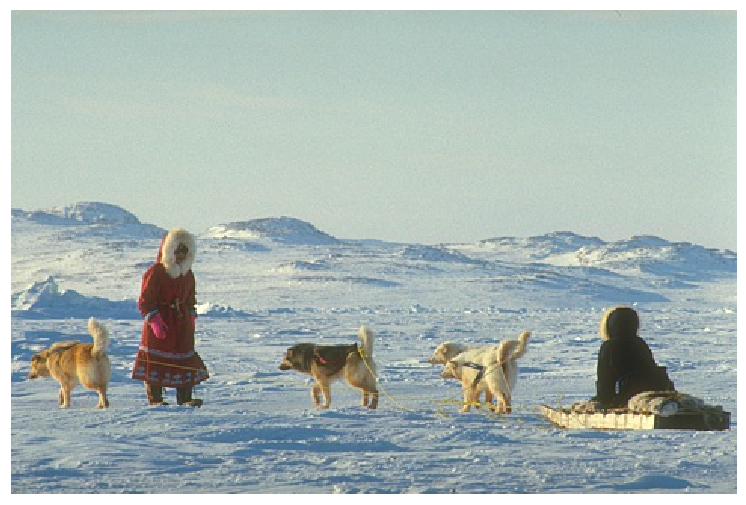

In [2]:
# Set paths
root_dir = '/homes/liu1740/Research/LocalGraphClustering/notebooks/datasets/BSR/BSDS500/data/groundTruth/train/'
root_dir2 = '/homes/liu1740/Research/LocalGraphClustering/notebooks/datasets/BSR/BSDS500/data/images/train/'

# Load image
img = imread(root_dir2 + '310007.jpg')
[m,n] = img.shape[0:2]
n_pixels = m*n

mat = loadmat(root_dir + '310007.mat')
labels_true = mat['groundTruth'][0][1][0][0][0]

f = plt.figure(figsize=(13, 10))
ax = f.add_subplot(111)
ax.imshow(img)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.set_yticks([])
ax.set_xticks([])
plt.show()

f.savefig('image_segmentation/original_image.pdf', format='pdf',bbox_inches='tight')

# Define functions

In [3]:
def greedy_grow(G,R):
    n = G._num_vertices
    Gfullvol = np.sum(G.d)
    degs = G.d
    vals = g.adjacency_matrix.data
    Gvol = 0
    ind = np.zeros(n)
    for v in R:
        ind[v] = 1
    while True:
        extra = np.zeros(n)
        curvol = 0
        curcut = 0
        bestextra = R[0]
        steps = 0
        
        for v in np.nonzero(ind)[0]:
            curvol += degs[v]
            for rpi in range(G.ai[v],G.ai[v+1]):
                w,val = G.aj[rpi],vals[rpi]
                if v == w:
                    continue
                if ind[w] == 0:
                    curcut += val
                    extra[w] += val
                    if extra[w]/degs[w] > extra[bestextra]/degs[bestextra]:
                        bestextra = w
        initcond = curcut*1.0/np.min([curvol,Gfullvol-curvol])
        while ind[bestextra] == 0:
            w = bestextra
            bestextra = R[0]
            extra[w] = 0
            ind[w] = 1

            # see if adding w to the cluster increases the conductance
            newcut = curcut
            newvol = curvol+degs[w]

            for rpi in range(G.ai[w],G.ai[w+1]):
                x,val = G.aj[rpi],vals[rpi]
                if x == w:
                    continue
                if ind[x] == 1:
                    newcut -= val
                else:
                    newcut += val
                    extra[x] += val
                    if extra[x]/degs[x] > extra[bestextra]/degs[bestextra]:
                        bestextra = x

            newcond = newcut*1.0/np.min([newvol,Gfullvol-newvol])
            prevcond = curcut*1.0/np.min([curvol,Gfullvol-curvol])
            if newcond < prevcond:
                curcut = newcut
                curvol = newvol
                steps = 0
            elif steps >= 0:
                bestextra = R[0]
                ind[w] = 0
            else:
                curcut = newcut
                curvol = newvol
                steps += 1
        if curcut*1.0/np.min([curvol,Gfullvol-curvol]) >= initcond:
            break
    return np.nonzero(ind)[0],curcut*1.0/curvol


def greedy_shrink(G,R):
    n = G._num_vertices
    Gfullvol = np.sum(G.d)
    degs = G.d
    vals = g.adjacency_matrix.data
    Gvol = 0
    ind = np.zeros(n)
    for v in R:
        ind[v] = 1
    for i in range(n):
        if ind[i] == 0:
            initnode = i
    while True:
        extra = np.zeros(n)
        curvol = 0
        curcut = 0
        bestextra = initnode
        steps = 0
        for v in np.nonzero(ind)[0]:
            curvol += degs[v]
            for rpi in range(G.ai[v],G.ai[v+1]):
                w,val = G.aj[rpi],vals[rpi]
                if v == w:
                    continue
                if ind[w] == 0:
                    curcut += val
                    extra[v] += val
                    if extra[v]/degs[v] > extra[bestextra]/degs[bestextra]:
                        bestextra = v
        initcond = curcut*1.0/np.min([curvol,Gfullvol-curvol])
        while ind[bestextra] == 1:
            w = bestextra
            bestextra = initnode
            extra[w] = 0
            ind[w] = 0

            # see if adding w to the cluster increases the conductance
            newcut = curcut
            newvol = curvol-degs[w]

            for rpi in range(G.ai[w],G.ai[w+1]):
                x,val = G.aj[rpi],vals[rpi]
                if x == w:
                    continue
                if ind[x] == 1:
                    newcut += val
                    extra[x] += val
                    if extra[x]/degs[x] > extra[bestextra]/degs[bestextra]:
                        bestextra = x
                else:
                    newcut -= val

            newcond = newcut*1.0/np.min([newvol,Gfullvol-newvol])
            prevcond = curcut*1.0/np.min([curvol,Gfullvol-curvol])
            if newcond < prevcond:
                curcut = newcut
                curvol = newvol
                steps = 0
            elif steps >= 0:
                bestextra = initnode
                ind[w] = 1
            else:
                curcut = newcut
                curvol = newvol
                steps += 1
        if curcut*1.0/np.min([curvol,Gfullvol-curvol]) >= initcond:
            break
    return np.nonzero(ind)[0],curcut*1.0/curvol

In [9]:
data, row, col = affinity(n_pixels,m,n,80.0,2.0e+2,max(m,n)/1.0e+1,0.05,img.astype(float))
A = sp.sparse.csc_matrix((data, (row, col)), shape=(n_pixels, n_pixels))
g = GraphLocal()
g = g.from_sparse_adjacency(A)
g.is_disconnected()
most_common_digit = (Counter(g.components).most_common(1))[0][0]
mapping,mapping_rev = {},{}
iters = 0
for i,digit in enumerate(g.components):
    if digit == most_common_digit:
        mapping[i] = iters
        mapping_rev[iters] = i
        iters += 1
g = g.largest_component()
cond_all,pr_all,rc_all = [],[],[]

There are  101  connected components in the graph
The graph is a disconnected graph.
There are  101  connected components in the graph


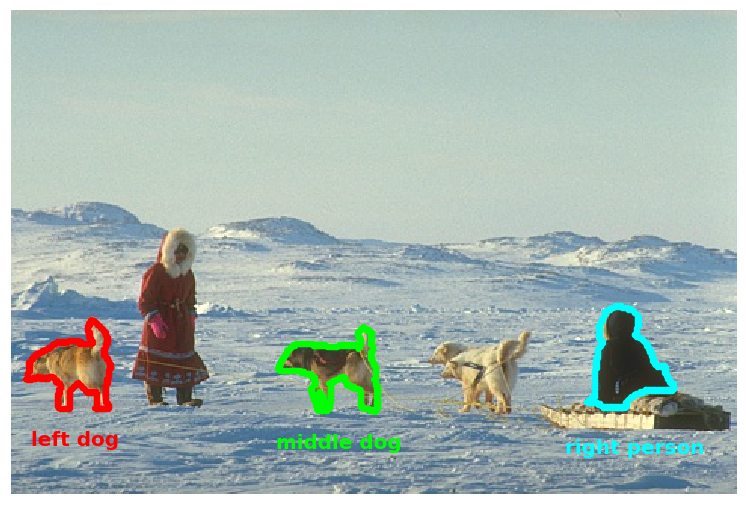

In [5]:
# Set paths
root_dir = '/homes/liu1740/Research/LocalGraphClustering/notebooks/datasets/BSR/BSDS500/data/groundTruth/train/'
root_dir2 = '/homes/liu1740/Research/LocalGraphClustering/notebooks/datasets/BSR/BSDS500/data/images/train/'

# Load image
img = imread(root_dir2 + '310007.jpg')
[m,n] = img.shape[0:2]
n_pixels = m*n

f = plt.figure(figsize=(13, 10))
ax = f.add_subplot(111)
ax.imshow(img)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.set_yticks([])
ax.set_xticks([])

whichlabel = 4
groundtruth = np.where(labels_true == whichlabel)
howmany = groundtruth[0].shape[0]
xaxis = groundtruth[0]
yaxis = groundtruth[1]

target_cluster = []

for i in range(howmany):
    pixel = xaxis[i]*n + yaxis[i]
    target_cluster.append(pixel)

temp = np.zeros(n_pixels)
temp[target_cluster] = 1
x,y = np.nonzero(find_boundaries(temp.reshape((m,n)),mode="thick"))
ax.scatter(y,x,s=20,color="cyan")
ax.text(np.mean(y)-40,np.mean(x)+60,"right person",fontsize=20,color="cyan",fontweight="bold")

whichlabel = 5
groundtruth = np.where(labels_true == whichlabel)
howmany = groundtruth[0].shape[0]
xaxis = groundtruth[0]
yaxis = groundtruth[1]

target_cluster = []

for i in range(howmany):
    pixel = xaxis[i]*n + yaxis[i]
    target_cluster.append(pixel)

temp = np.zeros(n_pixels)
temp[target_cluster] = 1
x,y = np.nonzero(find_boundaries(temp.reshape((m,n)),mode="thick"))
ax.scatter(y,x,s=20,color="r")
ax.text(np.mean(y)-30,np.mean(x)+50,"left dog",fontsize=20,color="r",fontweight="bold")

whichlabel = 6
groundtruth = np.where(labels_true == whichlabel)
howmany = groundtruth[0].shape[0]
xaxis = groundtruth[0]
yaxis = groundtruth[1]

target_cluster = []

for i in range(howmany):
    pixel = xaxis[i]*n + yaxis[i]
    target_cluster.append(pixel)

temp = np.zeros(n_pixels)
temp[target_cluster] = 1
x,y = np.nonzero(find_boundaries(temp.reshape((m,n)),mode="thick"))
ax.scatter(y,x,s=20,color="lime")
ax.text(np.mean(y)-40,np.mean(x)+50,"middle dog",fontsize=20,color="lime",fontweight="bold")

plt.show()

f.savefig('image_segmentation/target_sets.pdf', format='pdf',bbox_inches='tight')

In [6]:
from collections import defaultdict
input_all = defaultdict(dict)
output_all = defaultdict(dict)

# Left dog

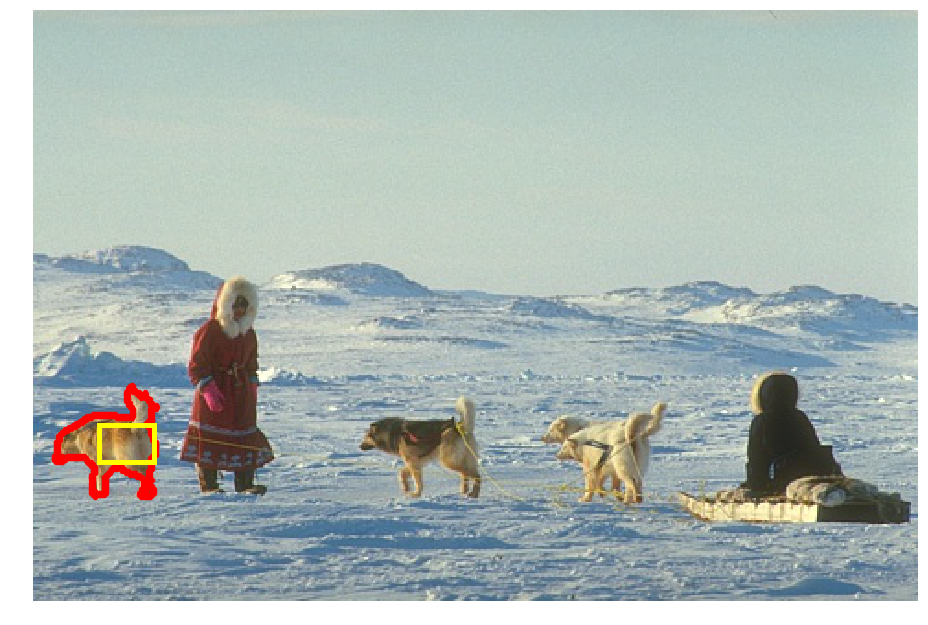

Conductance:  0.003486615814961449
Precision:  0.9696218226906386
Recall:  0.929845422116528


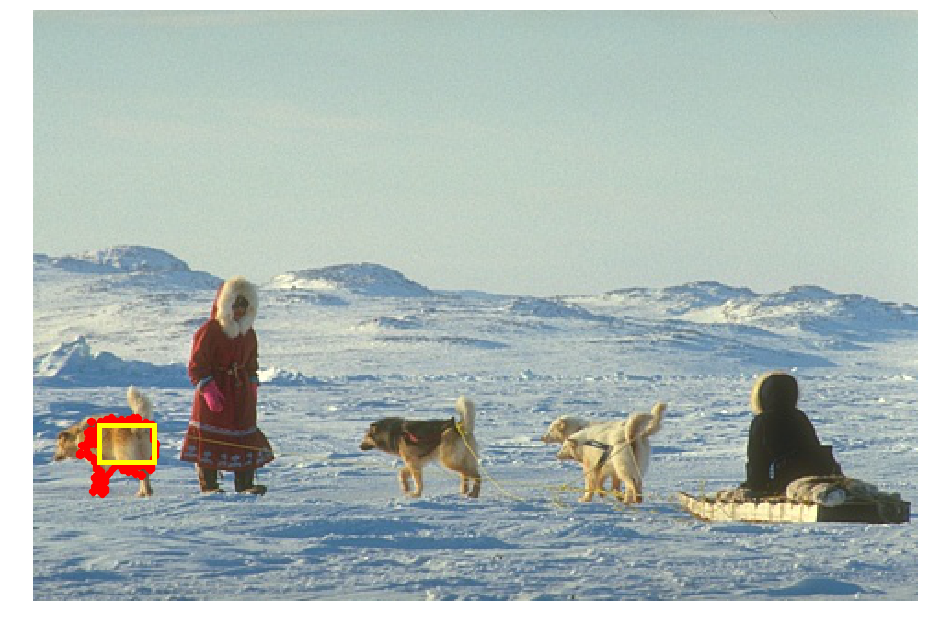

Conductance:  0.03665746088538581
Precision:  0.9646118721461188
Recall:  0.5023781212841855


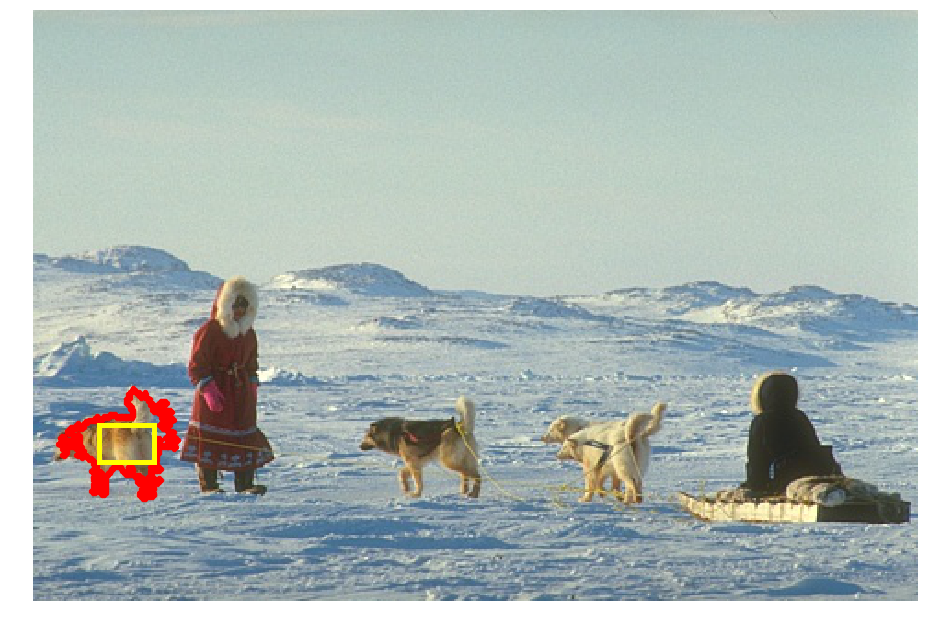

Conductance:  0.03578050740167635
Precision:  0.8386691776522285
Recall:  0.7942925089179548


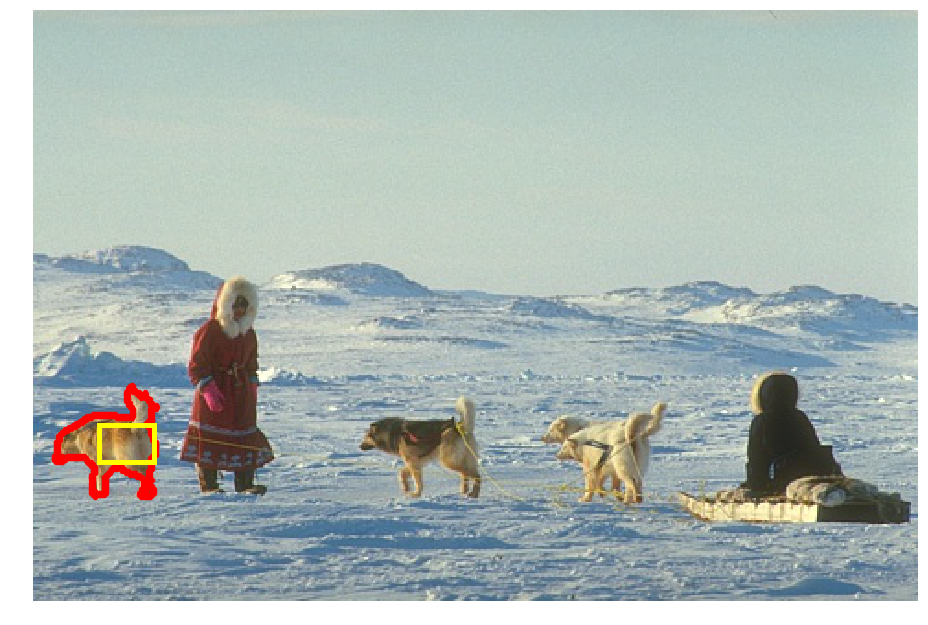

Conductance:  0.003486615814961449
Precision:  0.9696218226906386
Recall:  0.929845422116528


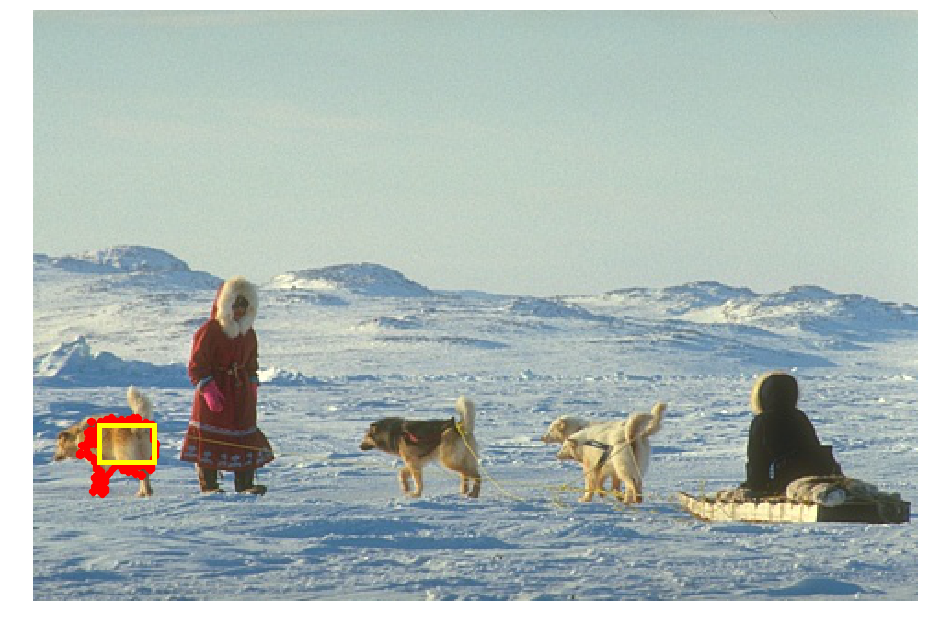

Conductance:  0.03665746088538581
Precision:  0.9646118721461188
Recall:  0.5023781212841855


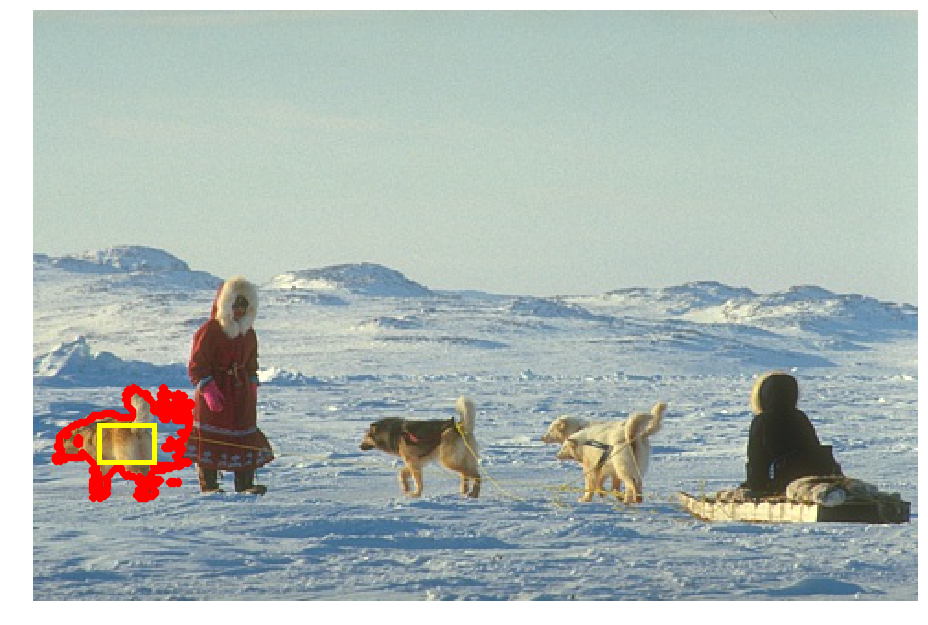

Conductance:  0.01704716130401262
Precision:  0.7055860805860806
Recall:  0.9161712247324614


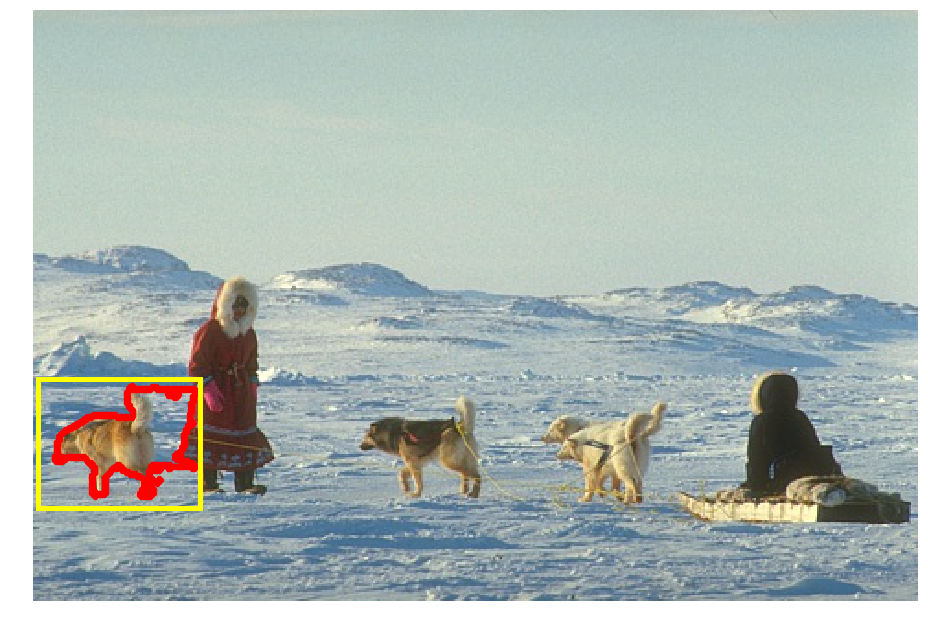

Conductance:  0.0030823968983553184
Precision:  0.6365478119935171
Recall:  0.9340071343638525


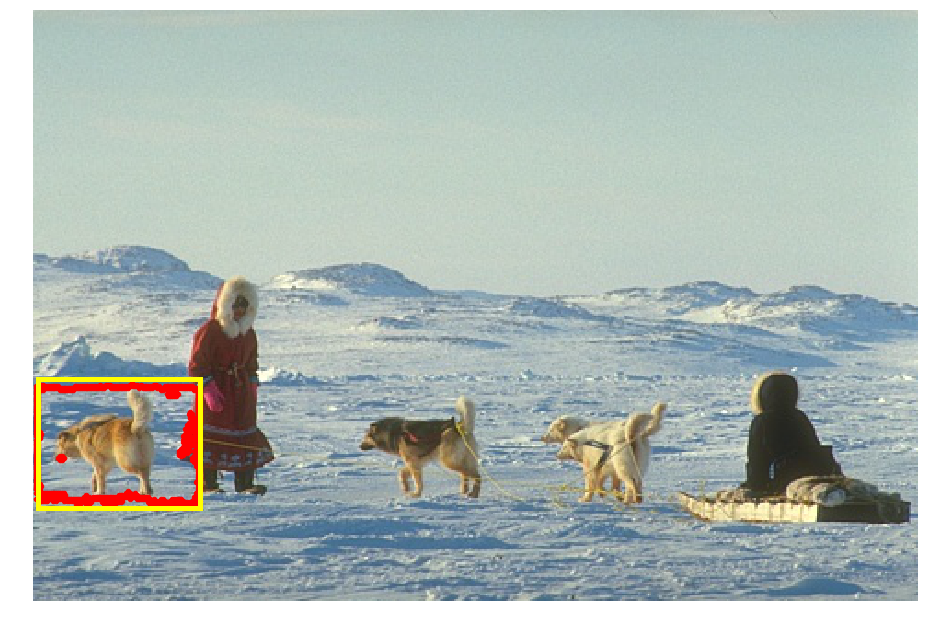

Conductance:  0.04595159427055446
Precision:  0.3183023872679045
Recall:  0.9988109393579072


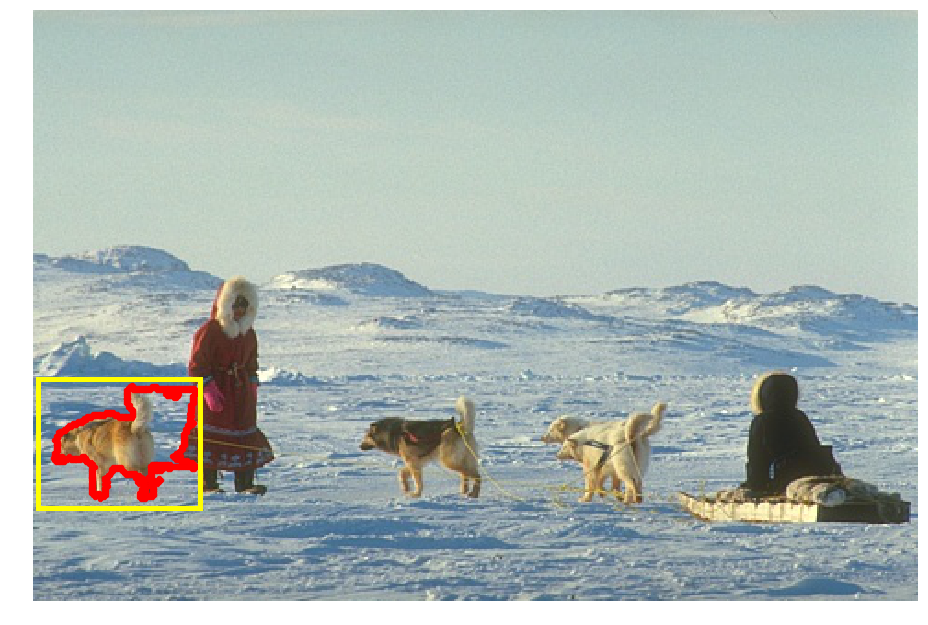

Conductance:  0.003948461186857439
Precision:  0.6363636363636364
Recall:  0.9571938168846611


In [22]:
# Set teleportation parameter
alpha = 0.1

cond_curr,pr_curr,rc_curr = [],[],[]

box = []
for i in range(35,65,1):
    for j in range(225,245,1):
        pixel = j*n + i
        if pixel in mapping:  
            box.append(mapping[pixel])


whichlabel = 5
groundtruth = np.where(labels_true == whichlabel)
howmany = groundtruth[0].shape[0]
xaxis = groundtruth[0]
yaxis = groundtruth[1]

target_cluster = []

for i in range(howmany):
    pixel = xaxis[i]*n + yaxis[i]
    target_cluster.append(pixel)

cond_curr.append(g.compute_conductance(target_cluster))
pr_curr.append(1.0)
rc_curr.append(1.0)

f = plt.figure(figsize=(13, 10))
ax = f.add_subplot(111)
rect = patches.Rectangle((35,225),30,20,linewidth=5,edgecolor='yellow',facecolor='none')
ax.add_patch(rect)
ax.imshow(img)

output_sl = flow_clustering(g,box,method="sl_weighted",delta=0.3,check_connectivity=False)
output_sl = ([mapping_rev[i] for i in output_sl[0]],output_sl[1])
temp = np.zeros(n_pixels)
temp[output_sl[0]] = 1
x,y = np.nonzero(find_boundaries(temp.reshape((m,n)),mode="thick"))
ax.scatter(y,x,s=20,color="r")

plt.axis('off')
plt.tight_layout()
plt.show()

f.savefig('image_segmentation/left_dog_box_sl.pdf', format='pdf',bbox_inches='tight')

input_all["left_dog"]["sl"] = box
output_all["left_dog"]["sl"] = output_sl

print("Conductance: ",output_sl[1])   
print("Precision: ",len(set(output_sl[0]).intersection(target_cluster))*1.0/len(output_sl[0]))    
print("Recall: ",len(set(output_sl[0]).intersection(target_cluster))*1.0/len(target_cluster)) 

f = plt.figure(figsize=(13, 10))
ax = f.add_subplot(111)
rect = patches.Rectangle((35,225),30,20,linewidth=5,edgecolor='yellow',facecolor='none')
ax.add_patch(rect)
ax.imshow(img)

greedy_output = greedy_grow(g,box)
greedy_output = ([mapping_rev[i] for i in greedy_output[0]],greedy_output[1])
temp = np.zeros(n_pixels)
temp[greedy_output[0]] = 1
x,y = np.nonzero(find_boundaries(temp.reshape((m,n)),mode="thick"))
ax.scatter(y,x,s=20,color="r")

plt.axis('off')
plt.tight_layout()
plt.show()

f.savefig('image_segmentation/left_dog_box_greedy_grow.pdf', format='pdf',bbox_inches='tight')
    
input_all["left_dog"]["greedy_grow"] = box
output_all["left_dog"]["greedy_grow"] = greedy_output
    
print("Conductance: ",greedy_output[1])   
print("Precision: ",len(set(greedy_output[0]).intersection(target_cluster))*1.0/len(greedy_output[0]))    
print("Recall: ",len(set(greedy_output[0]).intersection(target_cluster))*1.0/len(target_cluster)) 

f = plt.figure(figsize=(13, 10))
ax = f.add_subplot(111)
rect = patches.Rectangle((35,225),30,20,linewidth=5,edgecolor='yellow',facecolor='none')
ax.add_patch(rect)
ax.imshow(img)

output_l1reg = spectral_clustering(g,box,method="l1reg-rand",rho=1.0e-6)
output_l1reg = ([mapping_rev[i] for i in output_l1reg[0]],output_l1reg[1])
temp = np.zeros(n_pixels)
temp[output_l1reg[0]] = 1
x,y = np.nonzero(find_boundaries(temp.reshape((m,n)),mode="thick"))
ax.scatter(y,x,s=20,color="r")

plt.axis('off')
plt.tight_layout()
plt.show()

f.savefig('image_segmentation/left_dog_box_l1reg_large_rho.pdf', format='pdf',bbox_inches='tight')

input_all["left_dog"]["l1reg_large"] = box
output_all["left_dog"]["l1reg_large"] = output_l1reg

print("Conductance: ",output_l1reg[1])   
print("Precision: ",len(set(output_l1reg[0]).intersection(target_cluster))*1.0/len(output_l1reg[0]))    
print("Recall: ",len(set(output_l1reg[0]).intersection(target_cluster))*1.0/len(target_cluster)) 

cond_curr.append(g.compute_conductance(box))
pr_curr.append(len(set(box).intersection(target_cluster))*1.0/len(box))
rc_curr.append(len(set(box).intersection(target_cluster))*1.0/len(target_cluster))

cond_curr.append(greedy_output[1])
pr_curr.append(len(set(greedy_output[0]).intersection(target_cluster))*1.0/len(greedy_output[0]))
rc_curr.append(len(set(greedy_output[0]).intersection(target_cluster))*1.0/len(target_cluster))

cond_curr.append(output_l1reg[1])
pr_curr.append(len(set(output_l1reg[0]).intersection(target_cluster))*1.0/len(output_l1reg[0]))
rc_curr.append(len(set(output_l1reg[0]).intersection(target_cluster))*1.0/len(target_cluster))

cond_curr.append(output_sl[1])
pr_curr.append(len(set(output_sl[0]).intersection(target_cluster))*1.0/len(output_sl[0]))
rc_curr.append(len(set(output_sl[0]).intersection(target_cluster))*1.0/len(target_cluster))


f = plt.figure(figsize=(13, 10))
ax = f.add_subplot(111)
rect = patches.Rectangle((35,225),30,20,linewidth=5,edgecolor='yellow',facecolor='none')
ax.add_patch(rect)
ax.imshow(img)

#output_fi = flow_clustering(g,box,method="sl_weighted",delta=np.sum(g.d[box])/(np.sum(g.d)-np.sum(g.d[box])))
output_fi = flow_clustering(g,box,method="sl_weighted",delta=0,check_connectivity=False)
output_fi = ([mapping_rev[i] for i in output_fi[0]],output_fi[1])
temp = np.zeros(n_pixels)
temp[output_fi[0]] = 1
x,y = np.nonzero(find_boundaries(temp.reshape((m,n)),mode="thick"))
ax.scatter(y,x,s=20,color="r")

plt.axis('off')
plt.tight_layout()
plt.show()

f.savefig('image_segmentation/left_dog_box_fi.pdf', format='pdf',bbox_inches='tight')

input_all["left_dog"]["fi"] = box
output_all["left_dog"]["fi"] = output_fi

print("Conductance: ",output_fi[1])   
print("Precision: ",len(set(output_fi[0]).intersection(target_cluster))*1.0/len(output_fi[0]))    
print("Recall: ",len(set(output_fi[0]).intersection(target_cluster))*1.0/len(target_cluster)) 


f = plt.figure(figsize=(13, 10))
ax = f.add_subplot(111)
rect = patches.Rectangle((35,225),30,20,linewidth=5,edgecolor='yellow',facecolor='none')
ax.add_patch(rect)
ax.imshow(img)

greedy_output = greedy_grow(g,box)
greedy_output = ([mapping_rev[i] for i in greedy_output[0]],greedy_output[1])
temp = np.zeros(n_pixels)
temp[greedy_output[0]] = 1
x,y = np.nonzero(find_boundaries(temp.reshape((m,n)),mode="thick"))
ax.scatter(y,x,s=20,color="r")
    
plt.axis('off')
plt.tight_layout()
plt.show()

f.savefig('image_segmentation/left_dog_box_greedy_grow.pdf', format='pdf',bbox_inches='tight')

print("Conductance: ",greedy_output[1])   
print("Precision: ",len(set(greedy_output[0]).intersection(target_cluster))*1.0/len(greedy_output[0]))    
print("Recall: ",len(set(greedy_output[0]).intersection(target_cluster))*1.0/len(target_cluster)) 

f = plt.figure(figsize=(13, 10))
ax = f.add_subplot(111)
rect = patches.Rectangle((35,225),30,20,linewidth=5,edgecolor='yellow',facecolor='none')
ax.add_patch(rect)
ax.imshow(img)

output_l1reg = spectral_clustering(g,box,method="l1reg-rand",rho=1.0e-10)
output_l1reg = ([mapping_rev[i] for i in output_l1reg[0]],output_l1reg[1])
temp = np.zeros(n_pixels)
temp[output_l1reg[0]] = 1
x,y = np.nonzero(find_boundaries(temp.reshape((m,n)),mode="thick"))
ax.scatter(y,x,s=20,color="r")

plt.axis('off')
plt.tight_layout()
plt.show()

f.savefig('image_segmentation/left_dog_box_l1reg_small_rho.pdf', format='pdf',bbox_inches='tight')

input_all["left_dog"]["l1reg_small"] = box
output_all["left_dog"]["l1reg_small"] = output_l1reg

print("Conductance: ",output_l1reg[1])   
print("Precision: ",len(set(output_l1reg[0]).intersection(target_cluster))*1.0/len(output_l1reg[0]))    
print("Recall: ",len(set(output_l1reg[0]).intersection(target_cluster))*1.0/len(target_cluster)) 

cond_curr.append(g.compute_conductance(box))
pr_curr.append(len(set(box).intersection(target_cluster))*1.0/len(box))
rc_curr.append(len(set(box).intersection(target_cluster))*1.0/len(target_cluster))

cond_curr.append(greedy_output[1])
pr_curr.append(len(set(greedy_output[0]).intersection(target_cluster))*1.0/len(greedy_output[0]))
rc_curr.append(len(set(greedy_output[0]).intersection(target_cluster))*1.0/len(target_cluster))

cond_curr.append(output_l1reg[1])
pr_curr.append(len(set(output_l1reg[0]).intersection(target_cluster))*1.0/len(output_l1reg[0]))
rc_curr.append(len(set(output_l1reg[0]).intersection(target_cluster))*1.0/len(target_cluster))

cond_curr.append(output_fi[1])
pr_curr.append(len(set(output_fi[0]).intersection(target_cluster))*1.0/len(output_fi[0]))
rc_curr.append(len(set(output_fi[0]).intersection(target_cluster))*1.0/len(target_cluster))




box = []
for i in range(2,90,1):
    for j in range(200,270,1):
        pixel = j*n + i
        if pixel in mapping:  
            box.append(mapping[pixel])

f = plt.figure(figsize=(13, 10))
ax = f.add_subplot(111)
rect = patches.Rectangle((2,200),88,70,linewidth=5,edgecolor='yellow',facecolor='none')
ax.add_patch(rect)
ax.imshow(img)

output_mqi = flow_clustering(g,box,method="mqi_weighted")
output_mqi = ([mapping_rev[i] for i in output_mqi[0]],output_mqi[1])
temp = np.zeros(n_pixels)
temp[output_mqi[0]] = 1
x,y = np.nonzero(find_boundaries(temp.reshape((m,n)),mode="thick"))
ax.scatter(y,x,s=20,color="r") 

plt.axis('off')
plt.tight_layout()
plt.show()

f.savefig('image_segmentation/left_dog_box_mqi.pdf', format='pdf',bbox_inches='tight')

input_all["left_dog"]["mqi"] = box
output_all["left_dog"]["mqi"] = output_mqi

print("Conductance: ",output_mqi[1])   
print("Precision: ",len(set(output_mqi[0]).intersection(target_cluster))*1.0/len(output_mqi[0]))    
print("Recall: ",len(set(output_mqi[0]).intersection(target_cluster))*1.0/len(target_cluster)) 

f = plt.figure(figsize=(13, 10))
ax = f.add_subplot(111)
rect = patches.Rectangle((2,200),88,70,linewidth=5,edgecolor='yellow',facecolor='none')
ax.add_patch(rect)
ax.imshow(img)

greedy_output = greedy_shrink(g,box)
greedy_output = ([mapping_rev[i] for i in greedy_output[0]],greedy_output[1])
temp = np.zeros(n_pixels)
temp[greedy_output[0]] = 1
x,y = np.nonzero(find_boundaries(temp.reshape((m,n)),mode="thick"))
ax.scatter(y,x,s=20,color="r")

plt.axis('off')
plt.tight_layout()
plt.show()

f.savefig('image_segmentation/left_dog_box_greedy_shrink.pdf', format='pdf',bbox_inches='tight')

input_all["left_dog"]["greedy_shrink"] = box
output_all["left_dog"]["greedy_shrink"] = greedy_output

print("Conductance: ",greedy_output[1])   
print("Precision: ",len(set(greedy_output[0]).intersection(target_cluster))*1.0/len(greedy_output[0]))    
print("Recall: ",len(set(greedy_output[0]).intersection(target_cluster))*1.0/len(target_cluster))  

f = plt.figure(figsize=(13, 10))
ax = f.add_subplot(111)
rect = patches.Rectangle((2,200),88,70,linewidth=5,edgecolor='yellow',facecolor='none')
ax.add_patch(rect)
ax.imshow(img)

output_fiedler = spectral_clustering(g,box,method="fiedler_local")
output_fiedler = ([mapping_rev[i] for i in output_fiedler[0]],output_fiedler[1])
temp = np.zeros(n_pixels)
temp[output_fiedler[0]] = 1
x,y = np.nonzero(find_boundaries(temp.reshape((m,n)),mode="thick"))
ax.scatter(y,x,s=20,color="r")

plt.axis('off')
plt.tight_layout()
plt.show()

f.savefig('image_segmentation/left_dog_box_fiedler.pdf', format='pdf',bbox_inches='tight')

input_all["left_dog"]["fiedler"] = box
output_all["left_dog"]["fiedler"] = output_fiedler

print("Conductance: ",output_fiedler[1])   
print("Precision: ",len(set(output_fiedler[0]).intersection(target_cluster))*1.0/len(output_fiedler[0]))    
print("Recall: ",len(set(output_fiedler[0]).intersection(target_cluster))*1.0/len(target_cluster)) 

cond_curr.append(g.compute_conductance(box))
pr_curr.append(len(set(box).intersection(target_cluster))*1.0/len(box))
rc_curr.append(len(set(box).intersection(target_cluster))*1.0/len(target_cluster))

cond_curr.append(greedy_output[1])
pr_curr.append(len(set(greedy_output[0]).intersection(target_cluster))*1.0/len(greedy_output[0]))
rc_curr.append(len(set(greedy_output[0]).intersection(target_cluster))*1.0/len(target_cluster))

cond_curr.append(output_fiedler[1])
pr_curr.append(len(set(output_fiedler[0]).intersection(target_cluster))*1.0/len(output_fiedler[0]))
rc_curr.append(len(set(output_fiedler[0]).intersection(target_cluster))*1.0/len(target_cluster))

cond_curr.append(output_mqi[1])
pr_curr.append(len(set(output_mqi[0]).intersection(target_cluster))*1.0/len(output_mqi[0]))
rc_curr.append(len(set(output_mqi[0]).intersection(target_cluster))*1.0/len(target_cluster))


cond_all.append(cond_curr)
pr_all.append(pr_curr)
rc_all.append(rc_curr)

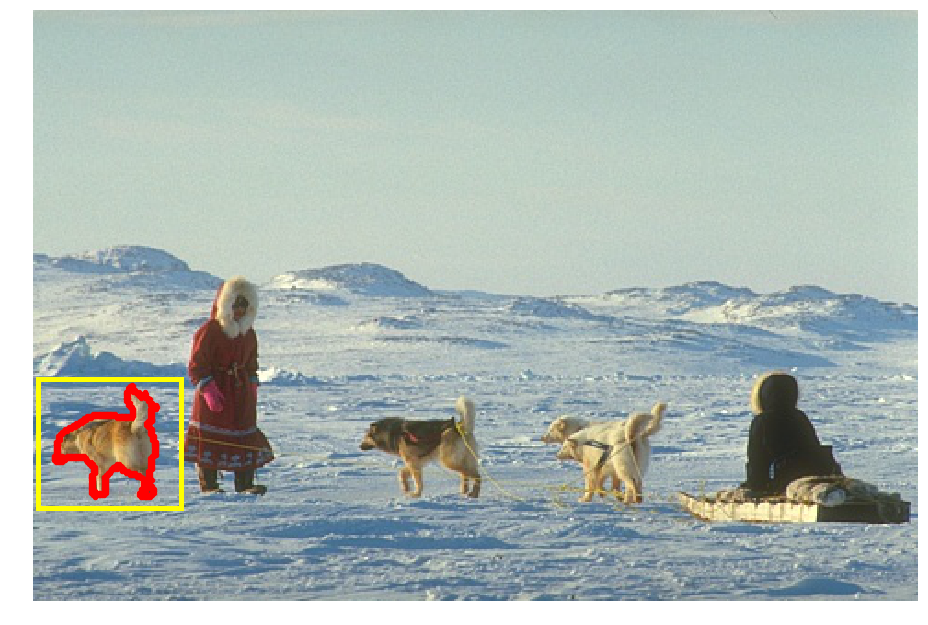

Conductance:  0.003486615814961452
Precision:  0.9696218226906386
Recall:  0.929845422116528


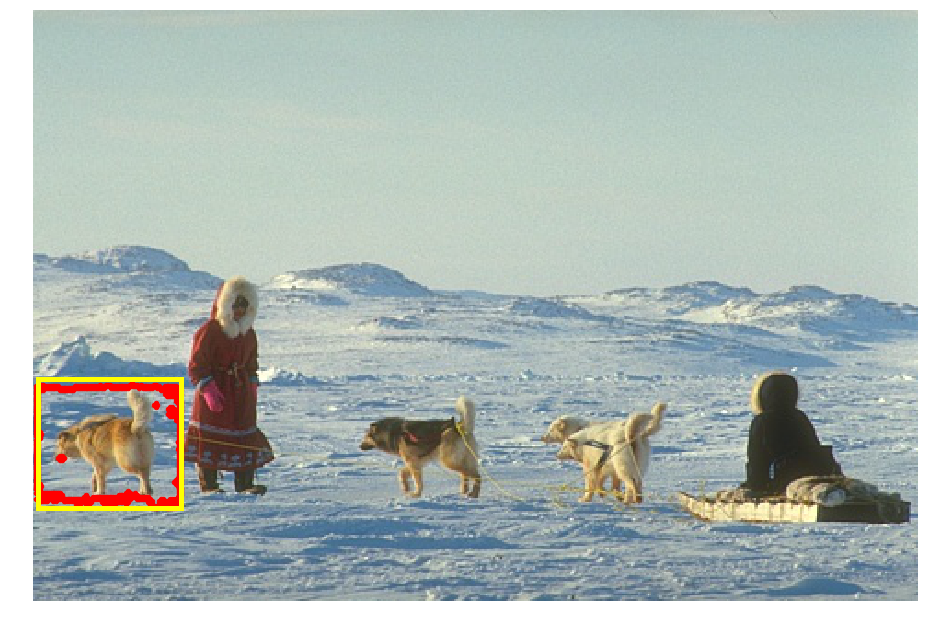

Conductance:  0.06264448938528724
Precision:  0.356234096692112
Recall:  0.9988109393579072


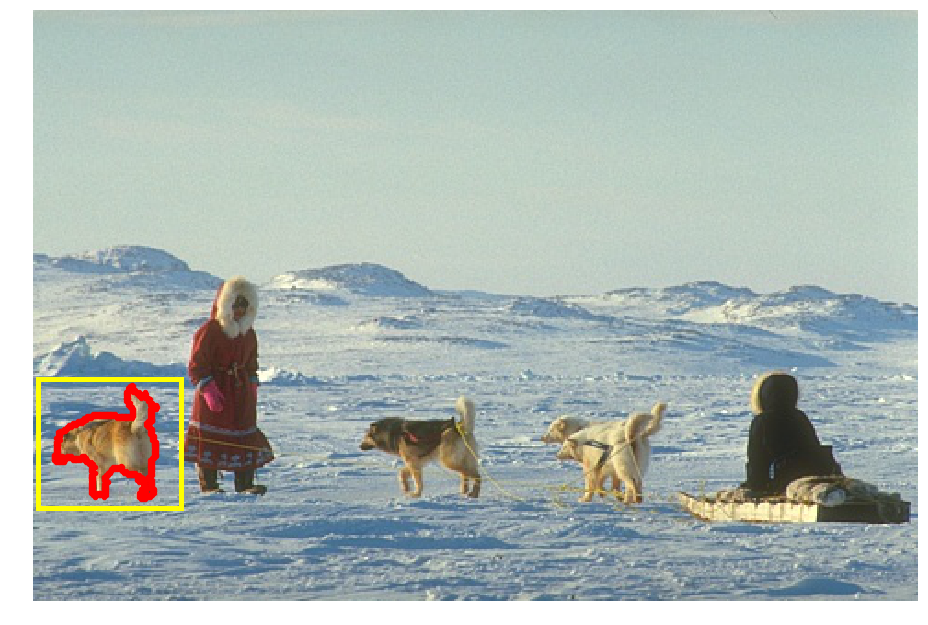

Conductance:  0.003999974744919521
Precision:  0.9594921402660218
Recall:  0.9435196195005945


In [26]:
box = []
for i in range(2,80,1):
    for j in range(200,270,1):
        pixel = j*n + i
        if pixel in mapping:  
            box.append(mapping[pixel])

f = plt.figure(figsize=(13, 10))
ax = f.add_subplot(111)
rect = patches.Rectangle((2,200),78,70,linewidth=5,edgecolor='yellow',facecolor='none')
ax.add_patch(rect)
ax.imshow(img)

output_mqi = flow_clustering(g,box,method="mqi_weighted")
output_mqi = ([mapping_rev[i] for i in output_mqi[0]],output_mqi[1])
temp = np.zeros(n_pixels)
temp[output_mqi[0]] = 1
x,y = np.nonzero(find_boundaries(temp.reshape((m,n)),mode="thick"))
ax.scatter(y,x,s=20,color="r") 

plt.axis('off')
plt.tight_layout()
plt.show()

f.savefig('image_segmentation/left_dog_box_mqi.pdf', format='pdf',bbox_inches='tight')

input_all["left_dog"]["mqi"] = box
output_all["left_dog"]["mqi"] = output_mqi

print("Conductance: ",output_mqi[1])   
print("Precision: ",len(set(output_mqi[0]).intersection(target_cluster))*1.0/len(output_mqi[0]))    
print("Recall: ",len(set(output_mqi[0]).intersection(target_cluster))*1.0/len(target_cluster)) 

f = plt.figure(figsize=(13, 10))
ax = f.add_subplot(111)
rect = patches.Rectangle((2,200),78,70,linewidth=5,edgecolor='yellow',facecolor='none')
ax.add_patch(rect)
ax.imshow(img)

greedy_output = greedy_shrink(g,box)
greedy_output = ([mapping_rev[i] for i in greedy_output[0]],greedy_output[1])
temp = np.zeros(n_pixels)
temp[greedy_output[0]] = 1
x,y = np.nonzero(find_boundaries(temp.reshape((m,n)),mode="thick"))
ax.scatter(y,x,s=20,color="r")

plt.axis('off')
plt.tight_layout()
plt.show()

f.savefig('image_segmentation/left_dog_box_greedy_shrink.pdf', format='pdf',bbox_inches='tight')

input_all["left_dog"]["greedy_shrink"] = box
output_all["left_dog"]["greedy_shrink"] = greedy_output

print("Conductance: ",greedy_output[1])   
print("Precision: ",len(set(greedy_output[0]).intersection(target_cluster))*1.0/len(greedy_output[0]))    
print("Recall: ",len(set(greedy_output[0]).intersection(target_cluster))*1.0/len(target_cluster))  

f = plt.figure(figsize=(13, 10))
ax = f.add_subplot(111)
rect = patches.Rectangle((2,200),78,70,linewidth=5,edgecolor='yellow',facecolor='none')
ax.add_patch(rect)
ax.imshow(img)

output_fiedler = spectral_clustering(g,box,method="fiedler_local")
output_fiedler = ([mapping_rev[i] for i in output_fiedler[0]],output_fiedler[1])
temp = np.zeros(n_pixels)
temp[output_fiedler[0]] = 1
x,y = np.nonzero(find_boundaries(temp.reshape((m,n)),mode="thick"))
ax.scatter(y,x,s=20,color="r")

plt.axis('off')
plt.tight_layout()
plt.show()

f.savefig('image_segmentation/left_dog_box_fiedler.pdf', format='pdf',bbox_inches='tight')

input_all["left_dog"]["fiedler"] = box
output_all["left_dog"]["fiedler"] = output_fiedler

print("Conductance: ",output_fiedler[1])   
print("Precision: ",len(set(output_fiedler[0]).intersection(target_cluster))*1.0/len(output_fiedler[0]))    
print("Recall: ",len(set(output_fiedler[0]).intersection(target_cluster))*1.0/len(target_cluster)) 

cond_curr.append(g.compute_conductance(box))
pr_curr.append(len(set(box).intersection(target_cluster))*1.0/len(box))
rc_curr.append(len(set(box).intersection(target_cluster))*1.0/len(target_cluster))

cond_curr.append(greedy_output[1])
pr_curr.append(len(set(greedy_output[0]).intersection(target_cluster))*1.0/len(greedy_output[0]))
rc_curr.append(len(set(greedy_output[0]).intersection(target_cluster))*1.0/len(target_cluster))

cond_curr.append(output_fiedler[1])
pr_curr.append(len(set(output_fiedler[0]).intersection(target_cluster))*1.0/len(output_fiedler[0]))
rc_curr.append(len(set(output_fiedler[0]).intersection(target_cluster))*1.0/len(target_cluster))

cond_curr.append(output_mqi[1])
pr_curr.append(len(set(output_mqi[0]).intersection(target_cluster))*1.0/len(output_mqi[0]))
rc_curr.append(len(set(output_mqi[0]).intersection(target_cluster))*1.0/len(target_cluster))


cond_all.append(cond_curr)
pr_all.append(pr_curr)
rc_all.append(rc_curr)

# Middle dog

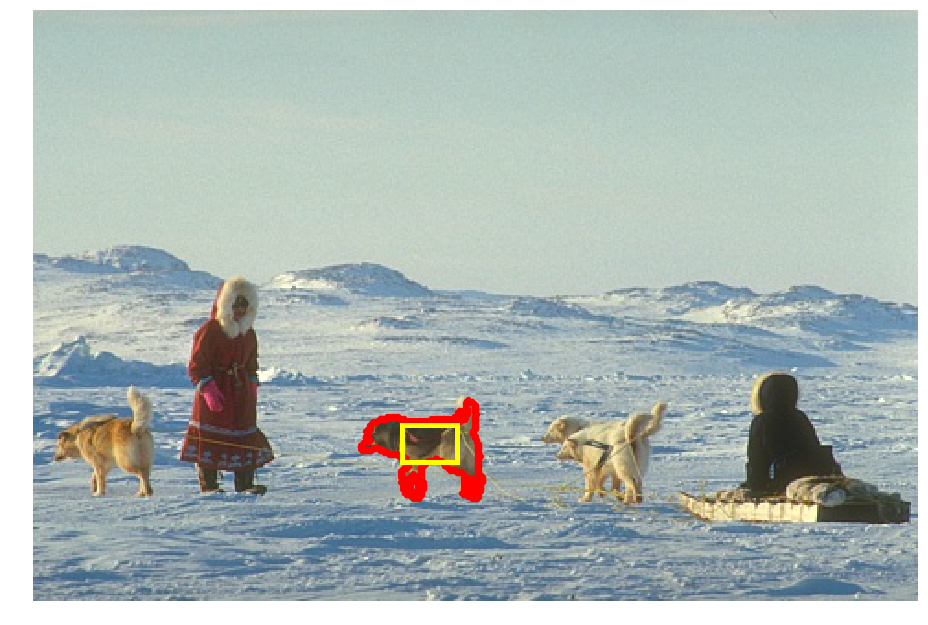

Conductance:  0.0016648038886532843
Precision:  0.9746835443037974
Recall:  0.8983333333333333


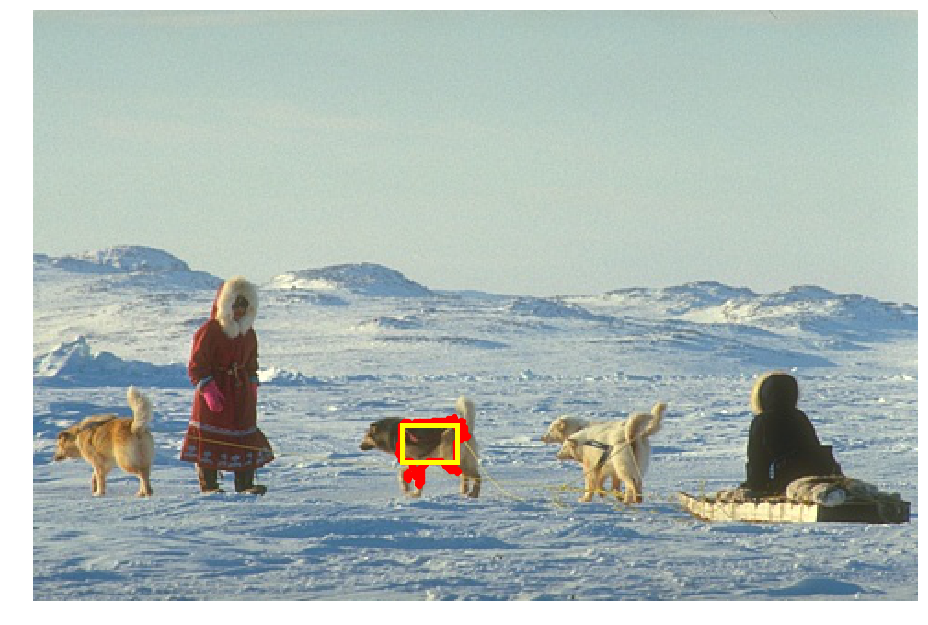

Conductance:  0.03612069569357178
Precision:  0.9865229110512129
Recall:  0.4066666666666667


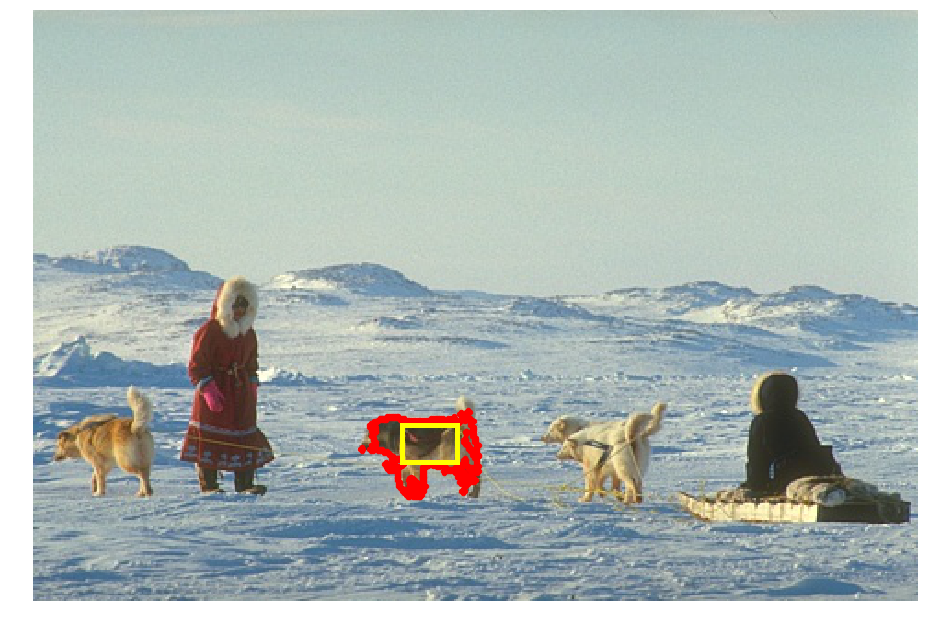

Conductance:  0.023397684900518054
Precision:  0.9366013071895425
Recall:  0.7961111111111111


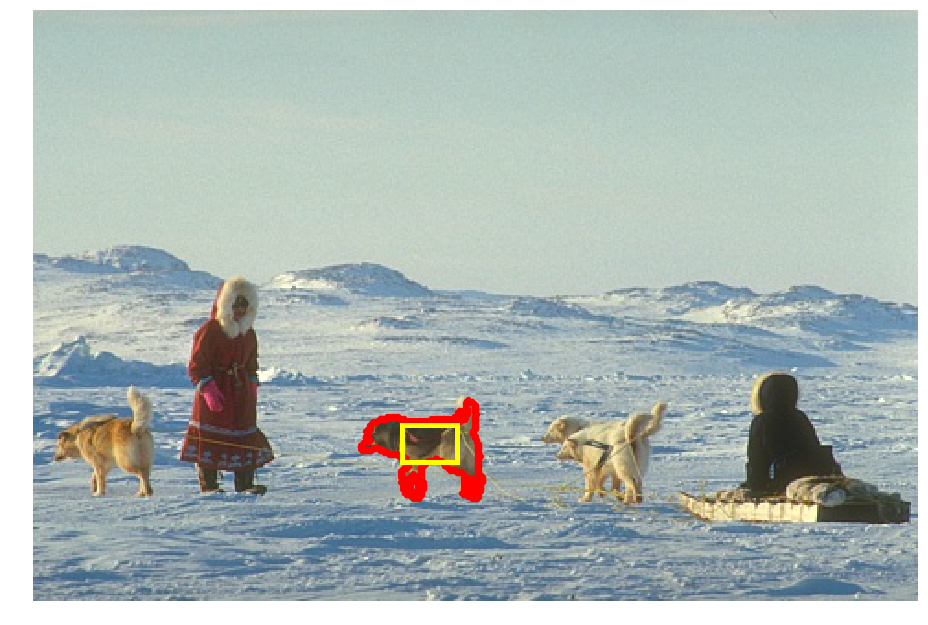

Conductance:  0.0016648038886532843
Precision:  0.9746835443037974
Recall:  0.8983333333333333


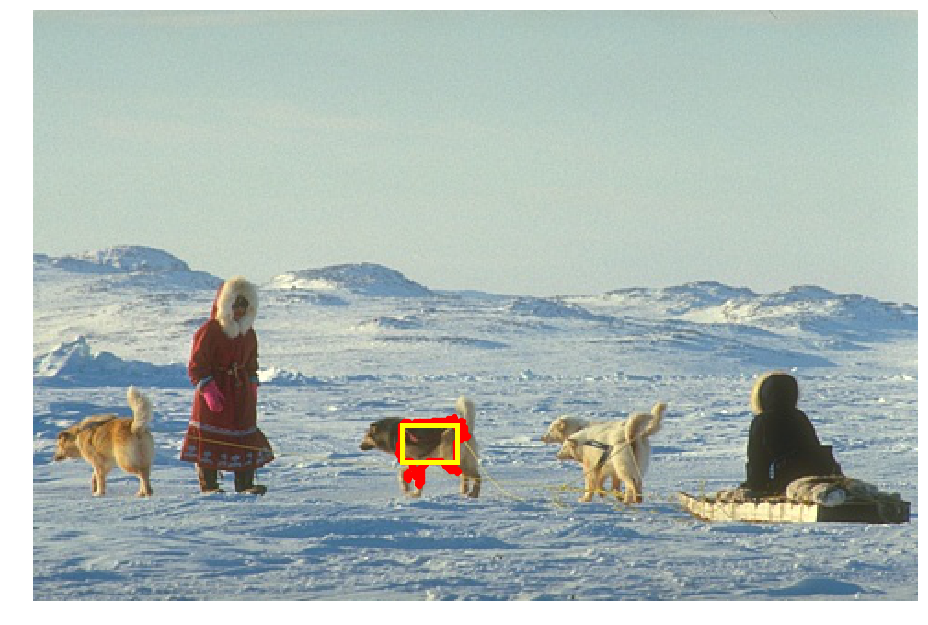

Conductance:  0.03612069569357178
Precision:  0.9865229110512129
Recall:  0.4066666666666667


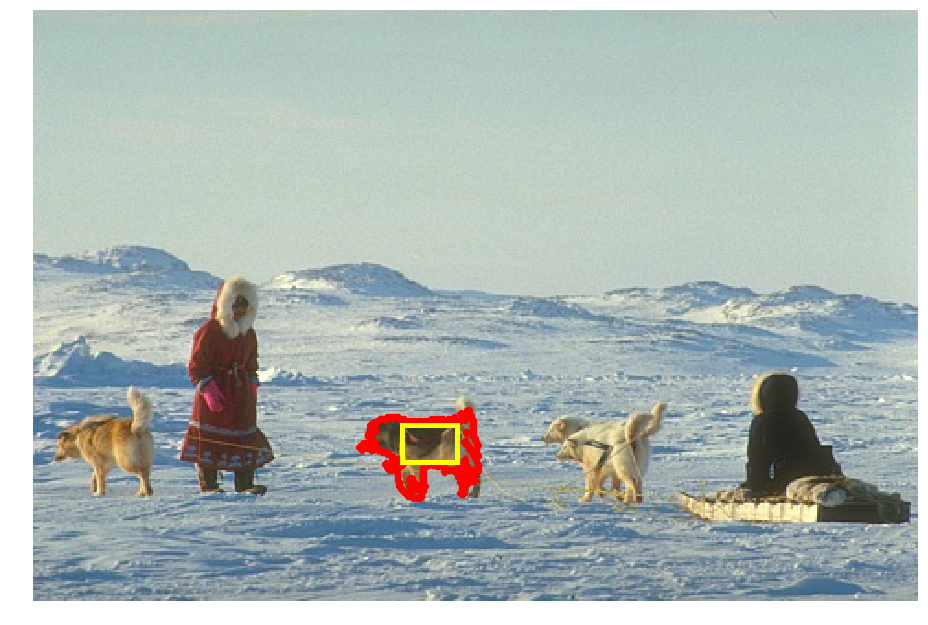

Conductance:  0.020078671158351113
Precision:  0.9324659231722429
Recall:  0.8361111111111111


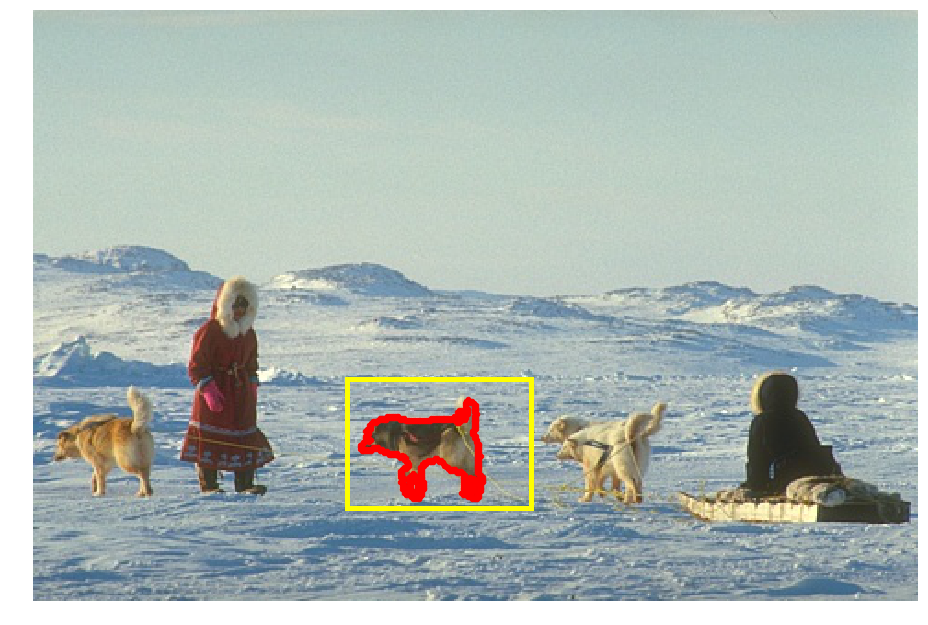

Conductance:  0.0016648038886532854
Precision:  0.9746835443037974
Recall:  0.8983333333333333


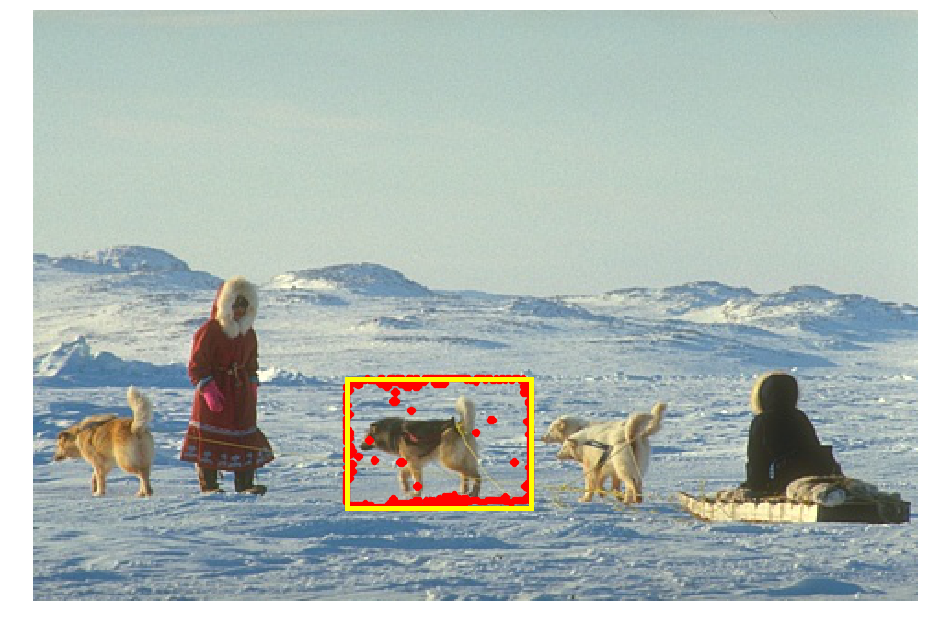

Conductance:  0.05954853787847987
Precision:  0.2721356137429998
Recall:  0.9988888888888889


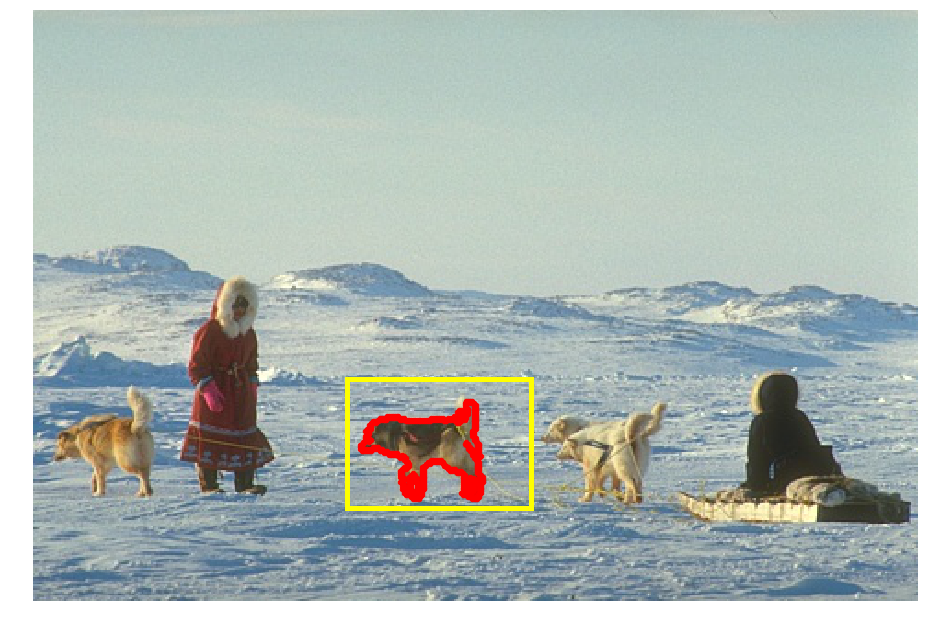

Conductance:  0.00178109022442193
Precision:  0.9752863170584689
Recall:  0.8988888888888888


In [21]:
# Set teleportation parameter
alpha = 0.1

cond_curr,pr_curr,rc_curr = [],[],[]

box = []
for i in range(200,230,1):
    for j in range(225,245,1):
        pixel = j*n + i
        if pixel in mapping:  
            box.append(mapping[pixel])

whichlabel = 6
groundtruth = np.where(labels_true == whichlabel)
howmany = groundtruth[0].shape[0]
xaxis = groundtruth[0]
yaxis = groundtruth[1]

target_cluster = []

for i in range(howmany):
    pixel = xaxis[i]*n + yaxis[i]
    target_cluster.append(pixel)

cond_curr.append(g.compute_conductance(target_cluster))
pr_curr.append(1.0)
rc_curr.append(1.0)

f = plt.figure(figsize=(13, 10))
ax = f.add_subplot(111)
rect = patches.Rectangle((200,225),30,20,linewidth=5,edgecolor='yellow',facecolor='none')
ax.add_patch(rect)
ax.imshow(img)

output_sl = flow_clustering(g,box,method="sl_weighted",delta=0.3,check_connectivity=False)
output_sl = ([mapping_rev[i] for i in output_sl[0]],output_sl[1])
temp = np.zeros(n_pixels)
temp[output_sl[0]] = 1
x,y = np.nonzero(find_boundaries(temp.reshape((m,n)),mode="thick"))
ax.scatter(y,x,s=20,color="r")

plt.axis('off')
plt.tight_layout()
plt.show()

f.savefig('image_segmentation/middle_dog_box_sl.pdf', format='pdf',bbox_inches='tight')

input_all["middle_dog"]["sl"] = box
output_all["middle_dog"]["sl"] = output_sl

print("Conductance: ",output_sl[1])   
print("Precision: ",len(set(output_sl[0]).intersection(target_cluster))*1.0/len(output_sl[0]))    
print("Recall: ",len(set(output_sl[0]).intersection(target_cluster))*1.0/len(target_cluster)) 

f = plt.figure(figsize=(13, 10))
ax = f.add_subplot(111)
rect = patches.Rectangle((200,225),30,20,linewidth=5,edgecolor='yellow',facecolor='none')
ax.add_patch(rect)
ax.imshow(img)

greedy_output = greedy_grow(g,box)
greedy_output = ([mapping_rev[i] for i in greedy_output[0]],greedy_output[1])
temp = np.zeros(n_pixels)
temp[greedy_output[0]] = 1
x,y = np.nonzero(find_boundaries(temp.reshape((m,n)),mode="thick"))
ax.scatter(y,x,s=20,color="r")

plt.axis('off')
plt.tight_layout()
plt.show()

f.savefig('image_segmentation/middle_dog_box_greedy_grow.pdf', format='pdf',bbox_inches='tight')

input_all["middle_dog"]["greedy_grow"] = box
output_all["middle_dog"]["greedy_grow"] = greedy_output

print("Conductance: ",greedy_output[1])   
print("Precision: ",len(set(greedy_output[0]).intersection(target_cluster))*1.0/len(greedy_output[0]))    
print("Recall: ",len(set(greedy_output[0]).intersection(target_cluster))*1.0/len(target_cluster)) 

f = plt.figure(figsize=(13, 10))
ax = f.add_subplot(111)
rect = patches.Rectangle((200,225),30,20,linewidth=5,edgecolor='yellow',facecolor='none')
ax.add_patch(rect)
ax.imshow(img)

output_l1reg = spectral_clustering(g,box,method="l1reg-rand",rho=1.0e-6)
output_l1reg = ([mapping_rev[i] for i in output_l1reg[0]],output_l1reg[1])
temp = np.zeros(n_pixels)
temp[output_l1reg[0]] = 1
x,y = np.nonzero(find_boundaries(temp.reshape((m,n)),mode="thick"))
ax.scatter(y,x,s=20,color="r")

plt.axis('off')
plt.tight_layout()
plt.show()

f.savefig('image_segmentation/middle_dog_box_l1reg_large_rho.pdf', format='pdf',bbox_inches='tight')

input_all["middle_dog"]["l1reg_large"] = box
output_all["middle_dog"]["l1reg_large"] = output_l1reg

print("Conductance: ",output_l1reg[1])   
print("Precision: ",len(set(output_l1reg[0]).intersection(target_cluster))*1.0/len(output_l1reg[0]))    
print("Recall: ",len(set(output_l1reg[0]).intersection(target_cluster))*1.0/len(target_cluster)) 

cond_curr.append(g.compute_conductance(box))
pr_curr.append(len(set(box).intersection(target_cluster))*1.0/len(box))
rc_curr.append(len(set(box).intersection(target_cluster))*1.0/len(target_cluster))

cond_curr.append(greedy_output[1])
pr_curr.append(len(set(greedy_output[0]).intersection(target_cluster))*1.0/len(greedy_output[0]))
rc_curr.append(len(set(greedy_output[0]).intersection(target_cluster))*1.0/len(target_cluster))

cond_curr.append(output_l1reg[1])
pr_curr.append(len(set(output_l1reg[0]).intersection(target_cluster))*1.0/len(output_l1reg[0]))
rc_curr.append(len(set(output_l1reg[0]).intersection(target_cluster))*1.0/len(target_cluster))

cond_curr.append(output_sl[1])
pr_curr.append(len(set(output_sl[0]).intersection(target_cluster))*1.0/len(output_sl[0]))
rc_curr.append(len(set(output_sl[0]).intersection(target_cluster))*1.0/len(target_cluster))





f = plt.figure(figsize=(13, 10))
ax = f.add_subplot(111)
rect = patches.Rectangle((200,225),30,20,linewidth=5,edgecolor='yellow',facecolor='none')
ax.add_patch(rect)
ax.imshow(img)

#output_fi = flow_clustering(g,box,method="sl_weighted",delta=np.sum(g.d[box])/(np.sum(g.d)-np.sum(g.d[box])))
output_fi = flow_clustering(g,box,method="sl_weighted",delta=0,check_connectivity=False)
output_fi = ([mapping_rev[i] for i in output_fi[0]],output_fi[1])
temp = np.zeros(n_pixels)
temp[output_fi[0]] = 1
x,y = np.nonzero(find_boundaries(temp.reshape((m,n)),mode="thick"))
ax.scatter(y,x,s=20,color="r")

plt.axis('off')
plt.tight_layout()
plt.show()

f.savefig('image_segmentation/middle_dog_box_fi.pdf', format='pdf',bbox_inches='tight')

input_all["middle_dog"]["fi"] = box
output_all["middle_dog"]["fi"] = output_fi

print("Conductance: ",output_fi[1])   
print("Precision: ",len(set(output_fi[0]).intersection(target_cluster))*1.0/len(output_fi[0]))    
print("Recall: ",len(set(output_fi[0]).intersection(target_cluster))*1.0/len(target_cluster)) 


f = plt.figure(figsize=(13, 10))
ax = f.add_subplot(111)
rect = patches.Rectangle((200,225),30,20,linewidth=5,edgecolor='yellow',facecolor='none')
ax.add_patch(rect)
ax.imshow(img)

greedy_output = greedy_grow(g,box)
greedy_output = ([mapping_rev[i] for i in greedy_output[0]],greedy_output[1])
temp = np.zeros(n_pixels)
temp[greedy_output[0]] = 1
x,y = np.nonzero(find_boundaries(temp.reshape((m,n)),mode="thick"))
ax.scatter(y,x,s=20,color="r")
    
plt.axis('off')
plt.tight_layout()
plt.show()

f.savefig('image_segmentation/middle_dog_box_greedy_grow.pdf', format='pdf',bbox_inches='tight')

print("Conductance: ",greedy_output[1])   
print("Precision: ",len(set(greedy_output[0]).intersection(target_cluster))*1.0/len(greedy_output[0]))    
print("Recall: ",len(set(greedy_output[0]).intersection(target_cluster))*1.0/len(target_cluster)) 

f = plt.figure(figsize=(13, 10))
ax = f.add_subplot(111)
rect = patches.Rectangle((200,225),30,20,linewidth=5,edgecolor='yellow',facecolor='none')
ax.add_patch(rect)
ax.imshow(img)

output_l1reg = spectral_clustering(g,box,method="l1reg-rand",rho=1.0e-10)
output_l1reg = ([mapping_rev[i] for i in output_l1reg[0]],output_l1reg[1])
temp = np.zeros(n_pixels)
temp[output_l1reg[0]] = 1
x,y = np.nonzero(find_boundaries(temp.reshape((m,n)),mode="thick"))
ax.scatter(y,x,s=20,color="r")

plt.axis('off')
plt.tight_layout()
plt.show()

f.savefig('image_segmentation/middle_dog_box_l1reg_small_rho.pdf', format='pdf',bbox_inches='tight')

input_all["middle_dog"]["l1reg_small"] = box
output_all["middle_dog"]["l1reg_small"] = output_l1reg

print("Conductance: ",output_l1reg[1])   
print("Precision: ",len(set(output_l1reg[0]).intersection(target_cluster))*1.0/len(output_l1reg[0]))    
print("Recall: ",len(set(output_l1reg[0]).intersection(target_cluster))*1.0/len(target_cluster)) 

cond_curr.append(g.compute_conductance(box))
pr_curr.append(len(set(box).intersection(target_cluster))*1.0/len(box))
rc_curr.append(len(set(box).intersection(target_cluster))*1.0/len(target_cluster))

cond_curr.append(greedy_output[1])
pr_curr.append(len(set(greedy_output[0]).intersection(target_cluster))*1.0/len(greedy_output[0]))
rc_curr.append(len(set(greedy_output[0]).intersection(target_cluster))*1.0/len(target_cluster))

cond_curr.append(output_l1reg[1])
pr_curr.append(len(set(output_l1reg[0]).intersection(target_cluster))*1.0/len(output_l1reg[0]))
rc_curr.append(len(set(output_l1reg[0]).intersection(target_cluster))*1.0/len(target_cluster))

cond_curr.append(output_fi[1])
pr_curr.append(len(set(output_fi[0]).intersection(target_cluster))*1.0/len(output_fi[0]))
rc_curr.append(len(set(output_fi[0]).intersection(target_cluster))*1.0/len(target_cluster))





box = []
for i in range(170,270,1):
    for j in range(200,270,1):
        pixel = j*n + i
        if pixel in mapping:
            box.append(mapping[pixel])

f = plt.figure(figsize=(13, 10))
ax = f.add_subplot(111)
rect = patches.Rectangle((170,200),100,70,linewidth=5,edgecolor='yellow',facecolor='none')
ax.add_patch(rect)
ax.imshow(img)

output_mqi = flow_clustering(g,box,method="mqi_weighted")
output_mqi = ([mapping_rev[i] for i in output_mqi[0]],output_mqi[1])
temp = np.zeros(n_pixels)
temp[output_mqi[0]] = 1
x,y = np.nonzero(find_boundaries(temp.reshape((m,n)),mode="thick"))
ax.scatter(y,x,s=20,color="r") 

plt.axis('off')
plt.tight_layout()
plt.show()

f.savefig('image_segmentation/middle_dog_box_mqi.pdf', format='pdf',bbox_inches='tight')

input_all["middle_dog"]["mqi"] = box
output_all["middle_dog"]["mqi"] = output_mqi

print("Conductance: ",output_mqi[1])   
print("Precision: ",len(set(output_mqi[0]).intersection(target_cluster))*1.0/len(output_mqi[0]))    
print("Recall: ",len(set(output_mqi[0]).intersection(target_cluster))*1.0/len(target_cluster)) 

f = plt.figure(figsize=(13, 10))
ax = f.add_subplot(111)
rect = patches.Rectangle((170,200),100,70,linewidth=5,edgecolor='yellow',facecolor='none')
ax.add_patch(rect)
ax.imshow(img)

greedy_output = greedy_shrink(g,box)
greedy_output = ([mapping_rev[i] for i in greedy_output[0]],greedy_output[1])
temp = np.zeros(n_pixels)
temp[greedy_output[0]] = 1
x,y = np.nonzero(find_boundaries(temp.reshape((m,n)),mode="thick"))
ax.scatter(y,x,s=20,color="r")

plt.axis('off')
plt.tight_layout()
plt.show()

f.savefig('image_segmentation/middle_dog_box_greedy_shrink.pdf', format='pdf',bbox_inches='tight')

input_all["middle_dog"]["greedy_shrink"] = box
output_all["middle_dog"]["greedy_shrink"] = greedy_output

print("Conductance: ",greedy_output[1])   
print("Precision: ",len(set(greedy_output[0]).intersection(target_cluster))*1.0/len(greedy_output[0]))    
print("Recall: ",len(set(greedy_output[0]).intersection(target_cluster))*1.0/len(target_cluster))  

f = plt.figure(figsize=(13, 10))
ax = f.add_subplot(111)
rect = patches.Rectangle((170,200),100,70,linewidth=5,edgecolor='yellow',facecolor='none')
ax.add_patch(rect)
ax.imshow(img)

output_fiedler = spectral_clustering(g,box,method="fiedler_local")
output_fiedler = ([mapping_rev[i] for i in output_fiedler[0]],output_fiedler[1])
temp = np.zeros(n_pixels)
temp[output_fiedler[0]] = 1
x,y = np.nonzero(find_boundaries(temp.reshape((m,n)),mode="thick"))
ax.scatter(y,x,s=20,color="r")

plt.axis('off')
plt.tight_layout()
plt.show()

f.savefig('image_segmentation/middle_dog_box_fiedler.pdf', format='pdf',bbox_inches='tight')

input_all["middle_dog"]["fiedler"] = box
output_all["middle_dog"]["fiedler"] = output_fiedler

print("Conductance: ",output_fiedler[1])   
print("Precision: ",len(set(output_fiedler[0]).intersection(target_cluster))*1.0/len(output_fiedler[0]))    
print("Recall: ",len(set(output_fiedler[0]).intersection(target_cluster))*1.0/len(target_cluster)) 

cond_curr.append(g.compute_conductance(box))
pr_curr.append(len(set(box).intersection(target_cluster))*1.0/len(box))
rc_curr.append(len(set(box).intersection(target_cluster))*1.0/len(target_cluster))

cond_curr.append(greedy_output[1])
pr_curr.append(len(set(greedy_output[0]).intersection(target_cluster))*1.0/len(greedy_output[0]))
rc_curr.append(len(set(greedy_output[0]).intersection(target_cluster))*1.0/len(target_cluster))

cond_curr.append(output_fiedler[1])
pr_curr.append(len(set(output_fiedler[0]).intersection(target_cluster))*1.0/len(output_fiedler[0]))
rc_curr.append(len(set(output_fiedler[0]).intersection(target_cluster))*1.0/len(target_cluster))

cond_curr.append(output_mqi[1])
pr_curr.append(len(set(output_mqi[0]).intersection(target_cluster))*1.0/len(output_mqi[0]))
rc_curr.append(len(set(output_mqi[0]).intersection(target_cluster))*1.0/len(target_cluster))



cond_all.append(cond_curr)
pr_all.append(pr_curr)
rc_all.append(rc_curr)

# Right person

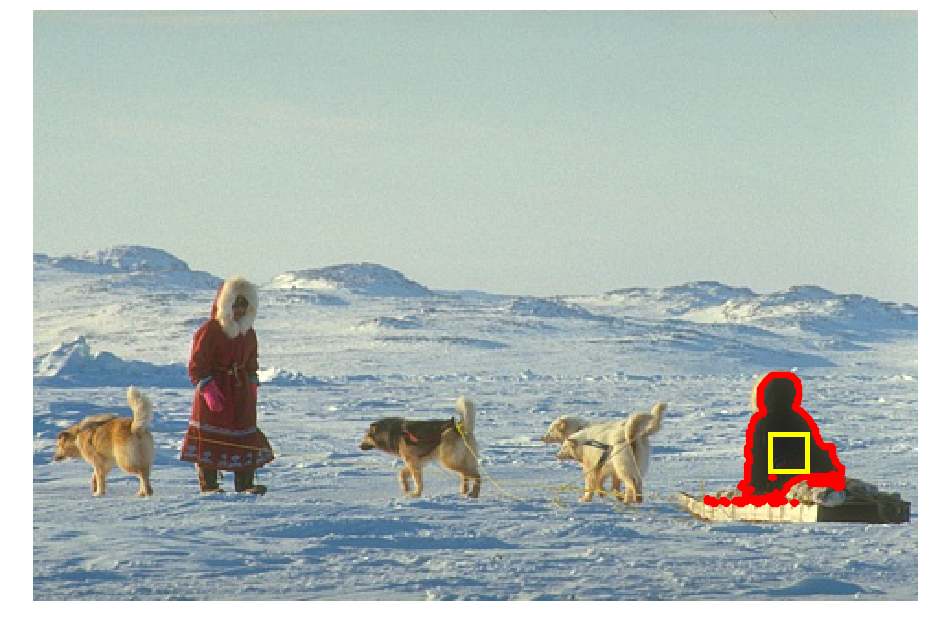

Conductance:  0.0008479975885654468
Precision:  0.9380028395646001
Recall:  0.9133640552995391


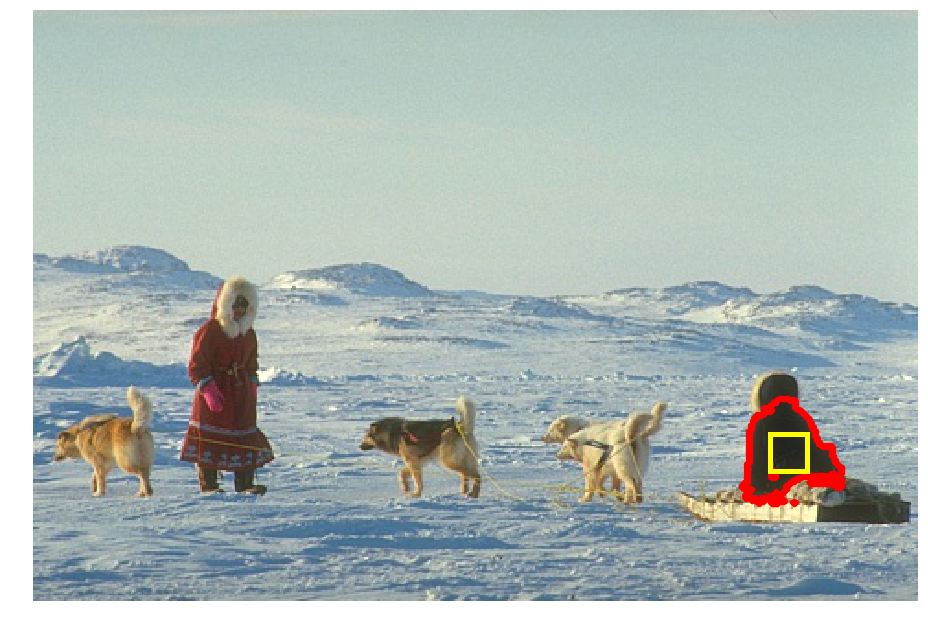

Conductance:  0.016561247163098623
Precision:  0.9394618834080718
Recall:  0.7723502304147466


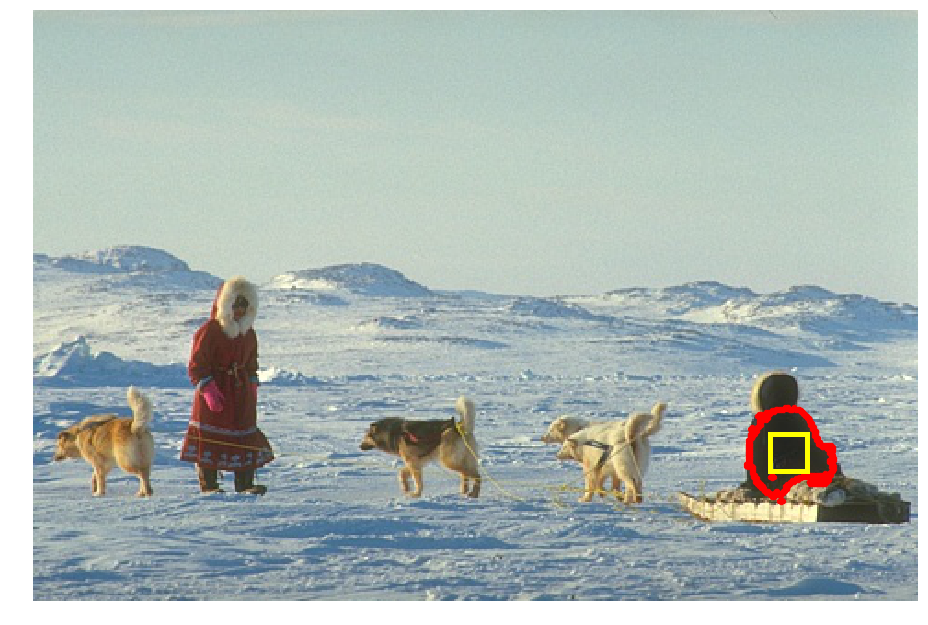

Conductance:  0.03683213810078016
Precision:  0.9723346828609987
Recall:  0.6640552995391705


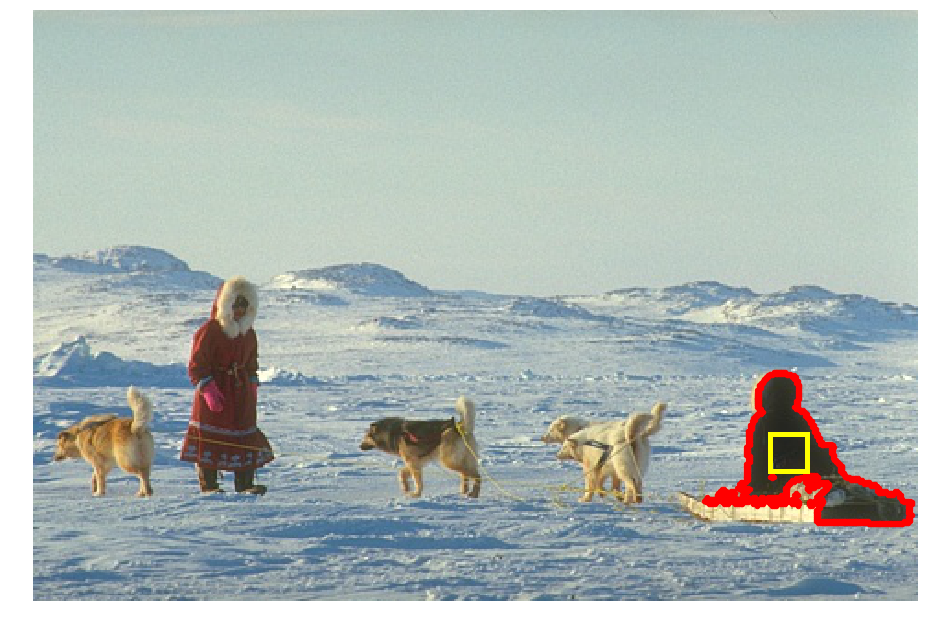

Conductance:  0.00013346076695415143
Precision:  0.6266954377311961
Recall:  0.9368663594470046


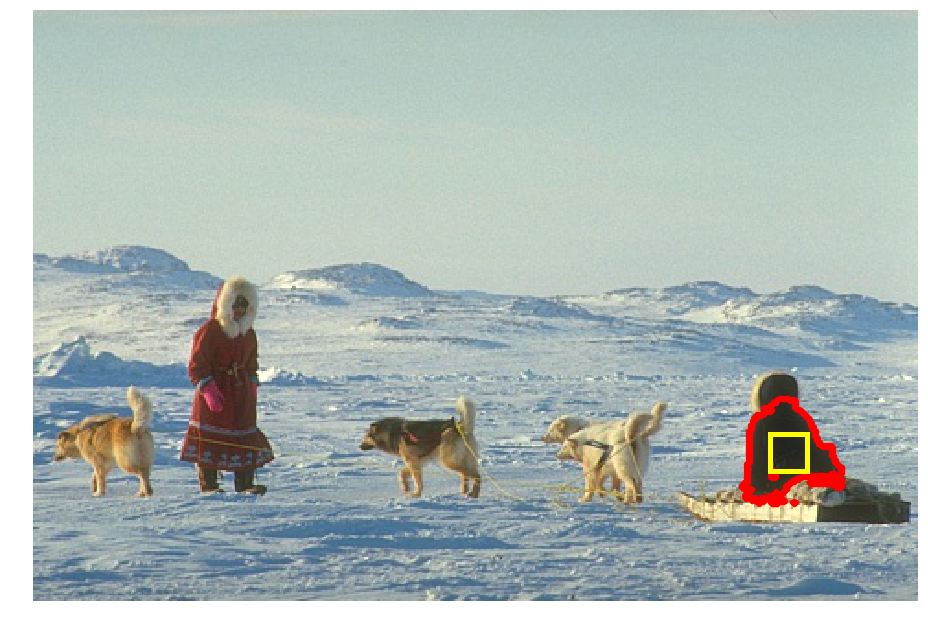

Conductance:  0.016561247163098623
Precision:  0.9394618834080718
Recall:  0.7723502304147466


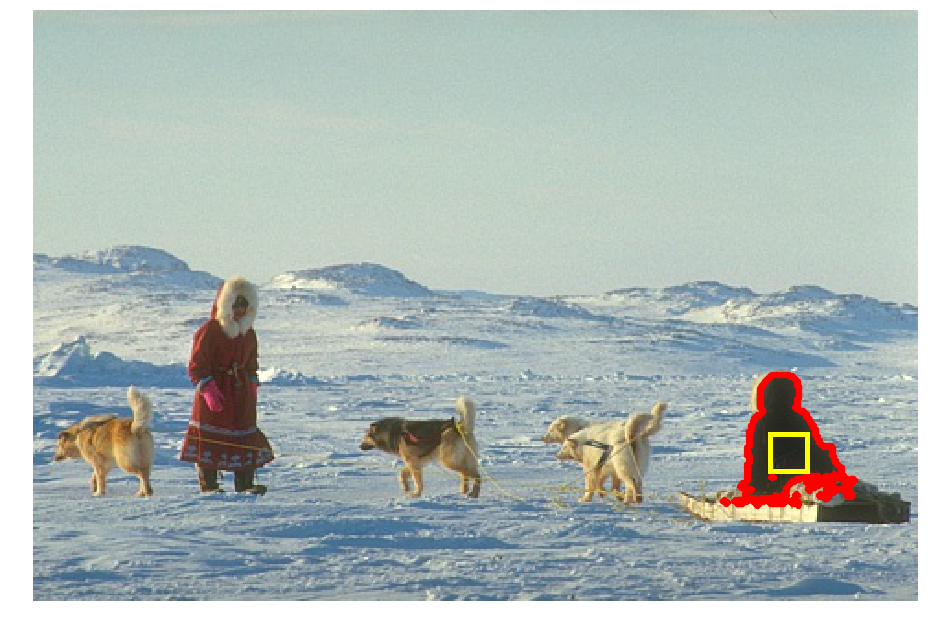

Conductance:  0.0017482530876436063
Precision:  0.8871543264942016
Recall:  0.9165898617511521


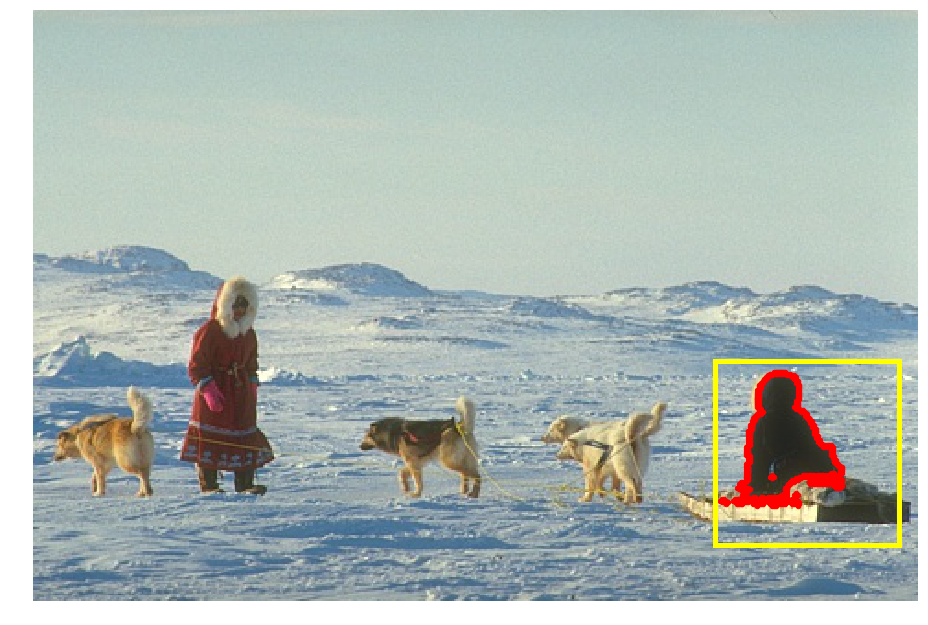

Conductance:  0.0008420084148771358
Precision:  0.9158371040723982
Recall:  0.9327188940092166


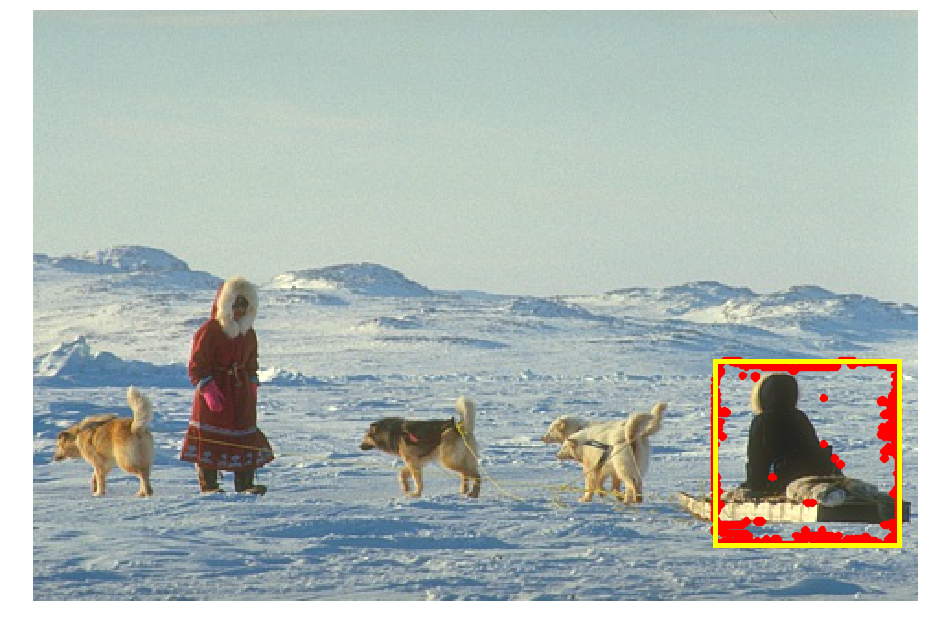

Conductance:  0.036705073870302626
Precision:  0.23384748139359293
Recall:  0.9990783410138249


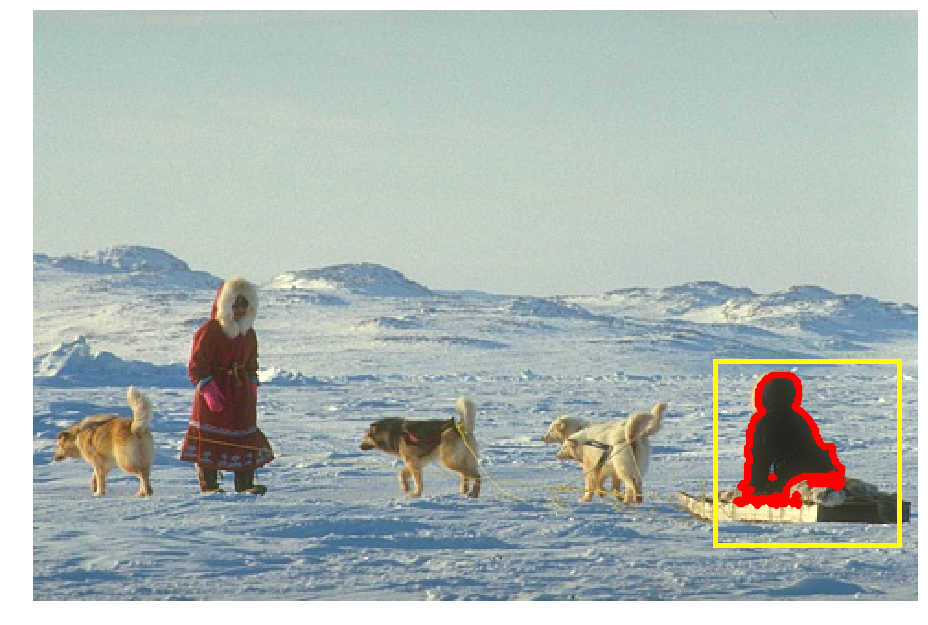

Conductance:  0.0008685278438751428
Precision:  0.9290023201856148
Recall:  0.9225806451612903


In [18]:
# Set teleportation parameter
alpha = 0.1

cond_curr,pr_curr,rc_curr = [],[],[]

box = []
for i in range(400,420,1):
    for j in range(230,250,1):
        pixel = j*n + i
        if pixel in mapping:
            box.append(mapping[pixel])


whichlabel = 4
groundtruth = np.where(labels_true == whichlabel)
howmany = groundtruth[0].shape[0]
xaxis = groundtruth[0]
yaxis = groundtruth[1]

target_cluster = []

for i in range(howmany):
    pixel = xaxis[i]*n + yaxis[i]
    target_cluster.append(pixel)

cond_curr.append(g.compute_conductance(target_cluster))
pr_curr.append(1.0)
rc_curr.append(1.0)

f = plt.figure(figsize=(13, 10))
ax = f.add_subplot(111)
rect = patches.Rectangle((400,230),20,20,linewidth=5,edgecolor='yellow',facecolor='none')
ax.add_patch(rect)
ax.imshow(img)

output_sl = flow_clustering(g,box,method="sl_weighted",delta=0.3,check_connectivity=False)
output_sl = ([mapping_rev[i] for i in output_sl[0]],output_sl[1])
temp = np.zeros(n_pixels)
temp[output_sl[0]] = 1
x,y = np.nonzero(find_boundaries(temp.reshape((m,n)),mode="thick"))
ax.scatter(y,x,s=20,color="r")

plt.axis('off')
plt.tight_layout()
plt.show()

f.savefig('image_segmentation/right_person_box_sl.pdf', format='pdf',bbox_inches='tight')

input_all["right_person"]["sl"] = box
output_all["right_person"]["sl"] = output_sl

print("Conductance: ",output_sl[1])   
print("Precision: ",len(set(output_sl[0]).intersection(target_cluster))*1.0/len(output_sl[0]))    
print("Recall: ",len(set(output_sl[0]).intersection(target_cluster))*1.0/len(target_cluster)) 

f = plt.figure(figsize=(13, 10))
ax = f.add_subplot(111)
rect = patches.Rectangle((400,230),20,20,linewidth=5,edgecolor='yellow',facecolor='none')
ax.add_patch(rect)
ax.imshow(img)

greedy_output = greedy_grow(g,box)
greedy_output = ([mapping_rev[i] for i in greedy_output[0]],greedy_output[1])
temp = np.zeros(n_pixels)
temp[greedy_output[0]] = 1
x,y = np.nonzero(find_boundaries(temp.reshape((m,n)),mode="thick"))
ax.scatter(y,x,s=20,color="r")

plt.axis('off')
plt.tight_layout()
plt.show()

f.savefig('image_segmentation/right_person_box_greedy_grow.pdf', format='pdf',bbox_inches='tight')
    
input_all["right_person"]["greedy_grow"] = box
output_all["right_person"]["greedy_grow"] = greedy_output
    
print("Conductance: ",greedy_output[1])   
print("Precision: ",len(set(greedy_output[0]).intersection(target_cluster))*1.0/len(greedy_output[0]))    
print("Recall: ",len(set(greedy_output[0]).intersection(target_cluster))*1.0/len(target_cluster)) 

f = plt.figure(figsize=(13, 10))
ax = f.add_subplot(111)
rect = patches.Rectangle((400,230),20,20,linewidth=5,edgecolor='yellow',facecolor='none')
ax.add_patch(rect)
ax.imshow(img)

output_l1reg = spectral_clustering(g,box,method="l1reg-rand",rho=1.0e-6)
output_l1reg = ([mapping_rev[i] for i in output_l1reg[0]],output_l1reg[1])
temp = np.zeros(n_pixels)
temp[output_l1reg[0]] = 1
x,y = np.nonzero(find_boundaries(temp.reshape((m,n)),mode="thick"))
ax.scatter(y,x,s=20,color="r")

plt.axis('off')
plt.tight_layout()
plt.show()

f.savefig('image_segmentation/right_person_box_l1reg_large_rho.pdf', format='pdf',bbox_inches='tight')

input_all["right_person"]["l1reg_large"] = box
output_all["right_person"]["l1reg_large"] = output_l1reg

print("Conductance: ",output_l1reg[1])   
print("Precision: ",len(set(output_l1reg[0]).intersection(target_cluster))*1.0/len(output_l1reg[0]))    
print("Recall: ",len(set(output_l1reg[0]).intersection(target_cluster))*1.0/len(target_cluster)) 

cond_curr.append(g.compute_conductance(box))
pr_curr.append(len(set(box).intersection(target_cluster))*1.0/len(box))
rc_curr.append(len(set(box).intersection(target_cluster))*1.0/len(target_cluster))

cond_curr.append(greedy_output[1])
pr_curr.append(len(set(greedy_output[0]).intersection(target_cluster))*1.0/len(greedy_output[0]))
rc_curr.append(len(set(greedy_output[0]).intersection(target_cluster))*1.0/len(target_cluster))

cond_curr.append(output_l1reg[1])
pr_curr.append(len(set(output_l1reg[0]).intersection(target_cluster))*1.0/len(output_l1reg[0]))
rc_curr.append(len(set(output_l1reg[0]).intersection(target_cluster))*1.0/len(target_cluster))

cond_curr.append(output_sl[1])
pr_curr.append(len(set(output_sl[0]).intersection(target_cluster))*1.0/len(output_sl[0]))
rc_curr.append(len(set(output_sl[0]).intersection(target_cluster))*1.0/len(target_cluster))




f = plt.figure(figsize=(13, 10))
ax = f.add_subplot(111)
rect = patches.Rectangle((400,230),20,20,linewidth=5,edgecolor='yellow',facecolor='none')
ax.add_patch(rect)
ax.imshow(img)

#output_fi = flow_clustering(g,box,method="sl_weighted",delta=np.sum(g.d[box])/(np.sum(g.d)-np.sum(g.d[box])))
output_fi = flow_clustering(g,box,method="sl_weighted",delta=0,check_connectivity=False)
output_fi = ([mapping_rev[i] for i in output_fi[0]],output_fi[1])
temp = np.zeros(n_pixels)
temp[output_fi[0]] = 1
x,y = np.nonzero(find_boundaries(temp.reshape((m,n)),mode="thick"))
ax.scatter(y,x,s=20,color="r")

plt.axis('off')
plt.tight_layout()
plt.show()

f.savefig('image_segmentation/right_person_box_fi.pdf', format='pdf',bbox_inches='tight')

input_all["right_person"]["fi"] = box
output_all["right_person"]["fi"] = output_fi

print("Conductance: ",output_fi[1])   
print("Precision: ",len(set(output_fi[0]).intersection(target_cluster))*1.0/len(output_fi[0]))    
print("Recall: ",len(set(output_fi[0]).intersection(target_cluster))*1.0/len(target_cluster)) 


f = plt.figure(figsize=(13, 10))
ax = f.add_subplot(111)
rect = patches.Rectangle((400,230),20,20,linewidth=5,edgecolor='yellow',facecolor='none')
ax.add_patch(rect)
ax.imshow(img)

greedy_output = greedy_grow(g,box)
greedy_output = ([mapping_rev[i] for i in greedy_output[0]],greedy_output[1])
temp = np.zeros(n_pixels)
temp[greedy_output[0]] = 1
x,y = np.nonzero(find_boundaries(temp.reshape((m,n)),mode="thick"))
ax.scatter(y,x,s=20,color="r")
    
plt.axis('off')
plt.tight_layout()
plt.show()

f.savefig('image_segmentation/right_person_box_greedy_grow.pdf', format='pdf',bbox_inches='tight')

print("Conductance: ",greedy_output[1])   
print("Precision: ",len(set(greedy_output[0]).intersection(target_cluster))*1.0/len(greedy_output[0]))    
print("Recall: ",len(set(greedy_output[0]).intersection(target_cluster))*1.0/len(target_cluster)) 

f = plt.figure(figsize=(13, 10))
ax = f.add_subplot(111)
rect = patches.Rectangle((400,230),20,20,linewidth=5,edgecolor='yellow',facecolor='none')
ax.add_patch(rect)
ax.imshow(img)

output_l1reg = spectral_clustering(g,box,method="l1reg-rand",rho=1.0e-10)
output_l1reg = ([mapping_rev[i] for i in output_l1reg[0]],output_l1reg[1])
temp = np.zeros(n_pixels)
temp[output_l1reg[0]] = 1
x,y = np.nonzero(find_boundaries(temp.reshape((m,n)),mode="thick"))
ax.scatter(y,x,s=20,color="r")

plt.axis('off')
plt.tight_layout()
plt.show()

f.savefig('image_segmentation/right_person_box_l1reg_small_rho.pdf', format='pdf',bbox_inches='tight')

input_all["right_person"]["l1reg_small"] = box
output_all["right_person"]["l1reg_small"] = output_l1reg

print("Conductance: ",output_l1reg[1])   
print("Precision: ",len(set(output_l1reg[0]).intersection(target_cluster))*1.0/len(output_l1reg[0]))    
print("Recall: ",len(set(output_l1reg[0]).intersection(target_cluster))*1.0/len(target_cluster)) 

cond_curr.append(g.compute_conductance(box))
pr_curr.append(len(set(box).intersection(target_cluster))*1.0/len(box))
rc_curr.append(len(set(box).intersection(target_cluster))*1.0/len(target_cluster))

cond_curr.append(greedy_output[1])
pr_curr.append(len(set(greedy_output[0]).intersection(target_cluster))*1.0/len(greedy_output[0]))
rc_curr.append(len(set(greedy_output[0]).intersection(target_cluster))*1.0/len(target_cluster))

cond_curr.append(output_l1reg[1])
pr_curr.append(len(set(output_l1reg[0]).intersection(target_cluster))*1.0/len(output_l1reg[0]))
rc_curr.append(len(set(output_l1reg[0]).intersection(target_cluster))*1.0/len(target_cluster))

cond_curr.append(output_fi[1])
pr_curr.append(len(set(output_fi[0]).intersection(target_cluster))*1.0/len(output_fi[0]))
rc_curr.append(len(set(output_fi[0]).intersection(target_cluster))*1.0/len(target_cluster))






box = []
for i in range(370,470,1):
    for j in range(190,290,1):
        pixel = j*n + i
        if pixel in mapping:
            box.append(mapping[pixel])

f = plt.figure(figsize=(13, 10))
ax = f.add_subplot(111)
rect = patches.Rectangle((370,190),100,100,linewidth=5,edgecolor='yellow',facecolor='none')
ax.add_patch(rect)
ax.imshow(img)

output_mqi = flow_clustering(g,box,method="mqi_weighted")
output_mqi = ([mapping_rev[i] for i in output_mqi[0]],output_mqi[1])
temp = np.zeros(n_pixels)
temp[output_mqi[0]] = 1
x,y = np.nonzero(find_boundaries(temp.reshape((m,n)),mode="thick"))
ax.scatter(y,x,s=20,color="r") 

plt.axis('off')
plt.tight_layout()
plt.show()

f.savefig('image_segmentation/right_person_box_mqi.pdf', format='pdf',bbox_inches='tight')

input_all["right_person"]["mqi"] = box
output_all["right_person"]["mqi"] = output_mqi

print("Conductance: ",output_mqi[1])   
print("Precision: ",len(set(output_mqi[0]).intersection(target_cluster))*1.0/len(output_mqi[0]))    
print("Recall: ",len(set(output_mqi[0]).intersection(target_cluster))*1.0/len(target_cluster)) 

f = plt.figure(figsize=(13, 10))
ax = f.add_subplot(111)
rect = patches.Rectangle((370,190),100,100,linewidth=5,edgecolor='yellow',facecolor='none')
ax.add_patch(rect)
ax.imshow(img)

greedy_output = greedy_shrink(g,box)
greedy_output = ([mapping_rev[i] for i in greedy_output[0]],greedy_output[1])
temp = np.zeros(n_pixels)
temp[greedy_output[0]] = 1
x,y = np.nonzero(find_boundaries(temp.reshape((m,n)),mode="thick"))
ax.scatter(y,x,s=20,color="r")

plt.axis('off')
plt.tight_layout()
plt.show()

f.savefig('image_segmentation/right_person_box_greedy_shrink.pdf', format='pdf',bbox_inches='tight')

input_all["right_person"]["greedy_shrink"] = box
output_all["right_person"]["greedy_shrink"] = greedy_output

print("Conductance: ",greedy_output[1])   
print("Precision: ",len(set(greedy_output[0]).intersection(target_cluster))*1.0/len(greedy_output[0]))    
print("Recall: ",len(set(greedy_output[0]).intersection(target_cluster))*1.0/len(target_cluster))  

f = plt.figure(figsize=(13, 10))
ax = f.add_subplot(111)
rect = patches.Rectangle((370,190),100,100,linewidth=5,edgecolor='yellow',facecolor='none')
ax.add_patch(rect)
ax.imshow(img)

output_fiedler = spectral_clustering(g,box,method="fiedler_local")
output_fiedler = ([mapping_rev[i] for i in output_fiedler[0]],output_fiedler[1])
temp = np.zeros(n_pixels)
temp[output_fiedler[0]] = 1
x,y = np.nonzero(find_boundaries(temp.reshape((m,n)),mode="thick"))
ax.scatter(y,x,s=20,color="r")

plt.axis('off')
plt.tight_layout()
plt.show()

f.savefig('image_segmentation/right_person_box_fiedler.pdf', format='pdf',bbox_inches='tight')

input_all["right_person"]["fiedler"] = box
output_all["right_person"]["fiedler"] = output_fiedler

print("Conductance: ",output_fiedler[1])   
print("Precision: ",len(set(output_fiedler[0]).intersection(target_cluster))*1.0/len(output_fiedler[0]))    
print("Recall: ",len(set(output_fiedler[0]).intersection(target_cluster))*1.0/len(target_cluster)) 

cond_curr.append(g.compute_conductance(box))
pr_curr.append(len(set(box).intersection(target_cluster))*1.0/len(box))
rc_curr.append(len(set(box).intersection(target_cluster))*1.0/len(target_cluster))

cond_curr.append(greedy_output[1])
pr_curr.append(len(set(greedy_output[0]).intersection(target_cluster))*1.0/len(greedy_output[0]))
rc_curr.append(len(set(greedy_output[0]).intersection(target_cluster))*1.0/len(target_cluster))

cond_curr.append(output_fiedler[1])
pr_curr.append(len(set(output_fiedler[0]).intersection(target_cluster))*1.0/len(output_fiedler[0]))
rc_curr.append(len(set(output_fiedler[0]).intersection(target_cluster))*1.0/len(target_cluster))

cond_curr.append(output_mqi[1])
pr_curr.append(len(set(output_mqi[0]).intersection(target_cluster))*1.0/len(output_mqi[0]))
rc_curr.append(len(set(output_mqi[0]).intersection(target_cluster))*1.0/len(target_cluster))



cond_all.append(cond_curr)
pr_all.append(pr_curr)
rc_all.append(rc_curr)

# Plotting

In [ ]:
cond_all = np.array(cond_all)
pr_all = np.array(pr_all)
rc_all = np.array(rc_all)

In [ ]:
img.shape

In [31]:
def plot_targets(ax,img):
    ax.imshow(img)
    
    whichlabel = 4
    groundtruth = np.where(labels_true == whichlabel)
    howmany = groundtruth[0].shape[0]
    xaxis = groundtruth[0]
    yaxis = groundtruth[1]

    target_cluster = []

    for i in range(howmany):
        pixel = xaxis[i]*n + yaxis[i]
        target_cluster.append(pixel)

    temp = np.zeros(n_pixels)
    temp[target_cluster] = 1
    x,y = np.nonzero(find_boundaries(temp.reshape((m,n))))
    ax.scatter(y,x,s=20,color="cyan")
    ax.text(np.mean(y)-30,np.mean(x)-45,"right\n person",fontsize=30,color="cyan")

    whichlabel = 5
    groundtruth = np.where(labels_true == whichlabel)
    howmany = groundtruth[0].shape[0]
    xaxis = groundtruth[0]
    yaxis = groundtruth[1]

    target_cluster = []

    for i in range(howmany):
        pixel = xaxis[i]*n + yaxis[i]
        target_cluster.append(pixel)

    temp = np.zeros(n_pixels)
    temp[target_cluster] = 1
    x,y = np.nonzero(find_boundaries(temp.reshape((m,n))))
    ax.scatter(y,x,s=20,color="r")
    ax.text(np.mean(y)-30,np.mean(x)-45,"left\n dog",fontsize=30,color="r")

    whichlabel = 6
    groundtruth = np.where(labels_true == whichlabel)
    howmany = groundtruth[0].shape[0]
    xaxis = groundtruth[0]
    yaxis = groundtruth[1]

    target_cluster = []

    for i in range(howmany):
        pixel = xaxis[i]*n + yaxis[i]
        target_cluster.append(pixel)

    temp = np.zeros(n_pixels)
    temp[target_cluster] = 1
    x,y = np.nonzero(find_boundaries(temp.reshape((m,n))))
    ax.scatter(y,x,s=20,color="lime")
    ax.text(np.mean(y)-30,np.mean(x)-45,"middle\n dog",fontsize=30,color="lime")

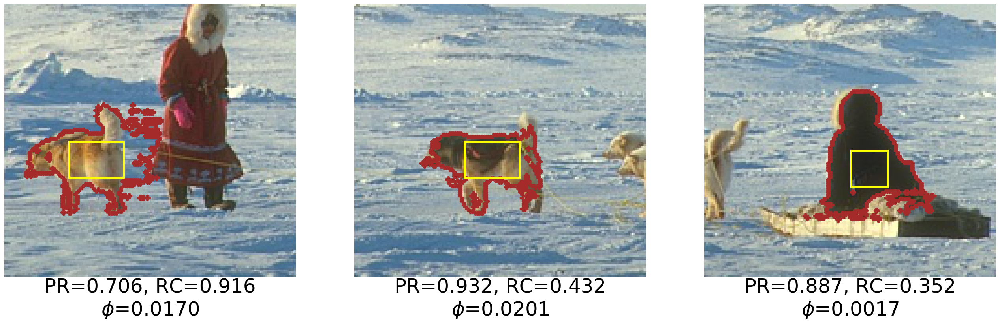

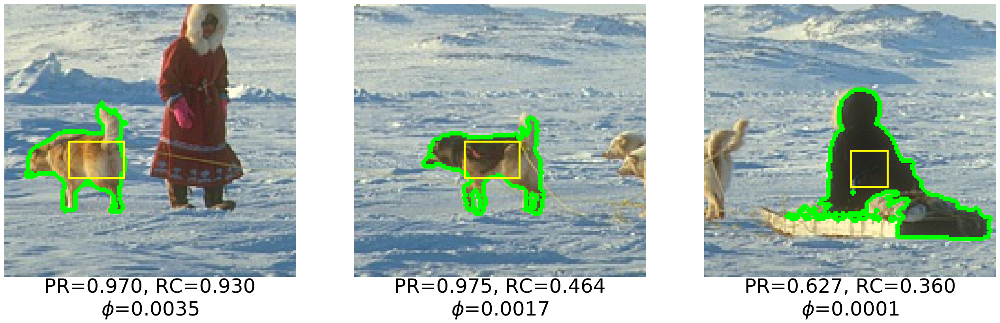

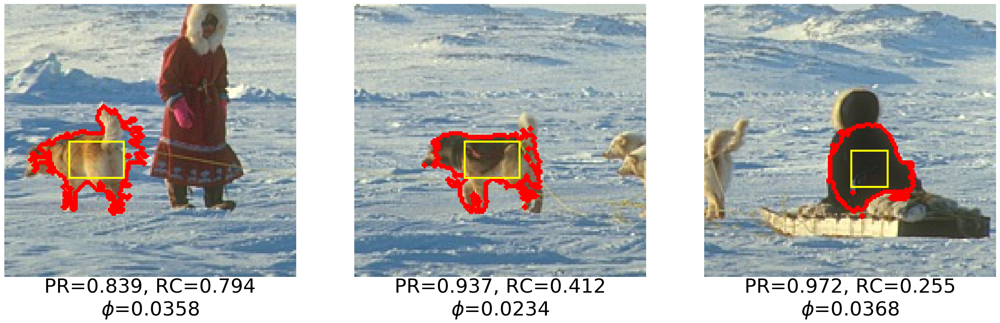

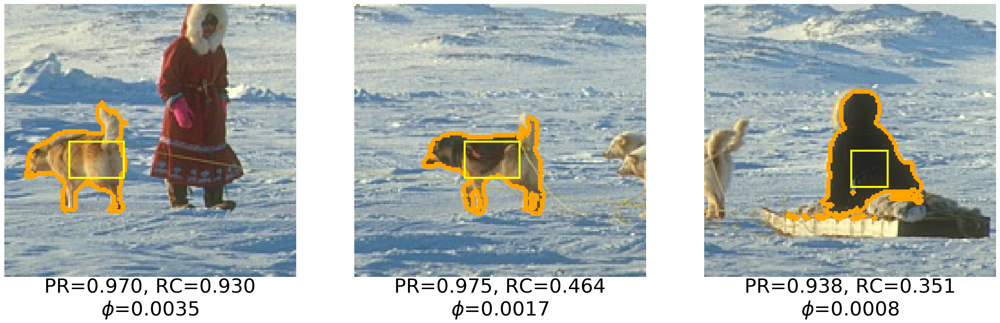

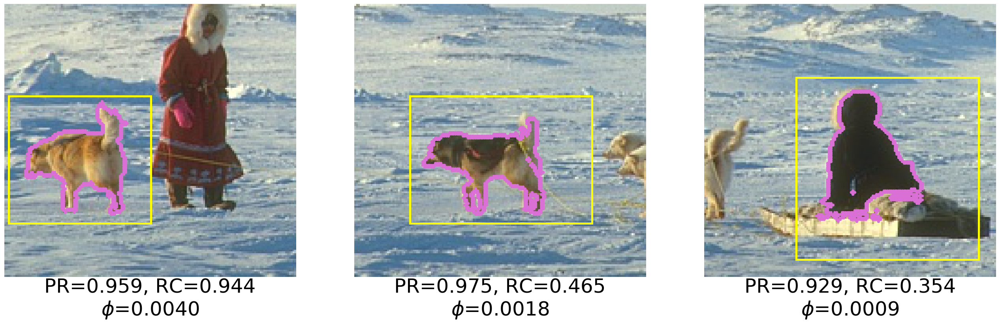

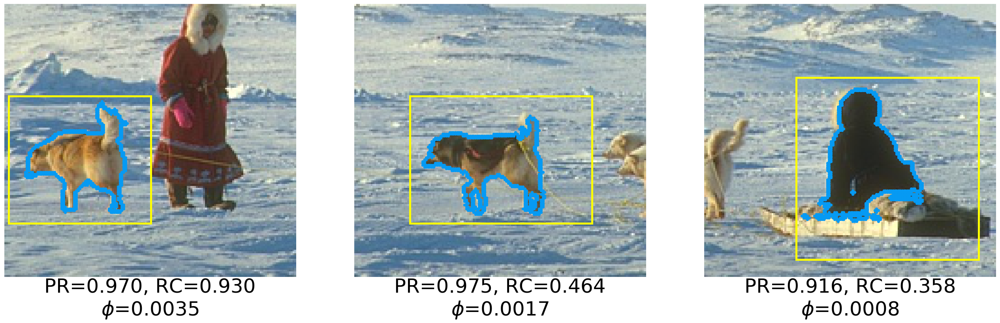

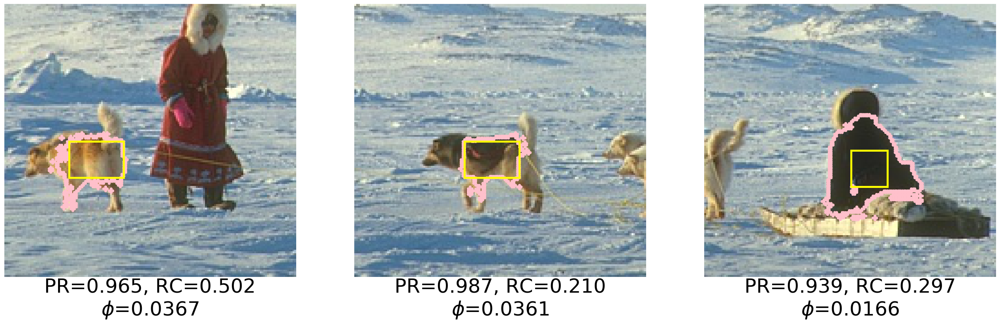

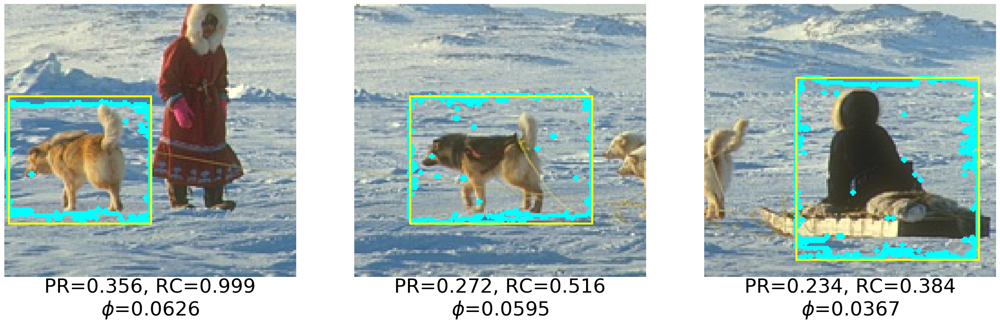

In [44]:
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec


figs = [plt.figure(figsize=(45,45)) for i in range(8)]

axes = []

for i in range(8):
    gs = GridSpec(1, 3,figure=figs[i])
    fig = figs[i]
    axes.append([])
    for j in range(3):
        ax = fig.add_subplot(gs[j])
        axes[i].append(ax)

colors = {"greedy_grow":"pink","greedy_shrink":"cyan","l1reg_small":"brown",
         "fi":"lime","l1reg_large":"red","sl":"orange","fiedler":"orchid","mqi":"xkcd:azure"}
methods = ["l1reg_small"]+["fi"]+["l1reg_large"]+["sl"]+["fiedler"]+["mqi"]+["greedy_grow"]+["greedy_shrink"]
for fi,fig in enumerate(figs):
    target_cluster = []
    for i,ax in enumerate(axes[fi]):
        if i == 0:
            target_name = "left_dog"
            whichlabel = 5
            groundtruth = np.where(labels_true == whichlabel)
            howmany = groundtruth[0].shape[0]
            xaxis = groundtruth[0]
            yaxis = groundtruth[1]
            for k in range(howmany):
                pixel = xaxis[k]*n + yaxis[k]
                target_cluster.append(pixel)
            curr_img = img[150:300,0:160]
            offset_x = 150
            offset_y = 0
            if fi in [0,1,2,3,6]:
                rect = patches.Rectangle((35,75),30,20,linewidth=5,edgecolor='yellow',facecolor='none')
            else:
                rect = patches.Rectangle((2,50),78,70,linewidth=5,edgecolor='yellow',facecolor='none')
        elif i == 1:
            target_name = "middle_dog"
            whichlabel = 6
            groundtruth = np.where(labels_true == whichlabel)
            howmany = groundtruth[0].shape[0]
            xaxis = groundtruth[0]
            yaxis = groundtruth[1]
            for k in range(howmany):
                pixel = xaxis[k]*n + yaxis[k]
                target_cluster.append(pixel)
            curr_img = img[150:300,140:300]
            offset_x = 150
            offset_y = 140
            if fi in [0,1,2,3,6]:
                rect = patches.Rectangle((60,75),30,20,linewidth=5,edgecolor='yellow',facecolor='none')
            else:
                rect = patches.Rectangle((30,50),100,70,linewidth=5,edgecolor='yellow',facecolor='none')
        else:
            target_name = "right_person"
            whichlabel = 4
            groundtruth = np.where(labels_true == whichlabel)
            howmany = groundtruth[0].shape[0]
            xaxis = groundtruth[0]
            yaxis = groundtruth[1]
            for k in range(howmany):
                pixel = xaxis[k]*n + yaxis[k]
                target_cluster.append(pixel)
            curr_img = img[150:300,320:480]
            offset_x = 150
            offset_y = 320
            if fi in [0,1,2,3,6]:
                rect = patches.Rectangle((80,80),20,20,linewidth=5,edgecolor='yellow',facecolor='none')
            else:
                rect = patches.Rectangle((50,40),100,100,linewidth=5,edgecolor='yellow',facecolor='none')
        method_name = methods[fi]
        output = output_all[target_name][method_name]
        temp = np.zeros(n_pixels)
        temp[output[0]] = 1
        PR = len(set(output[0]).intersection(target_cluster))*1.0/len(output[0])
        RC = len(set(output[0]).intersection(target_cluster))*1.0/len(target_cluster)
        fig.axes[i].set_xlabel("PR={:.{}f}".format(PR,3)+", RC={:.{}f}\n".format(RC,3)+r"$\phi$={:.{}f}".format(output[1],4),
                         fontsize=50)
        x,y = np.nonzero(find_boundaries(temp.reshape((m,n))))
        filtered_indices = np.nonzero(x<=480)[0]
        x = x[filtered_indices]
        y = y[filtered_indices]
        ax.scatter(y-offset_y,x-offset_x,s=40,color=colors[method_name]) 
        ax.add_patch(rect)
        ax.imshow(curr_img)
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)
        ax.spines['bottom'].set_visible(False)
        ax.spines['left'].set_visible(False)
        ax.set_yticks([])
        ax.set_xticks([])
    

plt.show()

for fi,fig in enumerate(figs):
    fig.savefig("image_segmentation_"+methods[fi]+".pdf",format='pdf',bbox_inches='tight')

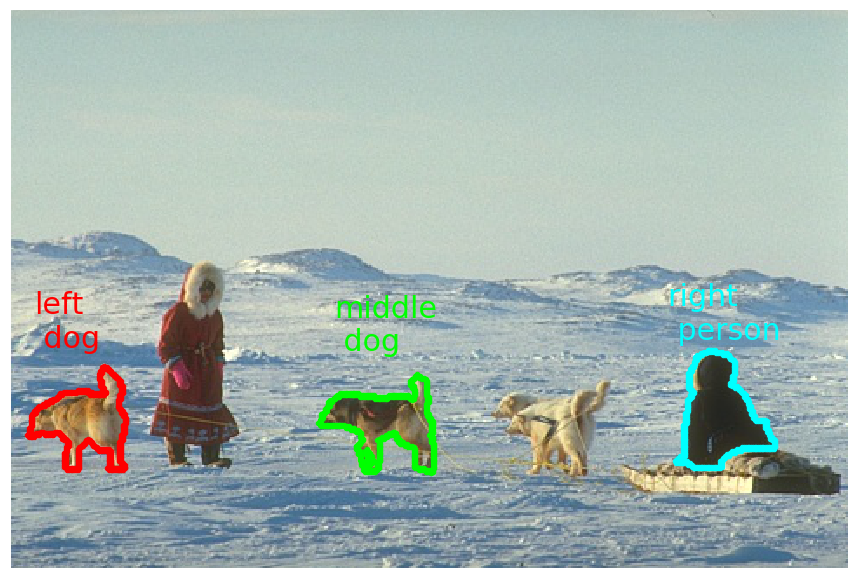

In [54]:
fig = plt.figure(figsize=(15,15))
ax = fig.subplots()
plot_targets(ax,img)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.set_yticks([])
ax.set_xticks([])
fig.savefig("image_segmentation_targets.pdf",format='pdf',bbox_inches='tight')

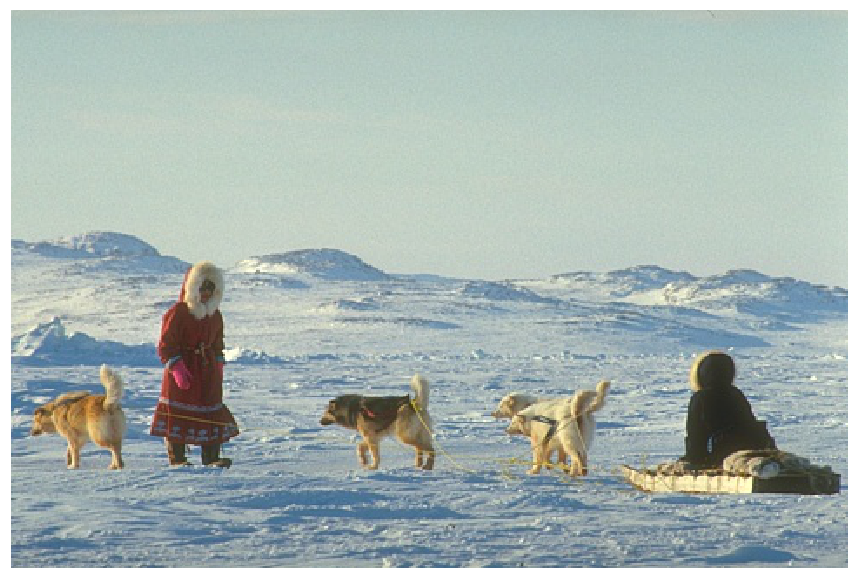

In [55]:
fig = plt.figure(figsize=(15,15))
ax = fig.subplots()
ax.imshow(img)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.set_yticks([])
ax.set_xticks([])
fig.savefig("image_segmentation_original.pdf",format='pdf',bbox_inches='tight')

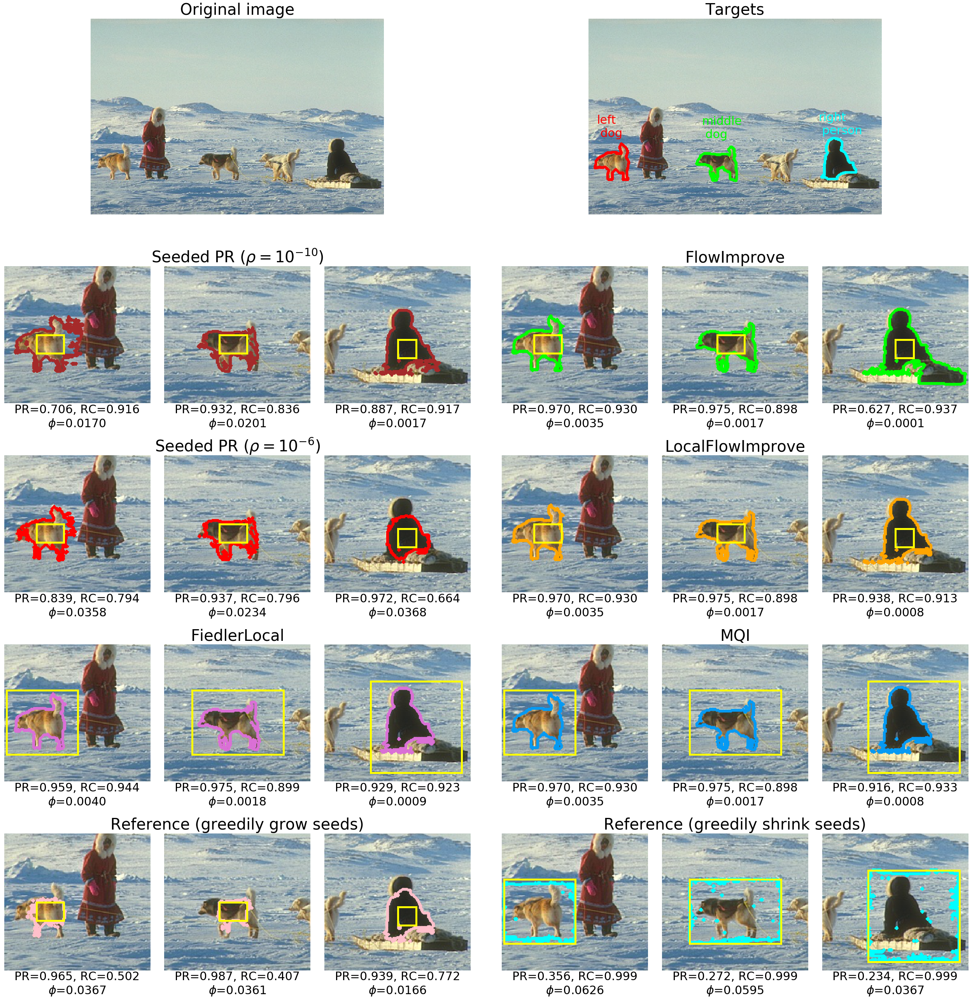

In [33]:
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec


fig = plt.figure(figsize=(45,45))

gs = GridSpec(5, 7,figure=fig,height_ratios=[1]+[0.7]*4,width_ratios=[1,1,1,0.1,1,1,1],hspace=0.35,wspace=0.01)

ax1 = fig.add_subplot(gs[0, 0:3])
ax2 = fig.add_subplot(gs[0, 4:7])

axes = [[ax1,ax2]]

for i in range(1,5):
    axes.append([])
    for j in range(7):
        if j == 3:
            continue
        ax = fig.add_subplot(gs[i,j])
        axes[i].append(ax)

colors = {"greedy_grow":"pink","greedy_shrink":"cyan","l1reg_small":"brown",
         "fi":"lime","l1reg_large":"red","sl":"orange","fiedler":"orchid","mqi":"xkcd:azure"}
methods = ["l1reg_small"]*3+["fi"]*3+["l1reg_large"]*3+["sl"]*3+["fiedler"]*3+["mqi"]*3+["greedy_grow"]*3+["greedy_shrink"]*3
for i,ax in enumerate(fig.axes):
    target_cluster = []
    if i in [2,5,8,11,14,17,20,23]:
        target_name = "left_dog"
        whichlabel = 5
        groundtruth = np.where(labels_true == whichlabel)
        howmany = groundtruth[0].shape[0]
        xaxis = groundtruth[0]
        yaxis = groundtruth[1]
        for k in range(howmany):
            pixel = xaxis[k]*n + yaxis[k]
            target_cluster.append(pixel)
        curr_img = img[150:300,0:160]
        offset_x = 150
        offset_y = 0
        if i in [2,5,8,11,20]:
            rect = patches.Rectangle((35,75),30,20,linewidth=5,edgecolor='yellow',facecolor='none')
        else:
            rect = patches.Rectangle((2,50),78,70,linewidth=5,edgecolor='yellow',facecolor='none')
    elif i in [3,6,9,12,15,18,21,24]:
        target_name = "middle_dog"
        whichlabel = 6
        groundtruth = np.where(labels_true == whichlabel)
        howmany = groundtruth[0].shape[0]
        xaxis = groundtruth[0]
        yaxis = groundtruth[1]
        for k in range(howmany):
            pixel = xaxis[k]*n + yaxis[k]
            target_cluster.append(pixel)
        curr_img = img[150:300,140:300]
        offset_x = 150
        offset_y = 140
        if i in [3,6,9,12,21]:
            rect = patches.Rectangle((60,75),30,20,linewidth=5,edgecolor='yellow',facecolor='none')
        else:
            rect = patches.Rectangle((30,50),100,70,linewidth=5,edgecolor='yellow',facecolor='none')
    elif i in [4,7,10,13,16,19,22,25]:
        target_name = "right_person"
        whichlabel = 4
        groundtruth = np.where(labels_true == whichlabel)
        howmany = groundtruth[0].shape[0]
        xaxis = groundtruth[0]
        yaxis = groundtruth[1]
        for k in range(howmany):
            pixel = xaxis[k]*n + yaxis[k]
            target_cluster.append(pixel)
        curr_img = img[150:300,320:480]
        offset_x = 150
        offset_y = 320
        if i in [4,7,10,13,22]:
            rect = patches.Rectangle((80,80),20,20,linewidth=5,edgecolor='yellow',facecolor='none')
        else:
            rect = patches.Rectangle((50,40),100,100,linewidth=5,edgecolor='yellow',facecolor='none')
    else:
        curr_img = img
    if i == 1:
        plot_targets(ax,curr_img)
    elif i != 0:
        method_name = methods[i-2]
        output = output_all[target_name][method_name]
        temp = np.zeros(n_pixels)
        temp[output[0]] = 1
        PR = len(set(output[0]).intersection(target_cluster))*1.0/len(output[0])
        RC = len(set(output[0]).intersection(target_cluster))*1.0/len(target_cluster)
        fig.axes[i].set_xlabel("PR={:.{}f}".format(PR,3)+", RC={:.{}f}\n".format(RC,3)+r"$\phi$={:.{}f}".format(output[1],4),
                         fontsize=30)
        x,y = np.nonzero(find_boundaries(temp.reshape((m,n))))
        filtered_indices = np.nonzero(x<=480)[0]
        x = x[filtered_indices]
        y = y[filtered_indices]
        ax.imshow(curr_img)
        ax.scatter(y-offset_y,x-offset_x,s=20,color=colors[method_name]) 
        ax.add_patch(rect)
    else:
        ax.imshow(curr_img)
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    ax.spines['left'].set_visible(False)
    ax.set_yticks([])
    ax.set_xticks([])

fig.axes[0].set_title("Original image",fontsize=40,pad=10)
fig.axes[1].set_title("Targets",fontsize=40,pad=10)
fig.axes[3].set_title(r"Seeded PR ($\rho = 10^{-10}$)",fontsize=40,pad=10)
fig.axes[6].set_title("FlowImprove",fontsize=40,pad=10)
fig.axes[9].set_title(r"Seeded PR ($\rho = 10^{-6}$)",fontsize=40,pad=10)
fig.axes[12].set_title("LocalFlowImprove",fontsize=40,pad=10)
fig.axes[15].set_title("FiedlerLocal",fontsize=40,pad=10)
fig.axes[18].set_title("MQI",fontsize=40,pad=10)
fig.axes[21].set_title("Reference (greedily grow seeds)",fontsize=40,pad=10)
fig.axes[24].set_title("Reference (greedily shrink seeds)",fontsize=40,pad=10)
    

plt.show()

fig.savefig("image_segmentation.pdf",format='pdf',bbox_inches='tight')

In [ ]:
import pickle

rptr = open("input_all1.p","rb")
input_all = pickle.load(rptr)
rptr.close()

rptr = open("output_all1.p","rb")
output_all = pickle.load(rptr)
rptr.close()

In [29]:
import pickle

wptr = open("input_all1.p","wb")
pickle.dump(input_all,wptr)
wptr.close()

wptr = open("output_all1.p","wb")
pickle.dump(output_all,wptr)
wptr.close()

In [ ]:
f = plt.figure(figsize=(6, 6))
ax = f.add_subplot(111)

x = [1,2,3,4,5,8,9,10,11,12,15,16,17,18,19]
y = pr_all[0,1::]
ax.bar(x,y)
ax.plot([0,20],[pr_all[0,0],pr_all[0,0]],linestyle="--")

plt.show()

f = plt.figure(figsize=(6, 6))
ax = f.add_subplot(111)

x = [1,2,3,4,5,8,9,10,11,12,15,16,17,18,19]
y = pr_all[1,1::]
ax.bar(x,y)
ax.plot([0,20],[pr_all[1,0],pr_all[1,0]],linestyle="--")

plt.show()

f = plt.figure(figsize=(6, 6))
ax = f.add_subplot(111)

x = [1,2,3,4,5,8,9,10,11,12,15,16,17,18,19]
y = pr_all[2,1::]
ax.bar(x,y)
ax.plot([0,20],[pr_all[2,0],pr_all[2,0]],linestyle="--")

plt.show()

In [ ]:
f = plt.figure(figsize=(6, 6))
ax = f.add_subplot(111)

x = [1,2,3,4,5,8,9,10,11,12,15,16,17,18,19]
y = rc_all[0,1::]
ax.bar(x,y)
ax.plot([0,20],[rc_all[0,0],rc_all[0,0]],linestyle="--")

plt.show()

f = plt.figure(figsize=(6, 6))
ax = f.add_subplot(111)

x = [1,2,3,4,5,8,9,10,11,12,15,16,17,18,19]
y = rc_all[1,1::]
ax.bar(x,y)
ax.plot([0,20],[rc_all[1,0],rc_all[1,0]],linestyle="--")

plt.show()

f = plt.figure(figsize=(6, 6))
ax = f.add_subplot(111)

x = [1,2,3,4,5,8,9,10,11,12,15,16,17,18,19]
y = rc_all[2,1::]
ax.bar(x,y)
ax.plot([0,20],[rc_all[2,0],rc_all[2,0]],linestyle="--")

plt.show()

## JH, groundtruth 

In [ ]:
g = GraphLocal('../datasets/JohnsHopkins.graphml','graphml')

g_nx = nx.read_graphml('../datasets/JohnsHopkins.graphml')

target_cluster = []
counter = 0
for node in g_nx.nodes():
    if g_nx.node[node]['year'] == 2009.0:
        target_cluster.append(counter)
    counter += 1
    
target_cluster2 = []
counter = 0
for node in g_nx.nodes():
    if g_nx.node[node]['majorIndex'] == 217.0:
        target_cluster2.append(counter)
    counter += 1
    
ld_coord = np.loadtxt('../datasets/JohnHopkins_coord.xy', dtype = 'Float64')
idx = np.argsort(ld_coord[:,0])
pos = np.zeros((g._num_vertices,2))
for i in range(g._num_vertices):
    pos[i] = ld_coord[idx[i],1:3]
    
node_colors = ['black' for i in range(g._num_vertices)]
for i in target_cluster:
    node_colors[i] = 'red'
for i in target_cluster2:
    node_colors[i] = 'blue'

temp = np.ones(g._num_vertices)
temp[target_cluster] = 4
temp[target_cluster2] = 4

nodesize_list = 50*np.ones(g._num_vertices)
nodesize_list[target_cluster] = 90
nodesize_list[target_cluster2] = 90

nodemarker_list = ['o'] * g._num_vertices
for i in target_cluster:
    nodemarker_list[i] = 's'
for i in target_cluster2:
    nodemarker_list[i] = 'D'
    
nodeorder_list = [1 for i in range(g._num_vertices)]
for i in target_cluster:
    nodeorder_list[i] = 2
for i in target_cluster2:
    nodeorder_list[i] = 3

drawing = g.draw_groups(pos,temp,figsize=(30,15),edgealpha=0.003,node_color_list=node_colors,nodesize_list=nodesize_list,nodemarker_list=nodemarker_list,nodeorder_list=nodeorder_list)

drawing.fig.text(0.15, 0.65, 'majorIndex 217', fontsize=50, color='blue')
drawing.fig.text(0.5, 0.85, 'year 2009', fontsize=50, color='red')

drawing.fig.savefig('/Users/kimonfountoulakis/Desktop/BoxSync/University/Waterloo/assistantProfessor/papers/reviewPaperOnFlowAlgorithms/figures/jh_targetclusters.png', format='png',bbox_inches='tight')

## JH graph, year 2009

In [ ]:
g = GraphLocal('../datasets/JohnsHopkins.graphml','graphml')

g_nx = nx.read_graphml('../datasets/JohnsHopkins.graphml')

target_cluster = []
counter = 0
for node in g_nx.nodes():
    if g_nx.node[node]['year'] == 2009.0:
        target_cluster.append(counter)
    counter += 1
    
ld_coord = np.loadtxt('../datasets/JohnHopkins_coord.xy', dtype = 'Float64')
idx = np.argsort(ld_coord[:,0])
pos = np.zeros((g._num_vertices,2))
for i in range(g._num_vertices):
    pos[i] = ld_coord[idx[i],1:3]

# Set teleportation parameter
alpha = g.compute_conductance(target_cluster)**2

# Set reference node for algorithm
ref_node = target_cluster[0]

d = g.d
n = g._num_vertices

# Stagewise algorithm
start = time.time()

Conductance = []
TPR = []
FPR = []
FDR = []
Pos_Size = []
F1score = []
Precision = []
Recall = []

Conductance_sl = []
TPR_sl = []
FPR_sl = []
FDR_sl = []
Pos_Size_sl = []
F1score_sl = []
Precision_sl = []
Recall_sl = []

vol_G = np.sum(g.d)

rho_list = list(np.geomspace(1.0e-4, 1.0e-18, 200, endpoint=True))

cardinalities = []

counter = 1

for rho in rho_list:

    output = approximate_PageRank(g,ref_node,method='l1reg-rand',alpha=alpha,rho=rho,normalize=False,normalized_objective=False,epsilon=1.0e-10,iterations=1000000,cpp=True)
    recovered_cluster = output[0]
        
    recovered_cluster_sweep = recovered_cluster #sweep_cut(g,(output[0],output[1]))[0]
    
    cardinalities.append(len(recovered_cluster))

    output_sl = flow_clustering(g,recovered_cluster_sweep,method="sl", delta=0.0001)[0]

    conductance = g.compute_conductance(recovered_cluster_sweep)
    Conductance.append(conductance)

    conductance = g.compute_conductance(output_sl)
    Conductance_sl.append(conductance)

    true_pos = np.intersect1d(recovered_cluster_sweep, target_cluster)
    true_pos_rate = len(true_pos)/len(target_cluster)

    true_pos_sl = np.intersect1d(output_sl, target_cluster)
    true_pos_rate_sl = len(true_pos_sl)/len(target_cluster)

    false_pos = np.setdiff1d(recovered_cluster_sweep, target_cluster)
    if len(recovered_cluster_sweep) == 0:
        false_disc_rate = len(false_pos)
    else:
        false_disc_rate = len(false_pos)/len(recovered_cluster_sweep)
    false_pos_rate = len(false_pos)/(n-len(target_cluster))

    false_pos_sl = np.setdiff1d(output_sl, target_cluster)
    if len(output_sl) == 0:
        false_disc_rate_sl = len(false_pos_sl)
    else:
        false_disc_rate_sl = len(false_pos_sl)/len(output_sl)
    false_pos_rate_sl = len(false_pos_sl)/(n-len(target_cluster))

    TPR.append(true_pos_rate)
    FDR.append(false_disc_rate)
    FPR.append(false_pos_rate)
    Pos_Size.append(len(recovered_cluster_sweep)) 
    temp = np.zeros(n)
    temp[recovered_cluster_sweep] = 1
    temp2 = np.zeros(n)
    temp2[target_cluster] = 1
    F1score.append(f1_score(temp2,temp))
    Precision.append(precision_score(temp2,temp))
    Recall.append(recall_score(temp2,temp))

    TPR_sl.append(true_pos_rate_sl)
    FDR_sl.append(false_disc_rate_sl)
    FPR_sl.append(false_pos_rate_sl)
    Pos_Size_sl.append(len(output_sl))   
    temp = np.zeros(n)
    temp[output_sl] = 1
    temp2 = np.zeros(n)
    temp2[target_cluster] = 1
    F1score_sl.append(f1_score(temp2,temp))
    Precision_sl.append(precision_score(temp2,temp))
    Recall_sl.append(recall_score(temp2,temp))
    
    if counter == 20:
        store_spectral = recovered_cluster_sweep
        store_sl = output_sl
        
    if true_pos_rate >0.9999999:
        break
        
    if np.sum(g.d[recovered_cluster]) > g.vol_G/2:
        break
    
    counter += 1

end = time.time()

# Plot results
f = plt.figure(figsize=(13, 10))

plt.plot(cardinalities, F1score, 'k', color='#0000A1', marker="s",markersize=10,linewidth=5)
plt.plot(cardinalities, F1score_sl, 'k', color='#934600', marker="^",markersize=10,linewidth=5)
plt.axvline(x=len(target_cluster),linestyle='--',color='black',linewidth=4)

plt.legend(['F1_score $\ell_1$-reg. PR', 'F1_score SimpleLocal'], loc='lower right', fancybox=True, shadow=True ,fontsize=25)

plt.xlabel('Nodes added', fontsize=25)

plt.xticks(fontsize=23)
plt.yticks(fontsize=23)

plt.show()

f.savefig('/Users/kimonfountoulakis/Desktop/BoxSync/University/Waterloo/assistantProfessor/papers/reviewPaperOnFlowAlgorithms/figures/jh_f1score_sl_plots_2009.pdf', format='pdf',bbox_inches='tight')

f = plt.figure(figsize=(13, 10))

plt.plot(cardinalities, Precision, 'k', color='#BE0000', marker="s",markersize=10,linewidth=5)
plt.plot(cardinalities, Precision_sl, 'k', color='#00D1FF', marker="^",markersize=10,linewidth=5)
plt.axvline(x=len(target_cluster),linestyle='--',color='black',linewidth=4)

plt.legend(['Precision $\ell_1$-reg. PR', 'Precision SimpleLocal'], loc='lower right', fancybox=True, shadow=True ,fontsize=25)

plt.xlabel('Nodes added', fontsize=25)

plt.xticks(fontsize=23)
plt.yticks(fontsize=23)

plt.show()

f.savefig('/Users/kimonfountoulakis/Desktop/BoxSync/University/Waterloo/assistantProfessor/papers/reviewPaperOnFlowAlgorithms/figures/jh_precision_sl_plots_2009.pdf', format='pdf',bbox_inches='tight')

f = plt.figure(figsize=(13, 10))

plt.plot(cardinalities, Recall, 'k', color='#006C00', marker="s",markersize=10,linewidth=5)
plt.plot(cardinalities, Recall_sl, 'k', color='#9400FF', marker="^",markersize=10,linewidth=5)
plt.axvline(x=len(target_cluster),linestyle='--',color='black',linewidth=4)

plt.legend(['Recall $\ell_1$-reg. PR', 'Recall SimpleLocal'], loc='lower right', fancybox=True, shadow=True ,fontsize=25)

plt.xlabel('Nodes added', fontsize=25)

plt.xticks(fontsize=23)
plt.yticks(fontsize=23)

plt.show()

f.savefig('/Users/kimonfountoulakis/Desktop/BoxSync/University/Waterloo/assistantProfessor/papers/reviewPaperOnFlowAlgorithms/figures/jh_recall_sl_plots_2009.pdf', format='pdf',bbox_inches='tight')

store_spectral = store_spectral[0:int(len(store_spectral)/4)]

temp = np.ones(g._num_vertices)
temp[store_spectral] = 2

node_colors = ['black' for i in range(g._num_vertices)]
for i in store_spectral:
    node_colors[i] = 'red'

nodesize_list = 50*np.ones(g._num_vertices)
nodesize_list[store_spectral] = 90

nodemarker_list = ['o'] * g._num_vertices
for i in store_spectral:
    nodemarker_list[i] = 's'
    
nodeorder_list = [1 for i in range(g._num_vertices)]
for i in store_spectral:
    nodeorder_list[i] = 2

drawing = g.draw_groups(pos,temp,figsize=(30,15),edgealpha=0.003,node_color_list=node_colors,nodesize_list=nodesize_list,nodemarker_list=nodemarker_list,nodeorder_list=nodeorder_list)

drawing.fig.savefig('/Users/kimonfountoulakis/Desktop/BoxSync/University/Waterloo/assistantProfessor/papers/reviewPaperOnFlowAlgorithms/figures/jh_input_sl_2009.png', format='png',bbox_inches='tight')

output_sl = flow_clustering(g,store_spectral,method="sl", delta=0.0001)[0]

node_colors = ['black' for i in range(g._num_vertices)]
for i in output_sl:
    node_colors[i] = 'red'

temp = np.ones(g._num_vertices)
temp[output_sl] = 4

nodesize_list = 50*np.ones(g._num_vertices)
nodesize_list[output_sl] = 90

nodemarker_list = ['o'] * g._num_vertices
for i in output_sl:
    nodemarker_list[i] = 's'
    
nodeorder_list = [1 for i in range(g._num_vertices)]
for i in output_sl:
    nodeorder_list[i] = 2

drawing = g.draw_groups(pos,temp,figsize=(30,15),edgealpha=0.003,node_color_list=node_colors,nodesize_list=nodesize_list,nodemarker_list=nodemarker_list)

drawing.fig.savefig('/Users/kimonfountoulakis/Desktop/BoxSync/University/Waterloo/assistantProfessor/papers/reviewPaperOnFlowAlgorithms/figures/jh_sl_2009.png', format='png',bbox_inches='tight',nodeorder_list=nodeorder_list)

## JH, majorIndex 217

In [ ]:
g = GraphLocal('../datasets/JohnsHopkins.graphml','graphml')

g_nx = nx.read_graphml('../datasets/JohnsHopkins.graphml')

target_cluster = []
counter = 0
for node in g_nx.nodes():
    if g_nx.node[node]['majorIndex'] == 217.0:
        target_cluster.append(counter)
    counter += 1
    
ld_coord = np.loadtxt('../datasets/JohnHopkins_coord.xy', dtype = 'Float64')
idx = np.argsort(ld_coord[:,0])
pos = np.zeros((g._num_vertices,2))
for i in range(g._num_vertices):
    pos[i] = ld_coord[idx[i],1:3]

# Set teleportation parameter
alpha = g.compute_conductance(target_cluster)**2

# Set reference node for algorithm
ref_node = target_cluster[0]

d = g.d
n = g._num_vertices

# Stagewise algorithm
start = time.time()

Conductance = []
TPR = []
FPR = []
FDR = []
Pos_Size = []
F1score = []
Precision = []
Recall = []

Conductance_sl = []
TPR_sl = []
FPR_sl = []
FDR_sl = []
Pos_Size_sl = []
F1score_sl = []
Precision_sl = []
Recall_sl = []

vol_G = np.sum(g.d)

rho_list = list(np.geomspace(1.0e-4, 1.0e-18, 200, endpoint=True))

cardinalities = []

counter = 1

for rho in rho_list:

    output = approximate_PageRank(g,ref_node,method='l1reg-rand',alpha=alpha,rho=rho,normalize=False,normalized_objective=False,epsilon=1.0e-10,iterations=1000000,cpp=True)
    recovered_cluster = output[0]
        
    recovered_cluster_sweep = recovered_cluster #sweep_cut(g,(output[0],output[1]))[0]
    
    cardinalities.append(len(recovered_cluster))

    output_sl = flow_clustering(g,recovered_cluster_sweep,method="sl", delta=0.000)[0]

    conductance = g.compute_conductance(recovered_cluster_sweep)
    Conductance.append(conductance)

    conductance = g.compute_conductance(output_sl)
    Conductance_sl.append(conductance)

    true_pos = np.intersect1d(recovered_cluster_sweep, target_cluster)
    true_pos_rate = len(true_pos)/len(target_cluster)

    true_pos_sl = np.intersect1d(output_sl, target_cluster)
    true_pos_rate_sl = len(true_pos_sl)/len(target_cluster)

    false_pos = np.setdiff1d(recovered_cluster_sweep, target_cluster)
    if len(recovered_cluster_sweep) == 0:
        false_disc_rate = len(false_pos)
    else:
        false_disc_rate = len(false_pos)/len(recovered_cluster_sweep)
    false_pos_rate = len(false_pos)/(n-len(target_cluster))

    false_pos_sl = np.setdiff1d(output_sl, target_cluster)
    if len(output_sl) == 0:
        false_disc_rate_sl = len(false_pos_sl)
    else:
        false_disc_rate_sl = len(false_pos_sl)/len(output_sl)
    false_pos_rate_sl = len(false_pos_sl)/(n-len(target_cluster))

    TPR.append(true_pos_rate)
    FDR.append(false_disc_rate)
    FPR.append(false_pos_rate)
    Pos_Size.append(len(recovered_cluster_sweep)) 
    temp = np.zeros(n)
    temp[recovered_cluster_sweep] = 1
    temp2 = np.zeros(n)
    temp2[target_cluster] = 1
    F1score.append(f1_score(temp2,temp))
    Precision.append(precision_score(temp2,temp))
    Recall.append(recall_score(temp2,temp))

    TPR_sl.append(true_pos_rate_sl)
    FDR_sl.append(false_disc_rate_sl)
    FPR_sl.append(false_pos_rate_sl)
    Pos_Size_sl.append(len(output_sl))   
    temp = np.zeros(n)
    temp[output_sl] = 1
    temp2 = np.zeros(n)
    temp2[target_cluster] = 1
    F1score_sl.append(f1_score(temp2,temp))
    Precision_sl.append(precision_score(temp2,temp))
    Recall_sl.append(recall_score(temp2,temp))
    
    if counter == 10:
        store_spectral = recovered_cluster_sweep
        store_sl = output_sl
        
    if true_pos_rate >0.9999999:
        break
        
    if np.sum(g.d[recovered_cluster]) > g.vol_G/2:
        break
    
    counter += 1

end = time.time()

# Plot results
f = plt.figure(figsize=(13, 10))

plt.plot(cardinalities, F1score, 'k', color='#0000A1', marker="s",markersize=10,linewidth=5)
plt.plot(cardinalities, F1score_sl, 'k', color='#934600', marker="^",markersize=10,linewidth=5)
plt.axvline(x=len(target_cluster),linestyle='--',color='black',linewidth=4)

plt.legend(['F1_score $\ell_1$-reg. PR', 'F1_score SimpleLocal'], loc='lower right', fancybox=True, shadow=True ,fontsize=25)

plt.xlabel('Nodes added', fontsize=25)

plt.xticks(fontsize=23)
plt.yticks(fontsize=23)

plt.show()

f.savefig('/Users/kimonfountoulakis/Desktop/BoxSync/University/Waterloo/assistantProfessor/papers/reviewPaperOnFlowAlgorithms/figures/jh_f1score_sl_plots_217.pdf', format='pdf',bbox_inches='tight')

f = plt.figure(figsize=(13, 10))

plt.plot(cardinalities, Precision, 'k', color='#BE0000', marker="s",markersize=10,linewidth=5)
plt.plot(cardinalities, Precision_sl, 'k', color='#00D1FF', marker="^",markersize=10,linewidth=5)
plt.axvline(x=len(target_cluster),linestyle='--',color='black',linewidth=4)

plt.legend(['Precision $\ell_1$-reg. PR', 'Precision SimpleLocal'], loc='lower right', fancybox=True, shadow=True ,fontsize=25)

plt.xlabel('Nodes added', fontsize=25)

plt.xticks(fontsize=23)
plt.yticks(fontsize=23)

plt.show()

f.savefig('/Users/kimonfountoulakis/Desktop/BoxSync/University/Waterloo/assistantProfessor/papers/reviewPaperOnFlowAlgorithms/figures/jh_precision_sl_plots_217.pdf', format='pdf',bbox_inches='tight')

f = plt.figure(figsize=(13, 10))

plt.plot(cardinalities, Recall, 'k', color='#006C00', marker="s",markersize=10,linewidth=5)
plt.plot(cardinalities, Recall_sl, 'k', color='#9400FF', marker="^",markersize=10,linewidth=5)
plt.axvline(x=len(target_cluster),linestyle='--',color='black',linewidth=4)

plt.legend(['Recall $\ell_1$-reg. PR', 'Recall SimpleLocal'], loc='lower right', fancybox=True, shadow=True ,fontsize=25)

plt.xlabel('Nodes added', fontsize=25)

plt.xticks(fontsize=23)
plt.yticks(fontsize=23)

plt.show()

f.savefig('/Users/kimonfountoulakis/Desktop/BoxSync/University/Waterloo/assistantProfessor/papers/reviewPaperOnFlowAlgorithms/figures/jh_recall_sl_plots_217.pdf', format='pdf',bbox_inches='tight')

store_spectral = store_spectral[0:int(len(store_spectral)/5)]

temp = np.ones(g._num_vertices)
temp[store_spectral] = 2

node_colors = ['black' for i in range(g._num_vertices)]
for i in store_spectral:
    node_colors[i] = 'blue'

nodesize_list = 50*np.ones(g._num_vertices)
nodesize_list[store_spectral] = 90

nodemarker_list = ['o'] * g._num_vertices
for i in store_spectral:
    nodemarker_list[i] = 's'
    
nodeorder_list = [1 for i in range(g._num_vertices)]
for i in store_spectral:
    nodeorder_list[i] = 2

drawing = g.draw_groups(pos,temp,figsize=(30,15),edgealpha=0.003,node_color_list=node_colors,nodesize_list=nodesize_list,nodemarker_list=nodemarker_list,nodeorder_list=nodeorder_list)

drawing.fig.savefig('/Users/kimonfountoulakis/Desktop/BoxSync/University/Waterloo/assistantProfessor/papers/reviewPaperOnFlowAlgorithms/figures/jh_input_sl_217.png', format='png',bbox_inches='tight')

output_sl = flow_clustering(g,store_spectral,method="sl", delta=0.0001)[0]

node_colors = ['black' for i in range(g._num_vertices)]
for i in output_sl:
    node_colors[i] = 'blue'

temp = np.ones(g._num_vertices)
temp[output_sl] = 4

nodesize_list = 50*np.ones(g._num_vertices)
nodesize_list[output_sl] = 90

nodemarker_list = ['o'] * g._num_vertices
for i in output_sl:
    nodemarker_list[i] = 's'
    
nodeorder_list = [1 for i in range(g._num_vertices)]
for i in output_sl:
    nodeorder_list[i] = 2

drawing = g.draw_groups(pos,temp,figsize=(30,15),edgealpha=0.003,node_color_list=node_colors,nodesize_list=nodesize_list,nodemarker_list=nodemarker_list)

drawing.fig.savefig('/Users/kimonfountoulakis/Desktop/BoxSync/University/Waterloo/assistantProfessor/papers/reviewPaperOnFlowAlgorithms/figures/jh_sl_217.png', format='png',bbox_inches='tight',nodeorder_list=nodeorder_list)

## Synthetic graphs, 20 nodes in cluster

In [ ]:
number_of_clusters = 10
number_of_large_clusters = 0
k = 20
sizes = []
for i in range(number_of_clusters):
    sizes.append(k)
n = np.sum(sizes)
        
p = 0.5

q_list = list(np.geomspace(1/n, 0.25, 10, endpoint=True))

trials = 30

alpha = 0.1

counter = 0

best_median = np.zeros(len(q_list))
best_median_sl = np.zeros(len(q_list))
best_perc20 = np.zeros(len(q_list))
best_perc80 = np.zeros(len(q_list))
best_perc20_sl = np.zeros(len(q_list))
best_perc80_sl = np.zeros(len(q_list))

best_median_precision = np.zeros(len(q_list))
best_median_precision_sl = np.zeros(len(q_list))
best_perc20_precision = np.zeros(len(q_list))
best_perc80_precision = np.zeros(len(q_list))
best_perc20_precision_sl = np.zeros(len(q_list))
best_perc80_precision_sl = np.zeros(len(q_list))

best_median_recall = np.zeros(len(q_list))
best_median_recall_sl = np.zeros(len(q_list))
best_perc20_recall = np.zeros(len(q_list))
best_perc80_recall = np.zeros(len(q_list))
best_perc20_recall_sl = np.zeros(len(q_list))
best_perc80_recall_sl = np.zeros(len(q_list))

for q in q_list:
    
    TPR2s_trial = []
    FDR2s_trial = []
    conductance_trial = []
    F1score_trial = []
    Precision_trial = []
    Recall_trial = []
    
    TPR2s_trial_sl = []
    FDR2s_trial_sl = []
    conductance_trial_sl = []
    F1score_trial_sl = []
    Precision_trial_sl = []
    Recall_trial_sl = []

    for trial in range(trials):

        probs = q * np.ones((number_of_clusters, number_of_clusters)) + (p-q)* np.eye(number_of_clusters) 
        g = nx.generators.community.stochastic_block_model(sizes, probs)
        nx.write_edgelist(g, "sbm.edgelist",data=False)
        g2 = GraphLocal('sbm.edgelist','edgelist',' ') # what is edgelist
#         g2.is_disconnected()

        A = g2.adjacency_matrix
        d = np.array(A.sum(axis=1)).reshape(-1)
        D = sp.sparse.diags(d).tocsc()
        Dinv = sp.sparse.diags(1/d).tocsc()
        L = D - A
        Q = alpha * D + (1 - alpha) / 2 * L
        Dinv_Q = Dinv @ Q
        
        ref_node = 0
    
        seed = np.zeros(n)
        seed[ref_node] = 1.
        target_cluster = [x for x in range(ref_node-ref_node%k, ref_node-ref_node%k+k)]

        # Stagewise
        start = time.time()

        eta = 1.0e-4

        Conductance2 = []
        TPR2 = []
        FPR2 = []
        FDR2 = []
        Pos_Size2 = []
        F1score2 = []
        Precision2 = []
        Recall2 = []
        
        Conductance_sl2 = []
        TPR_sl2 = []
        FPR_sl2 = []
        FDR_sl2 = []
        Pos_Size_sl2 = []
        F1score_sl2 = []
        Precision_sl2 = []
        Recall_sl2 = []

        d_ref_node = d[ref_node]

        n_iter = 0
        x = np.zeros(n)

        l_old = 0

        for i in range(12000):

            x_old = x.copy()
            Dinv_grad = Dinv_Q @ x_old - alpha * seed/d_ref_node
            ind = np.argmin(Dinv_grad)
            x[ind] = x_old[ind] + eta/d[ind]

            recovered_cluster = list(np.where(x>0)[0])

            l_ = len(recovered_cluster)

            if l_ > l_old:

                l_old = l_
                
                idx = np.where(x>0)[0]
                recovered_cluster_sweep = recovered_cluster #sweep_cut(g2,(idx,x[idx]))[0]

                output_sl = flow_clustering(g2,recovered_cluster_sweep,method="sl",delta=15)[0]

                conductance = g2.compute_conductance(recovered_cluster_sweep)
                Conductance2.append(conductance)

                conductance = g2.compute_conductance(output_sl)
                Conductance_sl2.append(conductance)

                true_pos = np.intersect1d(recovered_cluster_sweep, target_cluster)
                true_pos_rate = len(true_pos)/len(target_cluster)

                true_pos_sl = np.intersect1d(output_sl, target_cluster)
                true_pos_rate_sl = len(true_pos_sl)/len(target_cluster)

                false_pos = np.setdiff1d(recovered_cluster_sweep, target_cluster)
                if len(recovered_cluster_sweep) == 0:
                    false_disc_rate = len(false_pos)
                else:
                    false_disc_rate = len(false_pos)/len(recovered_cluster_sweep)
                false_pos_rate = len(false_pos)/(n-len(target_cluster))

                false_pos_sl = np.setdiff1d(output_sl, target_cluster)
                if len(output_sl) == 0:
                    false_disc_rate_sl = len(false_pos_sl)
                else:
                    false_disc_rate_sl = len(false_pos_sl)/len(output_sl)
                false_pos_rate_sl = len(false_pos_sl)/(n-len(target_cluster))

                TPR2.append(true_pos_rate)
                FDR2.append(false_disc_rate)
                FPR2.append(false_pos_rate)
                Pos_Size2.append(len(recovered_cluster_sweep))   
                temp = np.zeros(n)
                temp[recovered_cluster_sweep] = 1
                temp2 = np.zeros(n)
                temp2[target_cluster] = 1
                F1score2.append(f1_score(temp2,temp))
                Precision2.append(precision_score(temp2,temp))
                Recall2.append(recall_score(temp2,temp))

                TPR_sl2.append(true_pos_rate_sl)
                FDR_sl2.append(false_disc_rate_sl)
                FPR_sl2.append(false_pos_rate_sl)
                Pos_Size_sl2.append(len(output_sl)) 
                temp = np.zeros(n)
                temp[output_sl] = 1
                temp2 = np.zeros(n)
                temp2[target_cluster] = 1
                F1score_sl2.append(f1_score(temp2,temp))
                Precision_sl2.append(precision_score(temp2,temp))
                Recall_sl2.append(recall_score(temp2,temp))

            n_iter += 1

        end = time.time()
    
        TPR2s_trial.append(TPR2)
        FDR2s_trial.append(FDR2)
        conductance_trial.append(Conductance2)
        F1score_trial.append(F1score2)
        Precision_trial.append(Precision2)
        Recall_trial.append(Recall2)
        
        TPR2s_trial_sl.append(TPR_sl2)
        FDR2s_trial_sl.append(FDR_sl2)
        conductance_trial_sl.append(Conductance_sl2)
        F1score_trial_sl.append(F1score_sl2)
        Precision_trial_sl.append(Precision_sl2)
        Recall_trial_sl.append(Recall_sl2)
    
    median_FDR = np.median(FDR2s_trial, axis=0)
    median_TPR = np.median(TPR2s_trial, axis=0)
    median_conductance = np.median(conductance_trial, axis=0)
    median_f1score = np.median(F1score_trial, axis=0)
    median_precision = np.median(Precision_trial, axis=0)
    median_recall = np.median(Recall_trial, axis=0)
    perc20_FDR = np.percentile(FDR2s_trial, q = 20, axis=0) #np.sqrt(np.var(FDR2s_trial, axis=0))
    perc20_TPR = np.percentile(TPR2s_trial, q=20, axis=0) #np.sqrt(np.var(TPR2s_trial, axis=0))
    perc20_conductance = np.percentile(conductance_trial, q=20, axis=0) # np.sqrt(np.var(conductance_trial, axis=0))
    perc20_f1score = np.percentile(F1score_trial, q=20, axis=0) # np.sqrt(np.var(F1score_trial, axis=0))
    perc20_precision = np.percentile(Precision_trial, q=20, axis=0) # np.sqrt(np.var(Precision_trial, axis=0))
    perc20_recall = np.percentile(Recall_trial, q=20, axis=0) # np.sqrt(np.var(Recall_trial, axis=0))
    perc80_FDR = np.percentile(FDR2s_trial, q = 80, axis=0) #np.sqrt(np.var(FDR2s_trial, axis=0))
    perc80_TPR = np.percentile(TPR2s_trial, q=80, axis=0) #np.sqrt(np.var(TPR2s_trial, axis=0))
    perc80_conductance = np.percentile(conductance_trial, q=80, axis=0) # np.sqrt(np.var(conductance_trial, axis=0))
    perc80_f1score = np.percentile(F1score_trial, q=80, axis=0) # np.sqrt(np.var(F1score_trial, axis=0))
    perc80_precision = np.percentile(Precision_trial, q=80, axis=0) # np.sqrt(np.var(Precision_trial, axis=0))
    perc80_recall = np.percentile(Recall_trial, q=80, axis=0) # np.sqrt(np.var(Recall_trial, axis=0))
    
    median_FDR_sl = np.median(FDR2s_trial_sl, axis=0)
    median_TPR_sl = np.median(TPR2s_trial_sl, axis=0)
    median_conductance_sl = np.median(conductance_trial_sl, axis=0)
    median_f1score_sl = np.median(F1score_trial_sl, axis=0)
    median_precision_sl = np.median(Precision_trial_sl, axis=0)
    median_recall_sl = np.median(Recall_trial_sl, axis=0)
    perc20_FDR_sl = np.percentile(FDR2s_trial_sl, q=20, axis=0) # np.sqrt(np.var(FDR2s_trial_sl, axis=0))
    perc20_TPR_sl = np.percentile(TPR2s_trial_sl, q=20, axis=0) # np.sqrt(np.var(TPR2s_trial_sl, axis=0))
    perc20_conductance_sl = np.percentile(conductance_trial_sl, q=20, axis=0) # np.sqrt(np.var(conductance_trial_sl, axis=0))
    perc20_f1score_sl = np.percentile(F1score_trial_sl, q=20, axis=0) # np.sqrt(np.var(F1score_trial_sl, axis=0))
    perc20_precision_sl = np.percentile(Precision_trial_sl, q=20, axis=0) # np.sqrt(np.var(Precision_trial_sl, axis=0))
    perc20_recall_sl = np.percentile(Recall_trial_sl, q=20, axis=0) # np.sqrt(np.var(Recall_trial_sl, axis=0))
    perc80_FDR_sl = np.percentile(FDR2s_trial_sl, q=80, axis=0) # np.sqrt(np.var(FDR2s_trial_sl, axis=0))
    perc80_TPR_sl = np.percentile(TPR2s_trial_sl, q=80, axis=0) # np.sqrt(np.var(TPR2s_trial_sl, axis=0))
    perc80_conductance_sl = np.percentile(conductance_trial_sl, q=80, axis=0) # np.sqrt(np.var(conductance_trial_sl, axis=0))
    perc80_f1score_sl = np.percentile(F1score_trial_sl, q=80, axis=0) # np.sqrt(np.var(F1score_trial_sl, axis=0))
    perc80_precision_sl = np.percentile(Precision_trial_sl, q=80, axis=0) # np.sqrt(np.var(Precision_trial_sl, axis=0))
    perc80_recall_sl = np.percentile(Recall_trial_sl, q=80, axis=0) # np.sqrt(np.var(Recall_trial_sl, axis=0))
    
    idx = np.argmax(median_f1score)
    best_median[counter] = median_f1score[idx]
    
    idx_sl = np.argmax(median_f1score_sl)
    best_median_sl[counter] = median_f1score_sl[idx_sl]
    
    best_perc20[counter] = perc20_f1score[idx]
    best_perc20_sl[counter] = perc20_f1score_sl[idx_sl]
    best_perc80[counter] = perc80_f1score[idx]
    best_perc80_sl[counter] = perc80_f1score_sl[idx_sl]
    
    best_median_precision[counter] = median_precision[idx]
    best_median_precision_sl[counter] = median_precision_sl[idx_sl]
    
    best_perc20_precision[counter] = perc20_precision[idx]
    best_perc20_precision_sl[counter] = perc20_precision_sl[idx_sl]
    best_perc80_precision[counter] = perc80_precision[idx]
    best_perc80_precision_sl[counter] = perc80_precision_sl[idx_sl]
    
    best_median_recall[counter] = median_recall[idx]
    best_median_recall_sl[counter] = median_recall_sl[idx_sl]
    
    best_perc20_recall[counter] = perc20_recall[idx]
    best_perc20_recall_sl[counter] = perc20_recall_sl[idx_sl]
    best_perc80_recall[counter] = perc80_recall[idx]
    best_perc80_recall_sl[counter] = perc80_recall_sl[idx_sl]
    
    counter += 1

f = plt.figure(figsize=(13, 10))

plt.plot(q_list,best_median, 'k', color='#0000A1', marker="s",markersize=10,linewidth=5)
plt.fill_between(q_list, best_perc20, best_perc80, alpha=0.5, edgecolor='#0000A1', facecolor='#0000FF')
# plt.plot(q_list,stdev, 'k', color='#0000FF', marker="s",markersize=10,linewidth=5)

plt.plot(q_list,best_median_sl, 'k', color='#934600', marker="D",markersize=10,linewidth=5)
plt.fill_between(q_list, best_perc20_sl, best_perc80_sl, alpha=0.5, edgecolor='#934600', facecolor='#9B7900')
# plt.plot(q_list,stdev_sl, 'k', color='#9B7900', marker="D",markersize=10,linewidth=5)

plt.legend(['F1_score $\ell_1$-reg. PR', 'F1_score SimpleLocal'], loc='upper right', fancybox=True, shadow=True ,fontsize=25)

plt.xlabel('$q$', fontsize=25)
plt.ylabel('F1_score', fontsize=25)

plt.xticks(fontsize=23)
plt.yticks(fontsize=23)

plt.show()

f.savefig('/Users/kimonfountoulakis/Desktop/BoxSync/University/Waterloo/assistantProfessor/papers/flowpaper/figures/f1score_plot_20_nodes_sl.pdf', format='pdf',bbox_inches='tight')

f = plt.figure(figsize=(13, 10))

plt.plot(q_list,best_median_precision, 'k', color='#BE0000', marker="s",markersize=10,linewidth=5)
plt.fill_between(q_list, best_perc20_precision, best_perc80_precision, alpha=0.5, edgecolor='#BE0000', facecolor='#FF8800')
# plt.plot(q_list,stdev_precision, 'k', color='#FF8800', marker="s",markersize=10,linewidth=5)

plt.plot(q_list,best_median_precision_sl, 'k', color='#00D1FF', marker="D",markersize=10,linewidth=5)
plt.fill_between(q_list, best_perc20_precision_sl, best_perc80_precision_sl, alpha=0.5, edgecolor='#00D1FF', facecolor='#ABFFFF')
# plt.plot(q_list,stdev_precision_sl, 'k', color='#ABFFFF', marker="D",markersize=10,linewidth=5)

plt.legend(['Precision $\ell_1$-reg. PR', 'Precision SimpleLocal'], loc='upper right', fancybox=True, shadow=True ,fontsize=25)

plt.xlabel('$q$', fontsize=25)
plt.ylabel('Precision', fontsize=25)

plt.xticks(fontsize=23)
plt.yticks(fontsize=23)

plt.show()

f.savefig('/Users/kimonfountoulakis/Desktop/BoxSync/University/Waterloo/assistantProfessor/papers/flowpaper/figures/precision_plot_20_nodes_sl.pdf', format='pdf',bbox_inches='tight')

f = plt.figure(figsize=(13, 10))

plt.plot(q_list,best_median_recall, 'k', color='#006C00', marker="s",markersize=10,linewidth=5)
plt.fill_between(q_list, best_perc20_recall, best_perc80_recall, alpha=0.5, edgecolor='#006C00', facecolor='#00FF00')
# plt.plot(q_list,stdev_recall, 'k', color='#00FF00', marker="s",markersize=10,linewidth=5)

plt.plot(q_list,best_median_recall_sl, 'k', color='#9400FF', marker="D",markersize=10,linewidth=5)
plt.fill_between(q_list, best_perc20_recall_sl, best_perc80_recall_sl, alpha=0.5, edgecolor='#9400FF', facecolor='#A780FF')
# plt.plot(q_list,stdev_recall_sl, 'k', color='#A780FF', marker="D",markersize=10,linewidth=5)

plt.legend(['Recall $\ell_1$-reg. PR', 'Recall SimpleLocal'], loc='upper right', fancybox=True, shadow=True ,fontsize=25)

plt.xlabel('$q$', fontsize=25)
plt.ylabel('Recall', fontsize=25)

plt.xticks(fontsize=23)
plt.yticks(fontsize=23)

plt.show()

f.savefig('/Users/kimonfountoulakis/Desktop/BoxSync/University/Waterloo/assistantProfessor/papers/flowpaper/figures/recall_plot_20_nodes_sl.pdf', format='pdf',bbox_inches='tight')


## Synthetic graphs, 10 nodes in cluster

In [ ]:
number_of_clusters = 10
number_of_large_clusters = 0
k = 10
sizes = []
for i in range(number_of_clusters):
    sizes.append(k)
n = np.sum(sizes)
        
p = 0.5

q_list = list(np.geomspace(1/n, 0.25, 10, endpoint=True))

trials = 30

alpha = 0.1

counter = 0

best_median = np.zeros(len(q_list))
best_median_sl = np.zeros(len(q_list))
best_perc20 = np.zeros(len(q_list))
best_perc80 = np.zeros(len(q_list))
best_perc20_sl = np.zeros(len(q_list))
best_perc80_sl = np.zeros(len(q_list))

best_median_precision = np.zeros(len(q_list))
best_median_precision_sl = np.zeros(len(q_list))
best_perc20_precision = np.zeros(len(q_list))
best_perc80_precision = np.zeros(len(q_list))
best_perc20_precision_sl = np.zeros(len(q_list))
best_perc80_precision_sl = np.zeros(len(q_list))

best_median_recall = np.zeros(len(q_list))
best_median_recall_sl = np.zeros(len(q_list))
best_perc20_recall = np.zeros(len(q_list))
best_perc80_recall = np.zeros(len(q_list))
best_perc20_recall_sl = np.zeros(len(q_list))
best_perc80_recall_sl = np.zeros(len(q_list))

for q in q_list:
    
    TPR2s_trial = []
    FDR2s_trial = []
    conductance_trial = []
    F1score_trial = []
    Precision_trial = []
    Recall_trial = []
    
    TPR2s_trial_sl = []
    FDR2s_trial_sl = []
    conductance_trial_sl = []
    F1score_trial_sl = []
    Precision_trial_sl = []
    Recall_trial_sl = []

    for trial in range(trials):

        probs = q * np.ones((number_of_clusters, number_of_clusters)) + (p-q)* np.eye(number_of_clusters) 
        g = nx.generators.community.stochastic_block_model(sizes, probs)
        nx.write_edgelist(g, "sbm.edgelist",data=False)
        g2 = GraphLocal('sbm.edgelist','edgelist',' ') # what is edgelist
#         g2.is_disconnected()

        A = g2.adjacency_matrix
        d = np.array(A.sum(axis=1)).reshape(-1)
        D = sp.sparse.diags(d).tocsc()
        Dinv = sp.sparse.diags(1/d).tocsc()
        L = D - A
        Q = alpha * D + (1 - alpha) / 2 * L
        Dinv_Q = Dinv @ Q
        
        ref_node = 0
    
        seed = np.zeros(n)
        seed[ref_node] = 1.
        target_cluster = [x for x in range(ref_node-ref_node%k, ref_node-ref_node%k+k)]

        # Stagewise
        start = time.time()

        eta = 1.0e-4

        Conductance2 = []
        TPR2 = []
        FPR2 = []
        FDR2 = []
        Pos_Size2 = []
        F1score2 = []
        Precision2 = []
        Recall2 = []
        
        Conductance_sl2 = []
        TPR_sl2 = []
        FPR_sl2 = []
        FDR_sl2 = []
        Pos_Size_sl2 = []
        F1score_sl2 = []
        Precision_sl2 = []
        Recall_sl2 = []

        d_ref_node = d[ref_node]

        n_iter = 0
        x = np.zeros(n)

        l_old = 0

        for i in range(12000):

            x_old = x.copy()
            Dinv_grad = Dinv_Q @ x_old - alpha * seed/d_ref_node
            ind = np.argmin(Dinv_grad)
            x[ind] = x_old[ind] + eta/d[ind]

            recovered_cluster = list(np.where(x>0)[0])

            l_ = len(recovered_cluster)

            if l_ > l_old:

                l_old = l_
                
                idx = np.where(x>0)[0]
                recovered_cluster_sweep = recovered_cluster #sweep_cut(g2,(idx,x[idx]))[0]

                output_sl = flow_clustering(g2,recovered_cluster_sweep,method="sl",delta=0.1)[0]

                conductance = g2.compute_conductance(recovered_cluster_sweep)
                Conductance2.append(conductance)

                conductance = g2.compute_conductance(output_sl)
                Conductance_sl2.append(conductance)

                true_pos = np.intersect1d(recovered_cluster_sweep, target_cluster)
                true_pos_rate = len(true_pos)/len(target_cluster)

                true_pos_sl = np.intersect1d(output_sl, target_cluster)
                true_pos_rate_sl = len(true_pos_sl)/len(target_cluster)

                false_pos = np.setdiff1d(recovered_cluster_sweep, target_cluster)
                if len(recovered_cluster_sweep) == 0:
                    false_disc_rate = len(false_pos)
                else:
                    false_disc_rate = len(false_pos)/len(recovered_cluster_sweep)
                false_pos_rate = len(false_pos)/(n-len(target_cluster))

                false_pos_sl = np.setdiff1d(output_sl, target_cluster)
                if len(output_sl) == 0:
                    false_disc_rate_sl = len(false_pos_sl)
                else:
                    false_disc_rate_sl = len(false_pos_sl)/len(output_sl)
                false_pos_rate_sl = len(false_pos_sl)/(n-len(target_cluster))

                TPR2.append(true_pos_rate)
                FDR2.append(false_disc_rate)
                FPR2.append(false_pos_rate)
                Pos_Size2.append(len(recovered_cluster_sweep))   
                temp = np.zeros(n)
                temp[recovered_cluster_sweep] = 1
                temp2 = np.zeros(n)
                temp2[target_cluster] = 1
                F1score2.append(f1_score(temp2,temp))
                Precision2.append(precision_score(temp2,temp))
                Recall2.append(recall_score(temp2,temp))

                TPR_sl2.append(true_pos_rate_sl)
                FDR_sl2.append(false_disc_rate_sl)
                FPR_sl2.append(false_pos_rate_sl)
                Pos_Size_sl2.append(len(output_sl)) 
                temp = np.zeros(n)
                temp[output_sl] = 1
                temp2 = np.zeros(n)
                temp2[target_cluster] = 1
                F1score_sl2.append(f1_score(temp2,temp))
                Precision_sl2.append(precision_score(temp2,temp))
                Recall_sl2.append(recall_score(temp2,temp))

            n_iter += 1

        end = time.time()
    
        TPR2s_trial.append(TPR2)
        FDR2s_trial.append(FDR2)
        conductance_trial.append(Conductance2)
        F1score_trial.append(F1score2)
        Precision_trial.append(Precision2)
        Recall_trial.append(Recall2)
        
        TPR2s_trial_sl.append(TPR_sl2)
        FDR2s_trial_sl.append(FDR_sl2)
        conductance_trial_sl.append(Conductance_sl2)
        F1score_trial_sl.append(F1score_sl2)
        Precision_trial_sl.append(Precision_sl2)
        Recall_trial_sl.append(Recall_sl2)
    
    median_FDR = np.median(FDR2s_trial, axis=0)
    median_TPR = np.median(TPR2s_trial, axis=0)
    median_conductance = np.median(conductance_trial, axis=0)
    median_f1score = np.median(F1score_trial, axis=0)
    median_precision = np.median(Precision_trial, axis=0)
    median_recall = np.median(Recall_trial, axis=0)
    perc20_FDR = np.percentile(FDR2s_trial, q = 20, axis=0) #np.sqrt(np.var(FDR2s_trial, axis=0))
    perc20_TPR = np.percentile(TPR2s_trial, q=20, axis=0) #np.sqrt(np.var(TPR2s_trial, axis=0))
    perc20_conductance = np.percentile(conductance_trial, q=20, axis=0) # np.sqrt(np.var(conductance_trial, axis=0))
    perc20_f1score = np.percentile(F1score_trial, q=20, axis=0) # np.sqrt(np.var(F1score_trial, axis=0))
    perc20_precision = np.percentile(Precision_trial, q=20, axis=0) # np.sqrt(np.var(Precision_trial, axis=0))
    perc20_recall = np.percentile(Recall_trial, q=20, axis=0) # np.sqrt(np.var(Recall_trial, axis=0))
    perc80_FDR = np.percentile(FDR2s_trial, q = 80, axis=0) #np.sqrt(np.var(FDR2s_trial, axis=0))
    perc80_TPR = np.percentile(TPR2s_trial, q=80, axis=0) #np.sqrt(np.var(TPR2s_trial, axis=0))
    perc80_conductance = np.percentile(conductance_trial, q=80, axis=0) # np.sqrt(np.var(conductance_trial, axis=0))
    perc80_f1score = np.percentile(F1score_trial, q=80, axis=0) # np.sqrt(np.var(F1score_trial, axis=0))
    perc80_precision = np.percentile(Precision_trial, q=80, axis=0) # np.sqrt(np.var(Precision_trial, axis=0))
    perc80_recall = np.percentile(Recall_trial, q=80, axis=0) # np.sqrt(np.var(Recall_trial, axis=0))
    
    median_FDR_sl = np.median(FDR2s_trial_sl, axis=0)
    median_TPR_sl = np.median(TPR2s_trial_sl, axis=0)
    median_conductance_sl = np.median(conductance_trial_sl, axis=0)
    median_f1score_sl = np.median(F1score_trial_sl, axis=0)
    median_precision_sl = np.median(Precision_trial_sl, axis=0)
    median_recall_sl = np.median(Recall_trial_sl, axis=0)
    perc20_FDR_sl = np.percentile(FDR2s_trial_sl, q=20, axis=0) # np.sqrt(np.var(FDR2s_trial_sl, axis=0))
    perc20_TPR_sl = np.percentile(TPR2s_trial_sl, q=20, axis=0) # np.sqrt(np.var(TPR2s_trial_sl, axis=0))
    perc20_conductance_sl = np.percentile(conductance_trial_sl, q=20, axis=0) # np.sqrt(np.var(conductance_trial_sl, axis=0))
    perc20_f1score_sl = np.percentile(F1score_trial_sl, q=20, axis=0) # np.sqrt(np.var(F1score_trial_sl, axis=0))
    perc20_precision_sl = np.percentile(Precision_trial_sl, q=20, axis=0) # np.sqrt(np.var(Precision_trial_sl, axis=0))
    perc20_recall_sl = np.percentile(Recall_trial_sl, q=20, axis=0) # np.sqrt(np.var(Recall_trial_sl, axis=0))
    perc80_FDR_sl = np.percentile(FDR2s_trial_sl, q=80, axis=0) # np.sqrt(np.var(FDR2s_trial_sl, axis=0))
    perc80_TPR_sl = np.percentile(TPR2s_trial_sl, q=80, axis=0) # np.sqrt(np.var(TPR2s_trial_sl, axis=0))
    perc80_conductance_sl = np.percentile(conductance_trial_sl, q=80, axis=0) # np.sqrt(np.var(conductance_trial_sl, axis=0))
    perc80_f1score_sl = np.percentile(F1score_trial_sl, q=80, axis=0) # np.sqrt(np.var(F1score_trial_sl, axis=0))
    perc80_precision_sl = np.percentile(Precision_trial_sl, q=80, axis=0) # np.sqrt(np.var(Precision_trial_sl, axis=0))
    perc80_recall_sl = np.percentile(Recall_trial_sl, q=80, axis=0) # np.sqrt(np.var(Recall_trial_sl, axis=0))
    
    idx = np.argmax(median_f1score)
    best_median[counter] = median_f1score[idx]
    
    idx_sl = np.argmax(median_f1score_sl)
    best_median_sl[counter] = median_f1score_sl[idx_sl]
    
    best_perc20[counter] = perc20_f1score[idx]
    best_perc20_sl[counter] = perc20_f1score_sl[idx_sl]
    best_perc80[counter] = perc80_f1score[idx]
    best_perc80_sl[counter] = perc80_f1score_sl[idx_sl]
    
    best_median_precision[counter] = median_precision[idx]
    best_median_precision_sl[counter] = median_precision_sl[idx_sl]
    
    best_perc20_precision[counter] = perc20_precision[idx]
    best_perc20_precision_sl[counter] = perc20_precision_sl[idx_sl]
    best_perc80_precision[counter] = perc80_precision[idx]
    best_perc80_precision_sl[counter] = perc80_precision_sl[idx_sl]
    
    best_median_recall[counter] = median_recall[idx]
    best_median_recall_sl[counter] = median_recall_sl[idx_sl]
    
    best_perc20_recall[counter] = perc20_recall[idx]
    best_perc20_recall_sl[counter] = perc20_recall_sl[idx_sl]
    best_perc80_recall[counter] = perc80_recall[idx]
    best_perc80_recall_sl[counter] = perc80_recall_sl[idx_sl]
    
    counter += 1

f = plt.figure(figsize=(13, 10))

plt.plot(q_list,best_median, 'k', color='#0000A1', marker="s",markersize=10,linewidth=5)
plt.fill_between(q_list, best_perc20, best_perc80, alpha=0.5, edgecolor='#0000A1', facecolor='#0000FF')
# plt.plot(q_list,stdev, 'k', color='#0000FF', marker="s",markersize=10,linewidth=5)

plt.plot(q_list,best_median_sl, 'k', color='#934600', marker="D",markersize=10,linewidth=5)
plt.fill_between(q_list, best_perc20_sl, best_perc80_sl, alpha=0.5, edgecolor='#934600', facecolor='#9B7900')
# plt.plot(q_list,stdev_sl, 'k', color='#9B7900', marker="D",markersize=10,linewidth=5)

plt.legend(['F1_score $\ell_1$-reg. PR', 'F1_score SimpleLocal'], loc='upper right', fancybox=True, shadow=True ,fontsize=25)

plt.xlabel('$q$', fontsize=25)
plt.ylabel('F1_score', fontsize=25)

plt.xticks(fontsize=23)
plt.yticks(fontsize=23)

plt.show()

f.savefig('/Users/kimonfountoulakis/Desktop/BoxSync/University/Waterloo/assistantProfessor/papers/flowpaper/figures/f1score_plot_10_nodes_sl.pdf', format='pdf',bbox_inches='tight')

f = plt.figure(figsize=(13, 10))

plt.plot(q_list,best_median_precision, 'k', color='#BE0000', marker="s",markersize=10,linewidth=5)
plt.fill_between(q_list, best_perc20_precision, best_perc80_precision, alpha=0.5, edgecolor='#BE0000', facecolor='#FF8800')
# plt.plot(q_list,stdev_precision, 'k', color='#FF8800', marker="s",markersize=10,linewidth=5)

plt.plot(q_list,best_median_precision_sl, 'k', color='#00D1FF', marker="D",markersize=10,linewidth=5)
plt.fill_between(q_list, best_perc20_precision_sl, best_perc80_precision_sl, alpha=0.5, edgecolor='#00D1FF', facecolor='#ABFFFF')
# plt.plot(q_list,stdev_precision_sl, 'k', color='#ABFFFF', marker="D",markersize=10,linewidth=5)

plt.legend(['Precision $\ell_1$-reg. PR', 'Precision SimpleLocal'], loc='upper right', fancybox=True, shadow=True ,fontsize=25)

plt.xlabel('$q$', fontsize=25)
plt.ylabel('Precision', fontsize=25)

plt.xticks(fontsize=23)
plt.yticks(fontsize=23)

plt.show()

f.savefig('/Users/kimonfountoulakis/Desktop/BoxSync/University/Waterloo/assistantProfessor/papers/flowpaper/figures/precision_plot_10_nodes_sl.pdf', format='pdf',bbox_inches='tight')

f = plt.figure(figsize=(13, 10))

plt.plot(q_list,best_median_recall, 'k', color='#006C00', marker="s",markersize=10,linewidth=5)
plt.fill_between(q_list, best_perc20_recall, best_perc80_recall, alpha=0.5, edgecolor='#006C00', facecolor='#00FF00')
# plt.plot(q_list,stdev_recall, 'k', color='#00FF00', marker="s",markersize=10,linewidth=5)

plt.plot(q_list,best_median_recall_sl, 'k', color='#9400FF', marker="D",markersize=10,linewidth=5)
plt.fill_between(q_list, best_perc20_recall_sl, best_perc80_recall_sl, alpha=0.5, edgecolor='#9400FF', facecolor='#A780FF')
# plt.plot(q_list,stdev_recall_sl, 'k', color='#A780FF', marker="D",markersize=10,linewidth=5)

plt.legend(['Recall $\ell_1$-reg. PR', 'Recall SimpleLocal'], loc='upper right', fancybox=True, shadow=True ,fontsize=25)

plt.xlabel('$q$', fontsize=25)
plt.ylabel('Recall', fontsize=25)

plt.xticks(fontsize=23)
plt.yticks(fontsize=23)

plt.show()

f.savefig('/Users/kimonfountoulakis/Desktop/BoxSync/University/Waterloo/assistantProfessor/papers/flowpaper/figures/recall_plot_10_nodes_sl.pdf', format='pdf',bbox_inches='tight')




## Synthetic graph, 50 nodes in cluster

In [ ]:
number_of_clusters = 10
number_of_large_clusters = 0
k = 50
sizes = []
for i in range(number_of_clusters):
    sizes.append(k)
n = np.sum(sizes)
        
p = 0.5

q_list = list(np.geomspace(1/n, 0.25, 10, endpoint=True))

trials = 30

alpha = 0.1

counter = 0

best_median = np.zeros(len(q_list))
best_median_sl = np.zeros(len(q_list))
best_perc20 = np.zeros(len(q_list))
best_perc80 = np.zeros(len(q_list))
best_perc20_sl = np.zeros(len(q_list))
best_perc80_sl = np.zeros(len(q_list))

best_median_precision = np.zeros(len(q_list))
best_median_precision_sl = np.zeros(len(q_list))
best_perc20_precision = np.zeros(len(q_list))
best_perc80_precision = np.zeros(len(q_list))
best_perc20_precision_sl = np.zeros(len(q_list))
best_perc80_precision_sl = np.zeros(len(q_list))

best_median_recall = np.zeros(len(q_list))
best_median_recall_sl = np.zeros(len(q_list))
best_perc20_recall = np.zeros(len(q_list))
best_perc80_recall = np.zeros(len(q_list))
best_perc20_recall_sl = np.zeros(len(q_list))
best_perc80_recall_sl = np.zeros(len(q_list))

for q in q_list:
    
    TPR2s_trial = []
    FDR2s_trial = []
    conductance_trial = []
    F1score_trial = []
    Precision_trial = []
    Recall_trial = []
    
    TPR2s_trial_sl = []
    FDR2s_trial_sl = []
    conductance_trial_sl = []
    F1score_trial_sl = []
    Precision_trial_sl = []
    Recall_trial_sl = []

    for trial in range(trials):

        probs = q * np.ones((number_of_clusters, number_of_clusters)) + (p-q)* np.eye(number_of_clusters) 
        g = nx.generators.community.stochastic_block_model(sizes, probs)
        nx.write_edgelist(g, "sbm.edgelist",data=False)
        g2 = GraphLocal('sbm.edgelist','edgelist',' ') # what is edgelist
#         g2.is_disconnected()

        A = g2.adjacency_matrix
        d = np.array(A.sum(axis=1)).reshape(-1)
        D = sp.sparse.diags(d).tocsc()
        Dinv = sp.sparse.diags(1/d).tocsc()
        L = D - A
        Q = alpha * D + (1 - alpha) / 2 * L
        Dinv_Q = Dinv @ Q
        
        ref_node = 0
    
        seed = np.zeros(n)
        seed[ref_node] = 1.
        target_cluster = [x for x in range(ref_node-ref_node%k, ref_node-ref_node%k+k)]

        # Stagewise
        start = time.time()

        eta = 1.0e-4

        Conductance2 = []
        TPR2 = []
        FPR2 = []
        FDR2 = []
        Pos_Size2 = []
        F1score2 = []
        Precision2 = []
        Recall2 = []
        
        Conductance_sl2 = []
        TPR_sl2 = []
        FPR_sl2 = []
        FDR_sl2 = []
        Pos_Size_sl2 = []
        F1score_sl2 = []
        Precision_sl2 = []
        Recall_sl2 = []

        d_ref_node = d[ref_node]

        n_iter = 0
        x = np.zeros(n)

        l_old = 0

        for i in range(12000):

            x_old = x.copy()
            Dinv_grad = Dinv_Q @ x_old - alpha * seed/d_ref_node
            ind = np.argmin(Dinv_grad)
            x[ind] = x_old[ind] + eta/d[ind]

            recovered_cluster = list(np.where(x>0)[0])

            l_ = len(recovered_cluster)

            if l_ > l_old:

                l_old = l_
                
                idx = np.where(x>0)[0]
                recovered_cluster_sweep = recovered_cluster #sweep_cut(g2,(idx,x[idx]))[0]

                output_sl = flow_clustering(g2,recovered_cluster_sweep,method="sl",delta=15)[0]

                conductance = g2.compute_conductance(recovered_cluster_sweep)
                Conductance2.append(conductance)

                conductance = g2.compute_conductance(output_sl)
                Conductance_sl2.append(conductance)

                true_pos = np.intersect1d(recovered_cluster_sweep, target_cluster)
                true_pos_rate = len(true_pos)/len(target_cluster)

                true_pos_sl = np.intersect1d(output_sl, target_cluster)
                true_pos_rate_sl = len(true_pos_sl)/len(target_cluster)

                false_pos = np.setdiff1d(recovered_cluster_sweep, target_cluster)
                if len(recovered_cluster_sweep) == 0:
                    false_disc_rate = len(false_pos)
                else:
                    false_disc_rate = len(false_pos)/len(recovered_cluster_sweep)
                false_pos_rate = len(false_pos)/(n-len(target_cluster))

                false_pos_sl = np.setdiff1d(output_sl, target_cluster)
                if len(output_sl) == 0:
                    false_disc_rate_sl = len(false_pos_sl)
                else:
                    false_disc_rate_sl = len(false_pos_sl)/len(output_sl)
                false_pos_rate_sl = len(false_pos_sl)/(n-len(target_cluster))

                TPR2.append(true_pos_rate)
                FDR2.append(false_disc_rate)
                FPR2.append(false_pos_rate)
                Pos_Size2.append(len(recovered_cluster_sweep))   
                temp = np.zeros(n)
                temp[recovered_cluster_sweep] = 1
                temp2 = np.zeros(n)
                temp2[target_cluster] = 1
                F1score2.append(f1_score(temp2,temp))
                Precision2.append(precision_score(temp2,temp))
                Recall2.append(recall_score(temp2,temp))

                TPR_sl2.append(true_pos_rate_sl)
                FDR_sl2.append(false_disc_rate_sl)
                FPR_sl2.append(false_pos_rate_sl)
                Pos_Size_sl2.append(len(output_sl)) 
                temp = np.zeros(n)
                temp[output_sl] = 1
                temp2 = np.zeros(n)
                temp2[target_cluster] = 1
                F1score_sl2.append(f1_score(temp2,temp))
                Precision_sl2.append(precision_score(temp2,temp))
                Recall_sl2.append(recall_score(temp2,temp))

            n_iter += 1

        end = time.time()
    
        TPR2s_trial.append(TPR2)
        FDR2s_trial.append(FDR2)
        conductance_trial.append(Conductance2)
        F1score_trial.append(F1score2)
        Precision_trial.append(Precision2)
        Recall_trial.append(Recall2)
        
        TPR2s_trial_sl.append(TPR_sl2)
        FDR2s_trial_sl.append(FDR_sl2)
        conductance_trial_sl.append(Conductance_sl2)
        F1score_trial_sl.append(F1score_sl2)
        Precision_trial_sl.append(Precision_sl2)
        Recall_trial_sl.append(Recall_sl2)

    median_FDR = np.median(FDR2s_trial, axis=0)
    median_TPR = np.median(TPR2s_trial, axis=0)
    median_conductance = np.median(conductance_trial, axis=0)
    median_f1score = np.median(F1score_trial, axis=0)
    median_precision = np.median(Precision_trial, axis=0)
    median_recall = np.median(Recall_trial, axis=0)
    perc20_FDR = np.percentile(FDR2s_trial, q = 20, axis=0) #np.sqrt(np.var(FDR2s_trial, axis=0))
    perc20_TPR = np.percentile(TPR2s_trial, q=20, axis=0) #np.sqrt(np.var(TPR2s_trial, axis=0))
    perc20_conductance = np.percentile(conductance_trial, q=20, axis=0) # np.sqrt(np.var(conductance_trial, axis=0))
    perc20_f1score = np.percentile(F1score_trial, q=20, axis=0) # np.sqrt(np.var(F1score_trial, axis=0))
    perc20_precision = np.percentile(Precision_trial, q=20, axis=0) # np.sqrt(np.var(Precision_trial, axis=0))
    perc20_recall = np.percentile(Recall_trial, q=20, axis=0) # np.sqrt(np.var(Recall_trial, axis=0))
    perc80_FDR = np.percentile(FDR2s_trial, q = 80, axis=0) #np.sqrt(np.var(FDR2s_trial, axis=0))
    perc80_TPR = np.percentile(TPR2s_trial, q=80, axis=0) #np.sqrt(np.var(TPR2s_trial, axis=0))
    perc80_conductance = np.percentile(conductance_trial, q=80, axis=0) # np.sqrt(np.var(conductance_trial, axis=0))
    perc80_f1score = np.percentile(F1score_trial, q=80, axis=0) # np.sqrt(np.var(F1score_trial, axis=0))
    perc80_precision = np.percentile(Precision_trial, q=80, axis=0) # np.sqrt(np.var(Precision_trial, axis=0))
    perc80_recall = np.percentile(Recall_trial, q=80, axis=0) # np.sqrt(np.var(Recall_trial, axis=0))
    
    median_FDR_sl = np.median(FDR2s_trial_sl, axis=0)
    median_TPR_sl = np.median(TPR2s_trial_sl, axis=0)
    median_conductance_sl = np.median(conductance_trial_sl, axis=0)
    median_f1score_sl = np.median(F1score_trial_sl, axis=0)
    median_precision_sl = np.median(Precision_trial_sl, axis=0)
    median_recall_sl = np.median(Recall_trial_sl, axis=0)
    perc20_FDR_sl = np.percentile(FDR2s_trial_sl, q=20, axis=0) # np.sqrt(np.var(FDR2s_trial_sl, axis=0))
    perc20_TPR_sl = np.percentile(TPR2s_trial_sl, q=20, axis=0) # np.sqrt(np.var(TPR2s_trial_sl, axis=0))
    perc20_conductance_sl = np.percentile(conductance_trial_sl, q=20, axis=0) # np.sqrt(np.var(conductance_trial_sl, axis=0))
    perc20_f1score_sl = np.percentile(F1score_trial_sl, q=20, axis=0) # np.sqrt(np.var(F1score_trial_sl, axis=0))
    perc20_precision_sl = np.percentile(Precision_trial_sl, q=20, axis=0) # np.sqrt(np.var(Precision_trial_sl, axis=0))
    perc20_recall_sl = np.percentile(Recall_trial_sl, q=20, axis=0) # np.sqrt(np.var(Recall_trial_sl, axis=0))
    perc80_FDR_sl = np.percentile(FDR2s_trial_sl, q=80, axis=0) # np.sqrt(np.var(FDR2s_trial_sl, axis=0))
    perc80_TPR_sl = np.percentile(TPR2s_trial_sl, q=80, axis=0) # np.sqrt(np.var(TPR2s_trial_sl, axis=0))
    perc80_conductance_sl = np.percentile(conductance_trial_sl, q=80, axis=0) # np.sqrt(np.var(conductance_trial_sl, axis=0))
    perc80_f1score_sl = np.percentile(F1score_trial_sl, q=80, axis=0) # np.sqrt(np.var(F1score_trial_sl, axis=0))
    perc80_precision_sl = np.percentile(Precision_trial_sl, q=80, axis=0) # np.sqrt(np.var(Precision_trial_sl, axis=0))
    perc80_recall_sl = np.percentile(Recall_trial_sl, q=80, axis=0) # np.sqrt(np.var(Recall_trial_sl, axis=0))
    
    idx = np.argmax(median_f1score)
    best_median[counter] = median_f1score[idx]
    
    idx_sl = np.argmax(median_f1score_sl)
    best_median_sl[counter] = median_f1score_sl[idx_sl]
    
    best_perc20[counter] = perc20_f1score[idx]
    best_perc20_sl[counter] = perc20_f1score_sl[idx_sl]
    best_perc80[counter] = perc80_f1score[idx]
    best_perc80_sl[counter] = perc80_f1score_sl[idx_sl]
    
    best_median_precision[counter] = median_precision[idx]
    best_median_precision_sl[counter] = median_precision_sl[idx_sl]
    
    best_perc20_precision[counter] = perc20_precision[idx]
    best_perc20_precision_sl[counter] = perc20_precision_sl[idx_sl]
    best_perc80_precision[counter] = perc80_precision[idx]
    best_perc80_precision_sl[counter] = perc80_precision_sl[idx_sl]
    
    best_median_recall[counter] = median_recall[idx]
    best_median_recall_sl[counter] = median_recall_sl[idx_sl]
    
    best_perc20_recall[counter] = perc20_recall[idx]
    best_perc20_recall_sl[counter] = perc20_recall_sl[idx_sl]
    best_perc80_recall[counter] = perc80_recall[idx]
    best_perc80_recall_sl[counter] = perc80_recall_sl[idx_sl]
    
    counter += 1

f = plt.figure(figsize=(13, 10))

plt.plot(q_list,best_median, 'k', color='#0000A1', marker="s",markersize=10,linewidth=5)
plt.fill_between(q_list, best_perc20, best_perc80, alpha=0.5, edgecolor='#0000A1', facecolor='#0000FF')
# plt.plot(q_list,stdev, 'k', color='#0000FF', marker="s",markersize=10,linewidth=5)

plt.plot(q_list,best_median_sl, 'k', color='#934600', marker="D",markersize=10,linewidth=5)
plt.fill_between(q_list, best_perc20_sl, best_perc80_sl, alpha=0.5, edgecolor='#934600', facecolor='#9B7900')
# plt.plot(q_list,stdev_sl, 'k', color='#9B7900', marker="D",markersize=10,linewidth=5)

plt.legend(['F1_score $\ell_1$-reg. PR', 'F1_score SimpleLocal'], loc='upper right', fancybox=True, shadow=True ,fontsize=25)

plt.xlabel('$q$', fontsize=25)
plt.ylabel('F1_score', fontsize=25)

plt.xticks(fontsize=23)
plt.yticks(fontsize=23)

plt.show()

f.savefig('/Users/kimonfountoulakis/Desktop/BoxSync/University/Waterloo/assistantProfessor/papers/flowpaper/figures/f1score_plot_50_nodes_sl.pdf', format='pdf',bbox_inches='tight')

f = plt.figure(figsize=(13, 10))

plt.plot(q_list,best_median_precision, 'k', color='#BE0000', marker="s",markersize=10,linewidth=5)
plt.fill_between(q_list, best_perc20_precision, best_perc80_precision, alpha=0.5, edgecolor='#BE0000', facecolor='#FF8800')
# plt.plot(q_list,stdev_precision, 'k', color='#FF8800', marker="s",markersize=10,linewidth=5)

plt.plot(q_list,best_median_precision_sl, 'k', color='#00D1FF', marker="D",markersize=10,linewidth=5)
plt.fill_between(q_list, best_perc20_precision_sl, best_perc80_precision_sl, alpha=0.5, edgecolor='#00D1FF', facecolor='#ABFFFF')
# plt.plot(q_list,stdev_precision_sl, 'k', color='#ABFFFF', marker="D",markersize=10,linewidth=5)

plt.legend(['Precision $\ell_1$-reg. PR', 'Precision SimpleLocal'], loc='upper right', fancybox=True, shadow=True ,fontsize=25)

plt.xlabel('$q$', fontsize=25)
plt.ylabel('Precision', fontsize=25)

plt.xticks(fontsize=23)
plt.yticks(fontsize=23)

plt.show()

f.savefig('/Users/kimonfountoulakis/Desktop/BoxSync/University/Waterloo/assistantProfessor/papers/flowpaper/figures/precision_plot_50_nodes_sl.pdf', format='pdf',bbox_inches='tight')

f = plt.figure(figsize=(13, 10))

plt.plot(q_list,best_median_recall, 'k', color='#006C00', marker="s",markersize=10,linewidth=5)
plt.fill_between(q_list, best_perc20_recall, best_perc80_recall, alpha=0.5, edgecolor='#006C00', facecolor='#00FF00')
# plt.plot(q_list,stdev_recall, 'k', color='#00FF00', marker="s",markersize=10,linewidth=5)

plt.plot(q_list,best_median_recall_sl, 'k', color='#9400FF', marker="D",markersize=10,linewidth=5)
plt.fill_between(q_list, best_perc20_recall_sl, best_perc80_recall_sl, alpha=0.5, edgecolor='#9400FF', facecolor='#A780FF')
# plt.plot(q_list,stdev_recall_sl, 'k', color='#A780FF', marker="D",markersize=10,linewidth=5)

plt.legend(['Recall $\ell_1$-reg. PR', 'Recall SimpleLocal'], loc='upper right', fancybox=True, shadow=True ,fontsize=25)

plt.xlabel('$q$', fontsize=25)
plt.ylabel('Recall', fontsize=25)

plt.xticks(fontsize=23)
plt.yticks(fontsize=23)

plt.show()

f.savefig('/Users/kimonfountoulakis/Desktop/BoxSync/University/Waterloo/assistantProfessor/papers/flowpaper/figures/recall_plot_50_nodes_sl.pdf', format='pdf',bbox_inches='tight')




## Image exaple in intro

In [ ]:
from skimage import data
img = data.astronaut()
# img = rescale(img, 0.4)
# img = rescale(img, 0.2)
[m,n] = img.shape[0:2]
n_pixels = m*n

In [ ]:
# data, row, col = affinity(n_pixels,m,n,30.0,1.0e-2,max(m,n)/1.0e+1,0,img.astype(float))
# A = sp.sparse.csc_matrix((data, (row, col)), shape=(n_pixels, n_pixels))
data, row, col = affinity(n_pixels,m,n,80.0,7.0e+1,max(m,n)/1.0e+1,0.0,img.astype(float))
A = sp.sparse.csc_matrix((data, (row, col)), shape=(n_pixels, n_pixels))

In [ ]:
g = GraphLocal()
g = g.from_sparse_adjacency(A)
g.is_disconnected()

In [ ]:
start = time.time()
# refnode = [40*m + 500]
refnode = [120*m + 220]
alpha = 0.01
# output = approximate_PageRank(g,refnode,method='l1reg-rand',alpha=alpha,rho=5*1.*1e-7,normalize=False,normalized_objective=False,epsilon=1.0e-4,iterations=1000000) 
output = approximate_PageRank(g,refnode,method='l1reg-rand',alpha=alpha,rho=1.0e-5,normalize=False,normalized_objective=False,epsilon=1.0e-10,iterations=1000000) 
end = time.time()
print(end - start)

labels = np.zeros(n_pixels, dtype=int)
labels[output[0]] = 1

f, ax = plt.subplots(1)
plt.imshow(labels.reshape((m,n)), cmap='nipy_spectral')

plt.axis('off')
plt.tight_layout()

f.savefig('/Users/kimonfountoulakis/Desktop/BoxSync/University/Waterloo/assistantProfessor/papers/flowpaper/figures/astronaut_segment_spectral_sl.pdf', format='pdf',bbox_inches='tight')

f, ax = plt.subplots(1)
plt.imshow(mark_boundaries(img, labels.reshape((m,n)), mode='thick', color = [255,255,0], outline_color=[255,255,0]))

plt.axis('off')
plt.tight_layout()

f.savefig('/Users/kimonfountoulakis/Desktop/BoxSync/University/Waterloo/assistantProfessor/papers/flowpaper/figures/astronaut_boundaries_spectral_sl.pdf', format='pdf',bbox_inches='tight')

In [ ]:
output_sl = flow_clustering(g,output[0],method="sl_weighted",delta=0.1)

print("Conductance for spectral: ", g.compute_conductance(output[0]))
print("Improved conductance for MQI: ", output_sl[1])

In [ ]:
labels_sl = np.zeros(n_pixels, dtype=int)
labels_sl[output_sl[0]] = 1

f, ax = plt.subplots(1)
plt.imshow(labels_sl.reshape((m,n)), cmap='nipy_spectral')

plt.axis('off')
plt.tight_layout()

f.savefig('/Users/kimonfountoulakis/Desktop/BoxSync/University/Waterloo/assistantProfessor/papers/flowpaper/figures/astronaut_segment_sl.pdf', format='pdf',bbox_inches='tight')

f, ax = plt.subplots(1)
plt.imshow(mark_boundaries(img, labels_sl.reshape((m,n)), mode='thick', color = [255,255,0], outline_color=[255,255,0]))

plt.axis('off')
plt.tight_layout()

f.savefig('/Users/kimonfountoulakis/Desktop/BoxSync/University/Waterloo/assistantProfessor/papers/flowpaper/figures/astronaut_boundaries_sl.pdf', format='pdf',bbox_inches='tight')

In [ ]:
x1, y1 = 120, 220

f, ax = plt.subplots(1)
plt.imshow(img)
plt.plot(y1,x1,marker='X', markersize=8, color='red')

ax.annotate('seed', fontsize=13, xy=(y1, x1),
            xycoords='data', xytext=(150, -6),
            textcoords='offset points',
            arrowprops=dict(arrowstyle="->",
                            linewidth = 1.,
                            color = 'red')
            )

plt.axis('off')
plt.tight_layout()

f.savefig('/Users/kimonfountoulakis/Desktop/BoxSync/University/Waterloo/assistantProfessor/papers/flowpaper/figures/astronaut_ref_node.pdf', format='pdf',bbox_inches='tight')